In [1]:
!apt-get install -y -qq software-properties-common module-init-tools
!add-apt-repository -y ppa:alessandro-strada/ppa 2>&1 > /dev/null
!apt-get update -qq 2>&1 > /dev/null
!apt-get -y install -qq google-drive-ocamlfuse fuse
from google.colab import auth
auth.authenticate_user()
from oauth2client.client import GoogleCredentials
creds = GoogleCredentials.get_application_default()
import getpass
!google-drive-ocamlfuse -headless -id={creds.client_id} -secret={creds.client_secret} < /dev/null 2>&1 | grep URL
vcode = getpass.getpass()
!echo {vcode} | google-drive-ocamlfuse -headless -id={creds.client_id} -secret={creds.client_secret}

Selecting previously unselected package libkmod2:amd64.
(Reading database ... 22298 files and directories currently installed.)
Preparing to unpack .../libkmod2_24-1ubuntu3.1_amd64.deb ...
Unpacking libkmod2:amd64 (24-1ubuntu3.1) ...
Selecting previously unselected package kmod.
Preparing to unpack .../kmod_24-1ubuntu3.1_amd64.deb ...
Unpacking kmod (24-1ubuntu3.1) ...
Selecting previously unselected package module-init-tools.
Preparing to unpack .../module-init-tools_24-1ubuntu3.1_all.deb ...
Unpacking module-init-tools (24-1ubuntu3.1) ...
Setting up libkmod2:amd64 (24-1ubuntu3.1) ...
Processing triggers for libc-bin (2.27-3ubuntu1) ...
Setting up kmod (24-1ubuntu3.1) ...
Setting up module-init-tools (24-1ubuntu3.1) ...
Selecting previously unselected package libfuse2:amd64.
(Reading database ... 22345 files and directories currently installed.)
Preparing to unpack .../libfuse2_2.9.7-1ubuntu1_amd64.deb ...
Unpacking libfuse2:amd64 (2.9.7-1ubuntu1) ...
Selecting previously unselected p

In [2]:
!ls
!mkdir -p drive
!google-drive-ocamlfuse drive

adc.json  sample_data


In [3]:
from __future__ import print_function, division
import tarfile
import numpy as np
from matplotlib import pyplot as plt
from io import BytesIO
import cv2
from PIL import Image

from keras.datasets import mnist
from keras.layers import Input, Dense, Reshape, Flatten, Dropout
from keras.layers import BatchNormalization, Activation, ZeroPadding2D
from keras.layers.advanced_activations import LeakyReLU
from keras.layers.convolutional import UpSampling2D, Conv2D, Conv2DTranspose
from keras.models import Sequential, Model
from keras.optimizers import RMSprop
import matplotlib.pyplot as plt
import keras.backend as K

Using TensorFlow backend.


In [0]:
class pic(): # Define a Class to do some pre operations of images 
  def __init__(self, filename):
    self.filename = filename;
    self.width = 120 # image width
    self.height = 48 # image height
    self.name_list, self.file_list = self.untar(self.filename)
    self.data_set = self.getdataset(self.file_list)
  
  def untar(self, filename): # uncompress the tar.gz file
    name_list = []
    file_list = []
    with tarfile.open(filename, "r") as file:
        for i in file.getmembers(): # use tar file module to untar the file
            f = file.extractfile(i)
            if f is not None:
              content = f.read()
              name_list.append(i.name)
              file_list.append(content)
    
    return name_list, file_list # return the file name list and file list

  def getdataset(self, file_list): # get data_set with np.array format
    data_set = []
    for i in range(len(file_list)):
      try:
        im = Image.open(BytesIO(file_list[i]))  # file_list is the binary stream, that needs to transfer to image format
      except OSError:
        pass
      
      im = im.convert("RGB") # convert images to RGB scale
      image = np.asarray(im)
      left, right = self.splitpic(image)
      data_set.append(left)
      data_set.append(right)
    return np.array(data_set)

  def showim(self,picture): # show image
    plt.imshow(picture)
    plt.show()

  def norm_img(self,img):
    img = (img / 127.5) - 1
    return img
  
  def denorm(self,img):
    img = (img + 1) * 127.5
    return img.astype(np.uint8) 
  
  def splitpic(self,picture): # split the image
    return np.split(picture, 2, axis=1)[0], np.split(picture, 2, axis=1)[1]
  
  def gendataset(self): # return the data_set
    return self.data_set

In [5]:
pic1 = pic('drive/colab/yzm1.tar.gz')
data_set1 = pic1.gendataset()
print (data_set1.shape)

(10694, 48, 60, 3)


In [0]:
class WGAN():
    def __init__(self):
        self.img_height = 48
        self.img_width = 60
        self.channels = 3
        self.img_shape = (self.img_height, self.img_width, self.channels)
        self.latent_dim = 100
        
        # Following parameter and optimizer set as recommended in paper
        self.n_critic = 5
        self.clip_value = 0.01
        optimizer = RMSprop(lr=0.00005)
        
        # Build and compile the critic
        self.critic = self.build_critic()
        self.critic.compile(loss=self.wasserstein_loss, optimizer=optimizer, metrics=['accuracy'])
        
        # Build the generator
        self.generator = self.build_generator()
        
        # Noise as input
        z = Input(shape=(self.latent_dim,))
        img = self.generator(z)
        
        # For the combined model we will only train the generator
        self.critic.trainable = False
        
        # The critic takes generated images as input and determines validity
        valid = self.critic(img)
        
        # The combined model  (stacked generator and critic)
        self.combined = Model(z, valid)
        self.combined.compile(loss=self.wasserstein_loss,
            optimizer=optimizer,
            metrics=['accuracy'])
        
    def wasserstein_loss(self, y_true, y_pred):
        return K.mean(y_true * y_pred)
      
    def build_generator(self):
        
        moment = 0.5
        model = Sequential()

        model.add(Dense(256 * 12 * 15, activation="relu", input_dim=self.latent_dim))
        model.add(BatchNormalization(momentum=moment))
        model.add(LeakyReLU(0.2))
        model.add(Reshape((12, 15, 256)))
        
        model.add(Conv2DTranspose(128, kernel_size=3, strides=2, padding="same"))
        model.add(BatchNormalization(momentum=moment))
        model.add(LeakyReLU(0.2))
        
        model.add(Conv2DTranspose(64, kernel_size=3, strides=2, padding="same"))
        model.add(BatchNormalization(momentum=moment))
        model.add(LeakyReLU(0.2))
        
        model.add(Conv2DTranspose(32, kernel_size=3, padding="same"))
        model.add(BatchNormalization(momentum=moment))
        model.add(LeakyReLU(0.2))
        
        model.add(Conv2DTranspose(16, kernel_size=3, padding='same'))
        model.add(BatchNormalization(momentum=moment))
        model.add(LeakyReLU(0.2))
        
        model.add(Conv2DTranspose(self.channels, kernel_size=3, padding="same"))
        model.add(Activation("tanh"))

        model.summary()

        noise = Input(shape=(self.latent_dim,))
        img = model(noise)

        return Model(noise, img)
      
    def build_critic(self):
        dropout = 0.3
        
        model = Sequential()

        model.add(Conv2D(64, kernel_size=3, strides=2, input_shape=self.img_shape, padding="same"))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(dropout))
        
        model.add(Conv2D(128, kernel_size=3, strides=2, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(dropout))
        
        model.add(Conv2D(256, kernel_size=3, strides=2, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(dropout))
        
        model.add(Conv2D(512, kernel_size=3, strides=1, padding="same"))
        model.add(BatchNormalization(momentum=0.8))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(dropout))
        
        model.add(Flatten())
        model.add(Dense(1, activation='sigmoid'))
        
        model.summary()
        img = Input(shape=self.img_shape)
        validity = model(img)
        return Model(img, validity)
      
    def train(self, epochs, data_set, batch_size=128, sample_interval=50):
        data_set = data_set / 127.5 - 1. # Rescale -1 to 1
        
        # Adversarial ground truths
        valid = -np.ones((batch_size, 1))
        fake = np.ones((batch_size, 1))
        
#         start = 0
        for epoch in range(epochs):
            for _ in range(self.n_critic):
                # Select a random batch of images
                idx = np.random.randint(0, data_set.shape[0], batch_size)
#                 end = start + batch_size
                imgs = data_set[idx]
                
                # Sample noise as generator input
                noise = np.random.normal(0, 1, (batch_size, self.latent_dim))
                
                # Generate a batch of new images
                gen_imgs = self.generator.predict(noise)
                
                # Train the critic
                d_loss_real = self.critic.train_on_batch(imgs, valid)
                d_loss_fake = self.critic.train_on_batch(gen_imgs, fake)
                d_loss = 0.5 * np.add(d_loss_fake, d_loss_real)
                
                # Clip critic weights
                for l in self.critic.layers:
                    weights = l.get_weights()
                    weights = [np.clip(w, -self.clip_value, self.clip_value) for w in weights]
                    l.set_weights(weights)
                    
            g_loss = self.combined.train_on_batch(noise, valid)
            
            # Plot the progress
            print ("%d [D loss: %f] [G loss: %f]" % (epoch, 1 - d_loss[0], 1 - g_loss[0]))
                
            # If at save interval => save generated image samples
            if epoch % sample_interval == 0:
                self.sample_images(epoch)
                
#             start += batch_size
#             if start > len(data_set) - batch_size:
#                 start = 0
                
                
    def sample_images(self, epoch):
        r, c = 5, 5
        noise = np.random.normal(0, 1, (r * c, self.latent_dim))
        gen_imgs = self.generator.predict(noise)

        # Rescale images 0 - 1
        gen_imgs = (gen_imgs + 1) * 127.5

        fig, axs = plt.subplots(r, c)
        cnt = 0
        for i in range(r):
            for j in range(c):
                axs[i,j].imshow(gen_imgs[cnt].astype(np.uint8))
                axs[i,j].axis('off')
                cnt += 1
#         fig.savefig("images/mnist_%d.png" % epoch)
        plt.show()
        plt.close()
    
    def dataset(self, data_set):
        data_set = self.getdataset(file_list, 48, 120)
        return data_set

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 24, 30, 64)        1792      
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 24, 30, 64)        0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 24, 30, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 12, 15, 128)       73856     
_________________________________________________________________
batch_normalization_1 (Batch (None, 12, 15, 128)       512       
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 12, 15, 128)       0         
_________________________________________________________________
dropout_2 (Dropout)          (None, 12, 15, 128)       0         
__________

/usr/local/lib/python3.6/dist-packages/keras/engine/training.py:490: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


0 [D loss: 0.999890] [G loss: 1.500300]


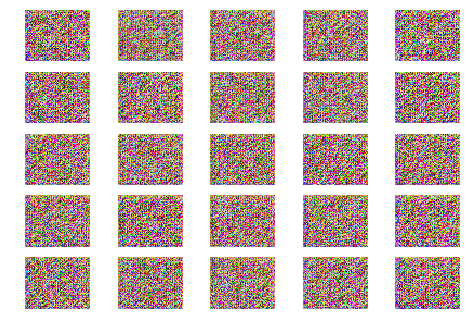

1 [D loss: 0.999911] [G loss: 1.500317]
2 [D loss: 0.999910] [G loss: 1.500318]
3 [D loss: 0.999918] [G loss: 1.500317]
4 [D loss: 0.999915] [G loss: 1.500322]
5 [D loss: 0.999923] [G loss: 1.500322]
6 [D loss: 0.999920] [G loss: 1.500326]
7 [D loss: 0.999920] [G loss: 1.500322]
8 [D loss: 0.999919] [G loss: 1.500309]
9 [D loss: 0.999918] [G loss: 1.500301]
10 [D loss: 0.999924] [G loss: 1.500288]
11 [D loss: 0.999921] [G loss: 1.500264]
12 [D loss: 0.999926] [G loss: 1.500240]
13 [D loss: 0.999928] [G loss: 1.500214]
14 [D loss: 0.999941] [G loss: 1.500191]
15 [D loss: 0.999944] [G loss: 1.500173]
16 [D loss: 0.999946] [G loss: 1.500142]
17 [D loss: 0.999957] [G loss: 1.500114]
18 [D loss: 0.999967] [G loss: 1.500097]
19 [D loss: 0.999982] [G loss: 1.500080]
20 [D loss: 0.999999] [G loss: 1.500059]
21 [D loss: 1.000027] [G loss: 1.500039]
22 [D loss: 1.000077] [G loss: 1.500008]
23 [D loss: 1.000142] [G loss: 1.499986]
24 [D loss: 1.000253] [G loss: 1.499963]
25 [D loss: 1.000419] [G 

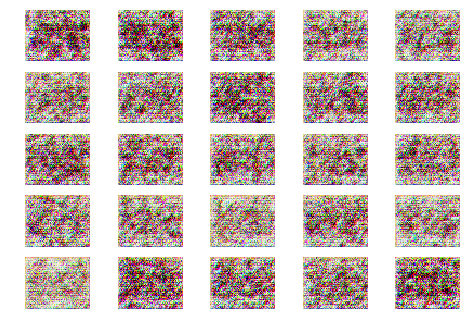

51 [D loss: 1.002920] [G loss: 1.505263]
52 [D loss: 1.003207] [G loss: 1.505270]
53 [D loss: 1.002886] [G loss: 1.506528]
54 [D loss: 1.002581] [G loss: 1.505141]
55 [D loss: 1.003225] [G loss: 1.506669]
56 [D loss: 1.003117] [G loss: 1.505960]
57 [D loss: 1.003531] [G loss: 1.505675]
58 [D loss: 1.003169] [G loss: 1.506321]
59 [D loss: 1.002838] [G loss: 1.506164]
60 [D loss: 1.003127] [G loss: 1.506311]
61 [D loss: 1.003074] [G loss: 1.506904]
62 [D loss: 1.002362] [G loss: 1.506837]
63 [D loss: 1.002205] [G loss: 1.505828]
64 [D loss: 1.002320] [G loss: 1.506059]
65 [D loss: 1.001286] [G loss: 1.506960]
66 [D loss: 1.002620] [G loss: 1.506269]
67 [D loss: 1.003503] [G loss: 1.506106]
68 [D loss: 1.002698] [G loss: 1.505603]
69 [D loss: 1.003041] [G loss: 1.505654]
70 [D loss: 1.003242] [G loss: 1.505231]
71 [D loss: 1.003149] [G loss: 1.504967]
72 [D loss: 1.002670] [G loss: 1.505098]
73 [D loss: 1.003028] [G loss: 1.504338]
74 [D loss: 1.003214] [G loss: 1.504287]
75 [D loss: 1.00

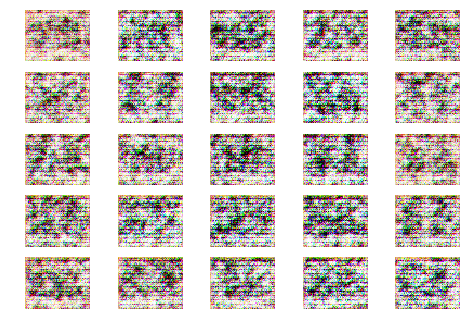

101 [D loss: 1.003999] [G loss: 1.497723]
102 [D loss: 1.003692] [G loss: 1.497963]
103 [D loss: 1.003610] [G loss: 1.498059]
104 [D loss: 1.004188] [G loss: 1.497184]
105 [D loss: 1.005756] [G loss: 1.496741]
106 [D loss: 1.006880] [G loss: 1.496910]
107 [D loss: 1.007422] [G loss: 1.497249]
108 [D loss: 1.007631] [G loss: 1.496543]
109 [D loss: 1.008073] [G loss: 1.496687]
110 [D loss: 1.008548] [G loss: 1.496769]
111 [D loss: 1.008422] [G loss: 1.496042]
112 [D loss: 1.008813] [G loss: 1.496614]
113 [D loss: 1.009051] [G loss: 1.496707]
114 [D loss: 1.009233] [G loss: 1.497342]
115 [D loss: 1.010208] [G loss: 1.497265]
116 [D loss: 1.012870] [G loss: 1.498546]
117 [D loss: 1.009483] [G loss: 1.498384]
118 [D loss: 1.010952] [G loss: 1.498509]
119 [D loss: 1.010176] [G loss: 1.500332]
120 [D loss: 1.012207] [G loss: 1.499278]
121 [D loss: 1.014600] [G loss: 1.499563]
122 [D loss: 1.013775] [G loss: 1.498583]
123 [D loss: 1.012971] [G loss: 1.499212]
124 [D loss: 1.014034] [G loss: 1.

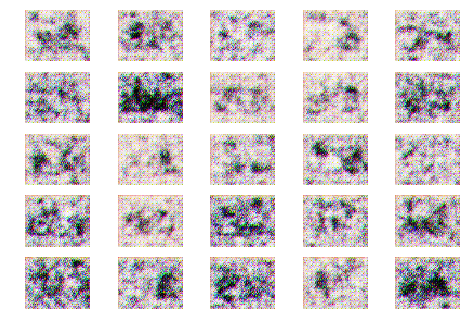

151 [D loss: 1.015646] [G loss: 1.502031]
152 [D loss: 1.014490] [G loss: 1.500088]
153 [D loss: 1.011253] [G loss: 1.501560]
154 [D loss: 1.012787] [G loss: 1.500861]
155 [D loss: 1.012571] [G loss: 1.500273]
156 [D loss: 1.013345] [G loss: 1.500028]
157 [D loss: 1.010542] [G loss: 1.500011]
158 [D loss: 1.015701] [G loss: 1.501213]
159 [D loss: 1.011658] [G loss: 1.500971]
160 [D loss: 1.010172] [G loss: 1.499776]
161 [D loss: 1.011864] [G loss: 1.501740]
162 [D loss: 1.015561] [G loss: 1.500738]
163 [D loss: 1.011539] [G loss: 1.501364]
164 [D loss: 1.012600] [G loss: 1.499251]
165 [D loss: 1.013973] [G loss: 1.500464]
166 [D loss: 1.013621] [G loss: 1.499321]
167 [D loss: 1.011020] [G loss: 1.498340]
168 [D loss: 1.010784] [G loss: 1.497949]
169 [D loss: 1.013034] [G loss: 1.495081]
170 [D loss: 1.008141] [G loss: 1.495815]
171 [D loss: 1.013543] [G loss: 1.495445]
172 [D loss: 1.012715] [G loss: 1.497294]
173 [D loss: 1.010405] [G loss: 1.495114]
174 [D loss: 1.008379] [G loss: 1.

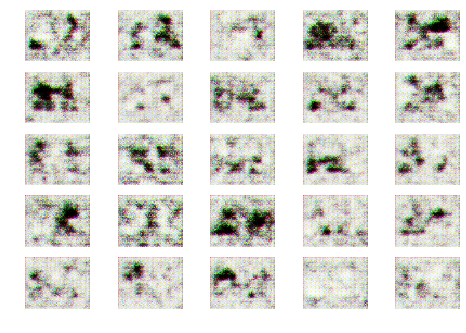

201 [D loss: 1.007016] [G loss: 1.479518]
202 [D loss: 1.008267] [G loss: 1.477468]
203 [D loss: 1.009474] [G loss: 1.479497]
204 [D loss: 1.008132] [G loss: 1.478098]
205 [D loss: 1.007048] [G loss: 1.477329]
206 [D loss: 1.005775] [G loss: 1.475857]
207 [D loss: 1.009606] [G loss: 1.474066]
208 [D loss: 1.006972] [G loss: 1.473489]
209 [D loss: 1.010045] [G loss: 1.474069]
210 [D loss: 1.008915] [G loss: 1.473056]
211 [D loss: 1.008964] [G loss: 1.473037]
212 [D loss: 1.011071] [G loss: 1.473067]
213 [D loss: 1.008982] [G loss: 1.471228]
214 [D loss: 1.010004] [G loss: 1.469693]
215 [D loss: 1.008699] [G loss: 1.469072]
216 [D loss: 1.011961] [G loss: 1.469176]
217 [D loss: 1.010367] [G loss: 1.469966]
218 [D loss: 1.011797] [G loss: 1.468668]
219 [D loss: 1.009658] [G loss: 1.466426]
220 [D loss: 1.012193] [G loss: 1.468203]
221 [D loss: 1.011292] [G loss: 1.465844]
222 [D loss: 1.012986] [G loss: 1.466686]
223 [D loss: 1.012053] [G loss: 1.466179]
224 [D loss: 1.012621] [G loss: 1.

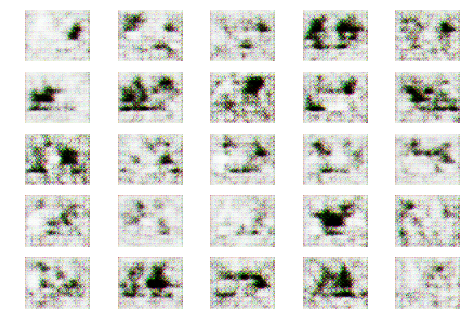

251 [D loss: 1.007152] [G loss: 1.462697]
252 [D loss: 1.009149] [G loss: 1.463331]
253 [D loss: 1.007926] [G loss: 1.464067]
254 [D loss: 1.008855] [G loss: 1.463259]
255 [D loss: 1.008001] [G loss: 1.461658]
256 [D loss: 1.007399] [G loss: 1.461377]
257 [D loss: 1.008236] [G loss: 1.459849]
258 [D loss: 1.007415] [G loss: 1.462203]
259 [D loss: 1.006354] [G loss: 1.462734]
260 [D loss: 1.006244] [G loss: 1.459634]
261 [D loss: 1.006509] [G loss: 1.461208]
262 [D loss: 1.007492] [G loss: 1.461045]
263 [D loss: 1.005419] [G loss: 1.462021]
264 [D loss: 1.005601] [G loss: 1.461091]
265 [D loss: 1.005198] [G loss: 1.461880]
266 [D loss: 1.005593] [G loss: 1.460709]
267 [D loss: 1.006966] [G loss: 1.462025]
268 [D loss: 1.007145] [G loss: 1.461311]
269 [D loss: 1.006904] [G loss: 1.462845]
270 [D loss: 1.006193] [G loss: 1.463203]
271 [D loss: 1.004936] [G loss: 1.464170]
272 [D loss: 1.006274] [G loss: 1.463580]
273 [D loss: 1.004585] [G loss: 1.463085]
274 [D loss: 1.005410] [G loss: 1.

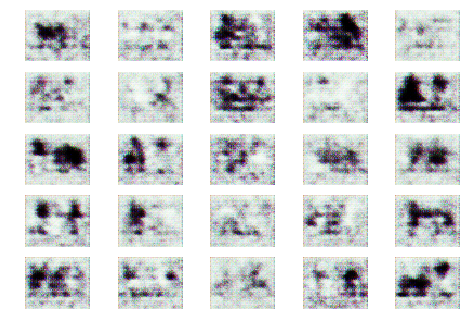

301 [D loss: 1.008628] [G loss: 1.473655]
302 [D loss: 1.007420] [G loss: 1.473099]
303 [D loss: 1.006600] [G loss: 1.470929]
304 [D loss: 1.007569] [G loss: 1.473557]
305 [D loss: 1.007698] [G loss: 1.470725]
306 [D loss: 1.008186] [G loss: 1.470220]
307 [D loss: 1.007636] [G loss: 1.471275]
308 [D loss: 1.008654] [G loss: 1.469134]
309 [D loss: 1.008044] [G loss: 1.470507]
310 [D loss: 1.008444] [G loss: 1.470478]
311 [D loss: 1.009288] [G loss: 1.471273]
312 [D loss: 1.007395] [G loss: 1.471198]
313 [D loss: 1.008451] [G loss: 1.469777]
314 [D loss: 1.009419] [G loss: 1.469248]
315 [D loss: 1.006401] [G loss: 1.470863]
316 [D loss: 1.008941] [G loss: 1.470211]
317 [D loss: 1.007309] [G loss: 1.469432]
318 [D loss: 1.010631] [G loss: 1.468478]
319 [D loss: 1.008317] [G loss: 1.470950]
320 [D loss: 1.007905] [G loss: 1.471230]
321 [D loss: 1.009691] [G loss: 1.469387]
322 [D loss: 1.008615] [G loss: 1.471631]
323 [D loss: 1.010032] [G loss: 1.470291]
324 [D loss: 1.010248] [G loss: 1.

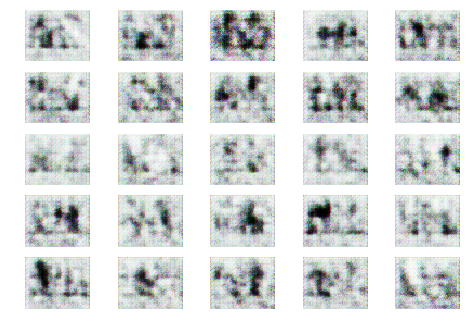

351 [D loss: 1.011137] [G loss: 1.475698]
352 [D loss: 1.011706] [G loss: 1.475814]
353 [D loss: 1.011393] [G loss: 1.475249]
354 [D loss: 1.010974] [G loss: 1.474382]
355 [D loss: 1.010805] [G loss: 1.472225]
356 [D loss: 1.011132] [G loss: 1.473653]
357 [D loss: 1.009153] [G loss: 1.478592]
358 [D loss: 1.011294] [G loss: 1.476545]
359 [D loss: 1.010671] [G loss: 1.472676]
360 [D loss: 1.010123] [G loss: 1.475564]
361 [D loss: 1.012445] [G loss: 1.475956]
362 [D loss: 1.008948] [G loss: 1.475279]
363 [D loss: 1.010817] [G loss: 1.476249]
364 [D loss: 1.010114] [G loss: 1.473265]
365 [D loss: 1.009409] [G loss: 1.475082]
366 [D loss: 1.009105] [G loss: 1.477616]
367 [D loss: 1.009092] [G loss: 1.473433]
368 [D loss: 1.012454] [G loss: 1.474186]
369 [D loss: 1.012720] [G loss: 1.476127]
370 [D loss: 1.008974] [G loss: 1.473640]
371 [D loss: 1.011299] [G loss: 1.473045]
372 [D loss: 1.009784] [G loss: 1.475440]
373 [D loss: 1.009972] [G loss: 1.476757]
374 [D loss: 1.009361] [G loss: 1.

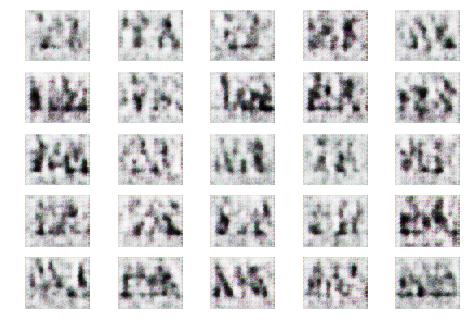

401 [D loss: 1.008737] [G loss: 1.477686]
402 [D loss: 1.005489] [G loss: 1.477104]
403 [D loss: 1.009082] [G loss: 1.479448]
404 [D loss: 1.010655] [G loss: 1.475945]
405 [D loss: 1.010017] [G loss: 1.475584]
406 [D loss: 1.009219] [G loss: 1.473778]
407 [D loss: 1.010803] [G loss: 1.471516]
408 [D loss: 1.010811] [G loss: 1.474480]
409 [D loss: 1.010393] [G loss: 1.476170]
410 [D loss: 1.012277] [G loss: 1.475435]
411 [D loss: 1.010332] [G loss: 1.475339]
412 [D loss: 1.009050] [G loss: 1.474238]
413 [D loss: 1.008608] [G loss: 1.471692]
414 [D loss: 1.012431] [G loss: 1.477142]
415 [D loss: 1.010064] [G loss: 1.473112]
416 [D loss: 1.011520] [G loss: 1.474155]
417 [D loss: 1.012807] [G loss: 1.476543]
418 [D loss: 1.012345] [G loss: 1.475254]
419 [D loss: 1.009437] [G loss: 1.474420]
420 [D loss: 1.010329] [G loss: 1.472768]
421 [D loss: 1.011226] [G loss: 1.475618]
422 [D loss: 1.011263] [G loss: 1.475491]
423 [D loss: 1.011441] [G loss: 1.474532]
424 [D loss: 1.011631] [G loss: 1.

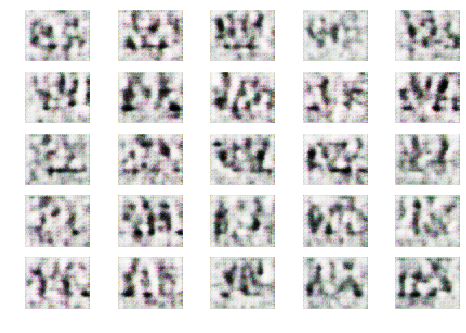

451 [D loss: 1.012428] [G loss: 1.475343]
452 [D loss: 1.010992] [G loss: 1.473252]
453 [D loss: 1.012195] [G loss: 1.477159]
454 [D loss: 1.009411] [G loss: 1.474090]
455 [D loss: 1.012212] [G loss: 1.474528]
456 [D loss: 1.011878] [G loss: 1.473786]
457 [D loss: 1.011028] [G loss: 1.476285]
458 [D loss: 1.010957] [G loss: 1.474503]
459 [D loss: 1.010168] [G loss: 1.473204]
460 [D loss: 1.011693] [G loss: 1.474969]
461 [D loss: 1.010991] [G loss: 1.474459]
462 [D loss: 1.011089] [G loss: 1.476806]
463 [D loss: 1.009564] [G loss: 1.475595]
464 [D loss: 1.011089] [G loss: 1.476038]
465 [D loss: 1.010417] [G loss: 1.476965]
466 [D loss: 1.011828] [G loss: 1.476926]
467 [D loss: 1.009176] [G loss: 1.474767]
468 [D loss: 1.012807] [G loss: 1.474392]
469 [D loss: 1.009664] [G loss: 1.474782]
470 [D loss: 1.011105] [G loss: 1.472119]
471 [D loss: 1.010634] [G loss: 1.473957]
472 [D loss: 1.006488] [G loss: 1.477525]
473 [D loss: 1.013517] [G loss: 1.477788]
474 [D loss: 1.010505] [G loss: 1.

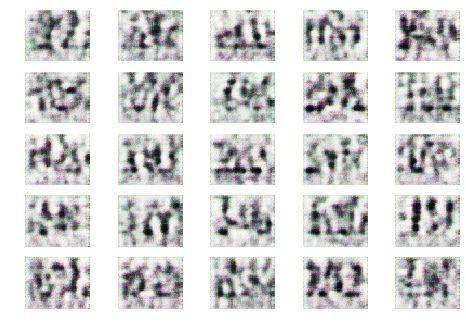

501 [D loss: 1.013627] [G loss: 1.468778]
502 [D loss: 1.011774] [G loss: 1.471088]
503 [D loss: 1.011641] [G loss: 1.467198]
504 [D loss: 1.011918] [G loss: 1.469586]
505 [D loss: 1.012803] [G loss: 1.468382]
506 [D loss: 1.011843] [G loss: 1.470015]
507 [D loss: 1.012868] [G loss: 1.468506]
508 [D loss: 1.014105] [G loss: 1.470694]
509 [D loss: 1.013551] [G loss: 1.469842]
510 [D loss: 1.014653] [G loss: 1.468230]
511 [D loss: 1.011760] [G loss: 1.465860]
512 [D loss: 1.013424] [G loss: 1.468100]
513 [D loss: 1.010661] [G loss: 1.469357]
514 [D loss: 1.012950] [G loss: 1.466967]
515 [D loss: 1.012742] [G loss: 1.464949]
516 [D loss: 1.010337] [G loss: 1.462830]
517 [D loss: 1.012610] [G loss: 1.462478]
518 [D loss: 1.013708] [G loss: 1.465199]
519 [D loss: 1.013785] [G loss: 1.468756]
520 [D loss: 1.013212] [G loss: 1.470770]
521 [D loss: 1.009707] [G loss: 1.471126]
522 [D loss: 1.011848] [G loss: 1.470319]
523 [D loss: 1.013692] [G loss: 1.467756]
524 [D loss: 1.011329] [G loss: 1.

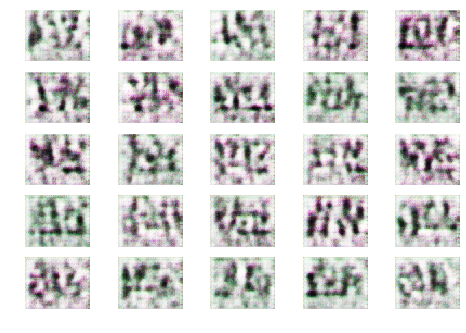

551 [D loss: 1.012828] [G loss: 1.469478]
552 [D loss: 1.013160] [G loss: 1.465066]
553 [D loss: 1.012989] [G loss: 1.465619]
554 [D loss: 1.014667] [G loss: 1.466932]
555 [D loss: 1.014545] [G loss: 1.470655]
556 [D loss: 1.014144] [G loss: 1.474274]
557 [D loss: 1.013169] [G loss: 1.468951]
558 [D loss: 1.014857] [G loss: 1.467963]
559 [D loss: 1.009719] [G loss: 1.470932]
560 [D loss: 1.012484] [G loss: 1.475106]
561 [D loss: 1.010247] [G loss: 1.472413]
562 [D loss: 1.009832] [G loss: 1.475489]
563 [D loss: 1.009501] [G loss: 1.470230]
564 [D loss: 1.011635] [G loss: 1.471061]
565 [D loss: 1.014523] [G loss: 1.467654]
566 [D loss: 1.011360] [G loss: 1.474155]
567 [D loss: 1.010074] [G loss: 1.472562]
568 [D loss: 1.011455] [G loss: 1.466902]
569 [D loss: 1.011711] [G loss: 1.468615]
570 [D loss: 1.010803] [G loss: 1.466885]
571 [D loss: 1.011311] [G loss: 1.468097]
572 [D loss: 1.012881] [G loss: 1.466569]
573 [D loss: 1.010561] [G loss: 1.468169]
574 [D loss: 1.012256] [G loss: 1.

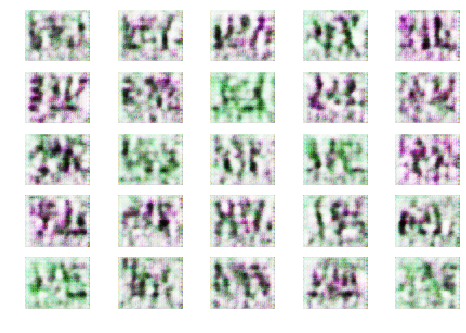

601 [D loss: 1.013000] [G loss: 1.469174]
602 [D loss: 1.013030] [G loss: 1.469385]
603 [D loss: 1.012319] [G loss: 1.470249]
604 [D loss: 1.012743] [G loss: 1.468608]
605 [D loss: 1.013721] [G loss: 1.466074]
606 [D loss: 1.009678] [G loss: 1.465677]
607 [D loss: 1.011010] [G loss: 1.465855]
608 [D loss: 1.010292] [G loss: 1.468052]
609 [D loss: 1.010818] [G loss: 1.466254]
610 [D loss: 1.009881] [G loss: 1.463973]
611 [D loss: 1.012766] [G loss: 1.464272]
612 [D loss: 1.012385] [G loss: 1.462688]
613 [D loss: 1.011281] [G loss: 1.461973]
614 [D loss: 1.011812] [G loss: 1.460096]
615 [D loss: 1.014959] [G loss: 1.458723]
616 [D loss: 1.010417] [G loss: 1.460502]
617 [D loss: 1.013249] [G loss: 1.460858]
618 [D loss: 1.013870] [G loss: 1.461846]
619 [D loss: 1.013745] [G loss: 1.458488]
620 [D loss: 1.012877] [G loss: 1.462665]
621 [D loss: 1.011181] [G loss: 1.457982]
622 [D loss: 1.013058] [G loss: 1.458440]
623 [D loss: 1.014544] [G loss: 1.457656]
624 [D loss: 1.012010] [G loss: 1.

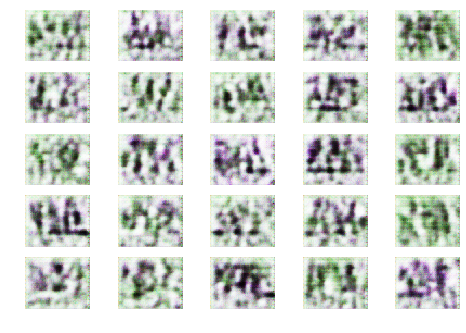

651 [D loss: 1.013123] [G loss: 1.460747]
652 [D loss: 1.013808] [G loss: 1.460372]
653 [D loss: 1.014429] [G loss: 1.462729]
654 [D loss: 1.014558] [G loss: 1.460487]
655 [D loss: 1.014809] [G loss: 1.462053]
656 [D loss: 1.010731] [G loss: 1.461031]
657 [D loss: 1.012514] [G loss: 1.462878]
658 [D loss: 1.012843] [G loss: 1.462328]
659 [D loss: 1.016306] [G loss: 1.462314]
660 [D loss: 1.013437] [G loss: 1.459085]
661 [D loss: 1.013859] [G loss: 1.461964]
662 [D loss: 1.011413] [G loss: 1.461794]
663 [D loss: 1.011546] [G loss: 1.461178]
664 [D loss: 1.014035] [G loss: 1.464352]
665 [D loss: 1.014024] [G loss: 1.460053]
666 [D loss: 1.017260] [G loss: 1.461793]
667 [D loss: 1.014929] [G loss: 1.460347]
668 [D loss: 1.014976] [G loss: 1.459318]
669 [D loss: 1.016992] [G loss: 1.461825]
670 [D loss: 1.016569] [G loss: 1.463380]
671 [D loss: 1.014160] [G loss: 1.464617]
672 [D loss: 1.014554] [G loss: 1.467813]
673 [D loss: 1.012913] [G loss: 1.463154]
674 [D loss: 1.012853] [G loss: 1.

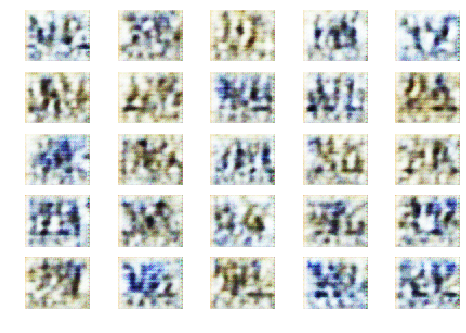

701 [D loss: 1.010891] [G loss: 1.473933]
702 [D loss: 1.008363] [G loss: 1.470879]
703 [D loss: 1.008685] [G loss: 1.468043]
704 [D loss: 1.008242] [G loss: 1.473142]
705 [D loss: 1.010290] [G loss: 1.472089]
706 [D loss: 1.006985] [G loss: 1.472464]
707 [D loss: 1.009469] [G loss: 1.472713]
708 [D loss: 1.008123] [G loss: 1.471326]
709 [D loss: 1.006992] [G loss: 1.476686]
710 [D loss: 1.010004] [G loss: 1.471881]
711 [D loss: 1.007629] [G loss: 1.472718]
712 [D loss: 1.010890] [G loss: 1.477366]
713 [D loss: 1.007843] [G loss: 1.473320]
714 [D loss: 1.008838] [G loss: 1.469977]
715 [D loss: 1.011401] [G loss: 1.474973]
716 [D loss: 1.010164] [G loss: 1.470586]
717 [D loss: 1.009231] [G loss: 1.474961]
718 [D loss: 1.009682] [G loss: 1.477510]
719 [D loss: 1.009324] [G loss: 1.476947]
720 [D loss: 1.009750] [G loss: 1.473289]
721 [D loss: 1.010365] [G loss: 1.473062]
722 [D loss: 1.008829] [G loss: 1.472395]
723 [D loss: 1.010632] [G loss: 1.472077]
724 [D loss: 1.010765] [G loss: 1.

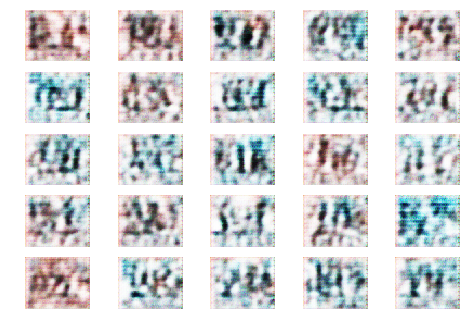

751 [D loss: 1.009875] [G loss: 1.460659]
752 [D loss: 1.009481] [G loss: 1.463773]
753 [D loss: 1.008857] [G loss: 1.466294]
754 [D loss: 1.014514] [G loss: 1.465751]
755 [D loss: 1.009897] [G loss: 1.463809]
756 [D loss: 1.011411] [G loss: 1.459623]
757 [D loss: 1.011232] [G loss: 1.456140]
758 [D loss: 1.010495] [G loss: 1.460974]
759 [D loss: 1.011227] [G loss: 1.460168]
760 [D loss: 1.009460] [G loss: 1.461661]
761 [D loss: 1.014707] [G loss: 1.463701]
762 [D loss: 1.008467] [G loss: 1.460913]
763 [D loss: 1.013737] [G loss: 1.460567]
764 [D loss: 1.011287] [G loss: 1.459669]
765 [D loss: 1.010713] [G loss: 1.460786]
766 [D loss: 1.010736] [G loss: 1.462349]
767 [D loss: 1.009831] [G loss: 1.464949]
768 [D loss: 1.013659] [G loss: 1.466387]
769 [D loss: 1.010788] [G loss: 1.468534]
770 [D loss: 1.015018] [G loss: 1.466088]
771 [D loss: 1.008996] [G loss: 1.462075]
772 [D loss: 1.011491] [G loss: 1.462406]
773 [D loss: 1.010369] [G loss: 1.465823]
774 [D loss: 1.010440] [G loss: 1.

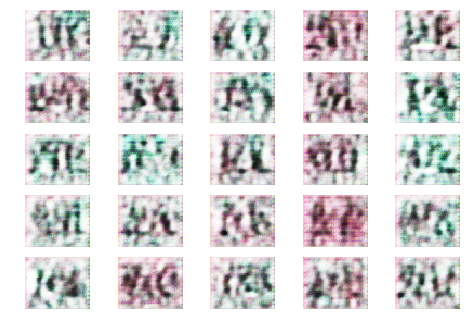

801 [D loss: 1.011016] [G loss: 1.467313]
802 [D loss: 1.012277] [G loss: 1.470877]
803 [D loss: 1.013775] [G loss: 1.472515]
804 [D loss: 1.012653] [G loss: 1.469401]
805 [D loss: 1.013378] [G loss: 1.469338]
806 [D loss: 1.012632] [G loss: 1.465479]
807 [D loss: 1.012744] [G loss: 1.465525]
808 [D loss: 1.013735] [G loss: 1.468020]
809 [D loss: 1.011185] [G loss: 1.466193]
810 [D loss: 1.012786] [G loss: 1.466718]
811 [D loss: 1.009837] [G loss: 1.468523]
812 [D loss: 1.011409] [G loss: 1.473574]
813 [D loss: 1.010250] [G loss: 1.468561]
814 [D loss: 1.010954] [G loss: 1.468465]
815 [D loss: 1.010025] [G loss: 1.469568]
816 [D loss: 1.008389] [G loss: 1.470323]
817 [D loss: 1.013706] [G loss: 1.468463]
818 [D loss: 1.010995] [G loss: 1.465301]
819 [D loss: 1.009382] [G loss: 1.465616]
820 [D loss: 1.011908] [G loss: 1.469201]
821 [D loss: 1.010725] [G loss: 1.470157]
822 [D loss: 1.009674] [G loss: 1.470496]
823 [D loss: 1.011144] [G loss: 1.472270]
824 [D loss: 1.010996] [G loss: 1.

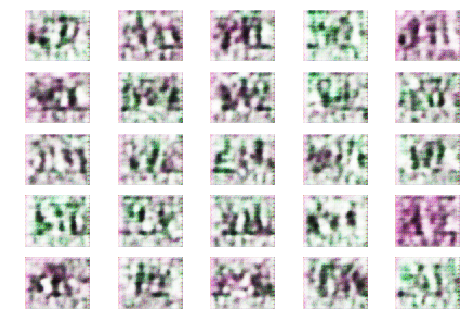

851 [D loss: 1.012352] [G loss: 1.469237]
852 [D loss: 1.011741] [G loss: 1.465725]
853 [D loss: 1.012072] [G loss: 1.472806]
854 [D loss: 1.013795] [G loss: 1.471187]
855 [D loss: 1.013447] [G loss: 1.467613]
856 [D loss: 1.012431] [G loss: 1.470156]
857 [D loss: 1.013064] [G loss: 1.468947]
858 [D loss: 1.013119] [G loss: 1.469306]
859 [D loss: 1.013582] [G loss: 1.471936]
860 [D loss: 1.015515] [G loss: 1.473559]
861 [D loss: 1.014140] [G loss: 1.473302]
862 [D loss: 1.010859] [G loss: 1.470526]
863 [D loss: 1.010404] [G loss: 1.471202]
864 [D loss: 1.012444] [G loss: 1.465842]
865 [D loss: 1.014131] [G loss: 1.467358]
866 [D loss: 1.011614] [G loss: 1.465291]
867 [D loss: 1.014201] [G loss: 1.466818]
868 [D loss: 1.014625] [G loss: 1.465130]
869 [D loss: 1.010150] [G loss: 1.465319]
870 [D loss: 1.013448] [G loss: 1.470033]
871 [D loss: 1.013862] [G loss: 1.464046]
872 [D loss: 1.010849] [G loss: 1.466994]
873 [D loss: 1.013563] [G loss: 1.468643]
874 [D loss: 1.016211] [G loss: 1.

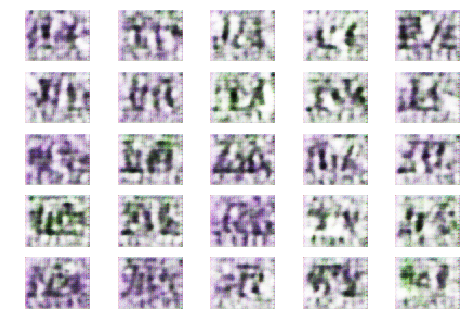

901 [D loss: 1.012789] [G loss: 1.471221]
902 [D loss: 1.015985] [G loss: 1.469778]
903 [D loss: 1.014883] [G loss: 1.465744]
904 [D loss: 1.016916] [G loss: 1.464527]
905 [D loss: 1.013637] [G loss: 1.467375]
906 [D loss: 1.015671] [G loss: 1.459398]
907 [D loss: 1.013924] [G loss: 1.465409]
908 [D loss: 1.013753] [G loss: 1.463641]
909 [D loss: 1.010527] [G loss: 1.464451]
910 [D loss: 1.013013] [G loss: 1.463060]
911 [D loss: 1.018801] [G loss: 1.468016]
912 [D loss: 1.013613] [G loss: 1.466793]
913 [D loss: 1.009711] [G loss: 1.465131]
914 [D loss: 1.011500] [G loss: 1.468856]
915 [D loss: 1.016119] [G loss: 1.468761]
916 [D loss: 1.013230] [G loss: 1.465243]
917 [D loss: 1.015172] [G loss: 1.466274]
918 [D loss: 1.015864] [G loss: 1.465817]
919 [D loss: 1.012645] [G loss: 1.464273]
920 [D loss: 1.011447] [G loss: 1.468164]
921 [D loss: 1.012988] [G loss: 1.467301]
922 [D loss: 1.013541] [G loss: 1.473663]
923 [D loss: 1.013219] [G loss: 1.467273]
924 [D loss: 1.011711] [G loss: 1.

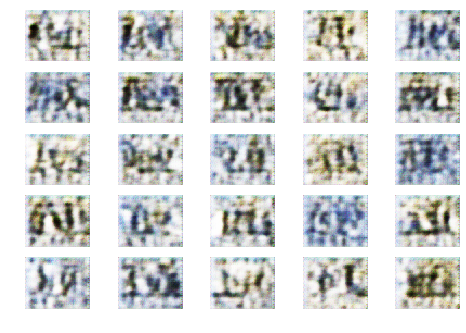

951 [D loss: 1.013456] [G loss: 1.464854]
952 [D loss: 1.011603] [G loss: 1.467744]
953 [D loss: 1.010876] [G loss: 1.467830]
954 [D loss: 1.011340] [G loss: 1.470413]
955 [D loss: 1.009260] [G loss: 1.467416]
956 [D loss: 1.008550] [G loss: 1.469592]
957 [D loss: 1.004962] [G loss: 1.468380]
958 [D loss: 1.012148] [G loss: 1.471415]
959 [D loss: 1.009974] [G loss: 1.465195]
960 [D loss: 1.010905] [G loss: 1.468319]
961 [D loss: 1.012715] [G loss: 1.468409]
962 [D loss: 1.010424] [G loss: 1.463500]
963 [D loss: 1.010652] [G loss: 1.461998]
964 [D loss: 1.010713] [G loss: 1.467889]
965 [D loss: 1.012297] [G loss: 1.468625]
966 [D loss: 1.011413] [G loss: 1.466398]
967 [D loss: 1.012288] [G loss: 1.468548]
968 [D loss: 1.010291] [G loss: 1.467163]
969 [D loss: 1.013499] [G loss: 1.468442]
970 [D loss: 1.009888] [G loss: 1.468037]
971 [D loss: 1.011249] [G loss: 1.464772]
972 [D loss: 1.012331] [G loss: 1.465224]
973 [D loss: 1.012624] [G loss: 1.463857]
974 [D loss: 1.009353] [G loss: 1.

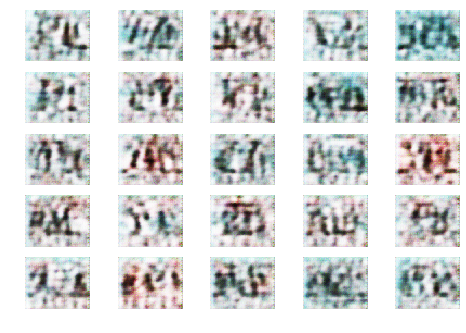

1001 [D loss: 1.011327] [G loss: 1.464479]
1002 [D loss: 1.009698] [G loss: 1.460032]
1003 [D loss: 1.010255] [G loss: 1.462184]
1004 [D loss: 1.010411] [G loss: 1.459485]
1005 [D loss: 1.012650] [G loss: 1.460943]
1006 [D loss: 1.009752] [G loss: 1.460197]
1007 [D loss: 1.012524] [G loss: 1.460107]
1008 [D loss: 1.010689] [G loss: 1.462219]
1009 [D loss: 1.012011] [G loss: 1.461375]
1010 [D loss: 1.013377] [G loss: 1.463380]
1011 [D loss: 1.012384] [G loss: 1.464912]
1012 [D loss: 1.008939] [G loss: 1.465712]
1013 [D loss: 1.014602] [G loss: 1.464626]
1014 [D loss: 1.009165] [G loss: 1.465583]
1015 [D loss: 1.013252] [G loss: 1.466425]
1016 [D loss: 1.012112] [G loss: 1.463939]
1017 [D loss: 1.010205] [G loss: 1.467358]
1018 [D loss: 1.014053] [G loss: 1.467150]
1019 [D loss: 1.009542] [G loss: 1.464818]
1020 [D loss: 1.011957] [G loss: 1.463990]
1021 [D loss: 1.012421] [G loss: 1.464338]
1022 [D loss: 1.011283] [G loss: 1.468670]
1023 [D loss: 1.011385] [G loss: 1.467264]
1024 [D los

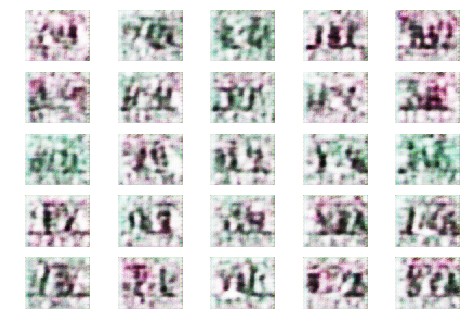

1051 [D loss: 1.009832] [G loss: 1.469942]
1052 [D loss: 1.014555] [G loss: 1.467575]
1053 [D loss: 1.010556] [G loss: 1.469758]
1054 [D loss: 1.013638] [G loss: 1.464722]
1055 [D loss: 1.010915] [G loss: 1.465251]
1056 [D loss: 1.010805] [G loss: 1.464495]
1057 [D loss: 1.011528] [G loss: 1.469872]
1058 [D loss: 1.014473] [G loss: 1.470894]
1059 [D loss: 1.012623] [G loss: 1.471899]
1060 [D loss: 1.011390] [G loss: 1.467995]
1061 [D loss: 1.012737] [G loss: 1.468393]
1062 [D loss: 1.009829] [G loss: 1.469768]
1063 [D loss: 1.012535] [G loss: 1.463689]
1064 [D loss: 1.011079] [G loss: 1.463560]
1065 [D loss: 1.010289] [G loss: 1.468453]
1066 [D loss: 1.010350] [G loss: 1.464850]
1067 [D loss: 1.012320] [G loss: 1.462714]
1068 [D loss: 1.011084] [G loss: 1.470132]
1069 [D loss: 1.012747] [G loss: 1.474501]
1070 [D loss: 1.011585] [G loss: 1.474248]
1071 [D loss: 1.012740] [G loss: 1.473122]
1072 [D loss: 1.012245] [G loss: 1.473372]
1073 [D loss: 1.010344] [G loss: 1.472530]
1074 [D los

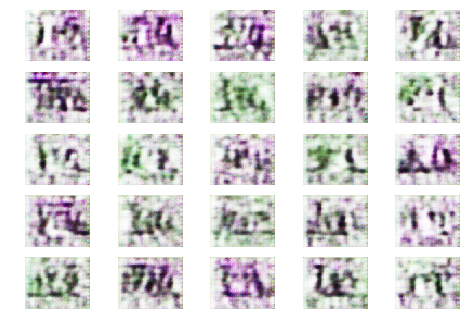

1101 [D loss: 1.013178] [G loss: 1.462023]
1102 [D loss: 1.015812] [G loss: 1.468224]
1103 [D loss: 1.014972] [G loss: 1.460750]
1104 [D loss: 1.011168] [G loss: 1.461058]
1105 [D loss: 1.013172] [G loss: 1.465713]
1106 [D loss: 1.013092] [G loss: 1.462888]
1107 [D loss: 1.013089] [G loss: 1.467096]
1108 [D loss: 1.012511] [G loss: 1.468130]
1109 [D loss: 1.012537] [G loss: 1.464316]
1110 [D loss: 1.012333] [G loss: 1.464200]
1111 [D loss: 1.009252] [G loss: 1.466514]
1112 [D loss: 1.012758] [G loss: 1.462327]
1113 [D loss: 1.012145] [G loss: 1.464032]
1114 [D loss: 1.012951] [G loss: 1.464823]
1115 [D loss: 1.010825] [G loss: 1.465310]
1116 [D loss: 1.011338] [G loss: 1.465152]
1117 [D loss: 1.013300] [G loss: 1.461104]
1118 [D loss: 1.009434] [G loss: 1.464531]
1119 [D loss: 1.009615] [G loss: 1.468371]
1120 [D loss: 1.014353] [G loss: 1.469903]
1121 [D loss: 1.013706] [G loss: 1.464758]
1122 [D loss: 1.014070] [G loss: 1.465897]
1123 [D loss: 1.011646] [G loss: 1.464278]
1124 [D los

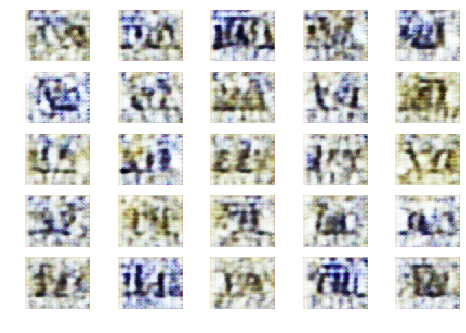

1151 [D loss: 1.010202] [G loss: 1.463830]
1152 [D loss: 1.009024] [G loss: 1.466778]
1153 [D loss: 1.011683] [G loss: 1.466098]
1154 [D loss: 1.008109] [G loss: 1.468239]
1155 [D loss: 1.011166] [G loss: 1.467545]
1156 [D loss: 1.010160] [G loss: 1.468123]
1157 [D loss: 1.012602] [G loss: 1.469229]
1158 [D loss: 1.010264] [G loss: 1.469147]
1159 [D loss: 1.010509] [G loss: 1.473253]
1160 [D loss: 1.015105] [G loss: 1.474567]
1161 [D loss: 1.011711] [G loss: 1.471801]
1162 [D loss: 1.008663] [G loss: 1.471568]
1163 [D loss: 1.010698] [G loss: 1.472698]
1164 [D loss: 1.012157] [G loss: 1.469702]
1165 [D loss: 1.010647] [G loss: 1.472695]
1166 [D loss: 1.010066] [G loss: 1.466929]
1167 [D loss: 1.009514] [G loss: 1.465549]
1168 [D loss: 1.012000] [G loss: 1.467112]
1169 [D loss: 1.011778] [G loss: 1.465168]
1170 [D loss: 1.012738] [G loss: 1.460967]
1171 [D loss: 1.010273] [G loss: 1.461207]
1172 [D loss: 1.014350] [G loss: 1.460406]
1173 [D loss: 1.010398] [G loss: 1.467102]
1174 [D los

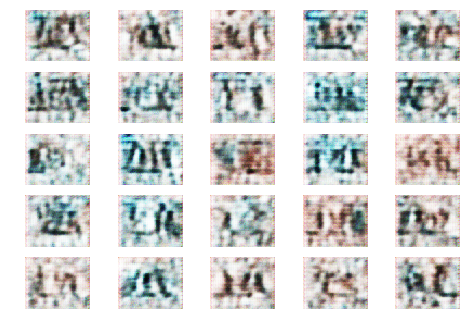

1201 [D loss: 1.009951] [G loss: 1.459472]
1202 [D loss: 1.012114] [G loss: 1.461978]
1203 [D loss: 1.012430] [G loss: 1.459070]
1204 [D loss: 1.013584] [G loss: 1.460617]
1205 [D loss: 1.014107] [G loss: 1.465005]
1206 [D loss: 1.009629] [G loss: 1.460319]
1207 [D loss: 1.013681] [G loss: 1.463197]
1208 [D loss: 1.013738] [G loss: 1.466242]
1209 [D loss: 1.011921] [G loss: 1.467127]
1210 [D loss: 1.009874] [G loss: 1.461185]
1211 [D loss: 1.009289] [G loss: 1.462436]
1212 [D loss: 1.009290] [G loss: 1.461580]
1213 [D loss: 1.011013] [G loss: 1.464760]
1214 [D loss: 1.008324] [G loss: 1.462578]
1215 [D loss: 1.012373] [G loss: 1.465626]
1216 [D loss: 1.011721] [G loss: 1.461620]
1217 [D loss: 1.009430] [G loss: 1.460356]
1218 [D loss: 1.008872] [G loss: 1.464645]
1219 [D loss: 1.010548] [G loss: 1.462962]
1220 [D loss: 1.011373] [G loss: 1.471027]
1221 [D loss: 1.009508] [G loss: 1.461564]
1222 [D loss: 1.011347] [G loss: 1.465427]
1223 [D loss: 1.008645] [G loss: 1.463239]
1224 [D los

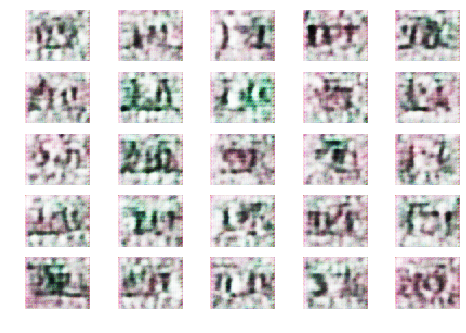

1251 [D loss: 1.010700] [G loss: 1.467381]
1252 [D loss: 1.010302] [G loss: 1.469600]
1253 [D loss: 1.009324] [G loss: 1.468815]
1254 [D loss: 1.010355] [G loss: 1.464293]
1255 [D loss: 1.009845] [G loss: 1.467792]
1256 [D loss: 1.013172] [G loss: 1.475046]
1257 [D loss: 1.011615] [G loss: 1.466920]
1258 [D loss: 1.007633] [G loss: 1.470790]
1259 [D loss: 1.013180] [G loss: 1.466529]
1260 [D loss: 1.011332] [G loss: 1.468043]
1261 [D loss: 1.011026] [G loss: 1.469631]
1262 [D loss: 1.011391] [G loss: 1.468267]
1263 [D loss: 1.012344] [G loss: 1.467418]
1264 [D loss: 1.009018] [G loss: 1.468983]
1265 [D loss: 1.008485] [G loss: 1.470146]
1266 [D loss: 1.010730] [G loss: 1.469253]
1267 [D loss: 1.012503] [G loss: 1.472285]
1268 [D loss: 1.013635] [G loss: 1.472034]
1269 [D loss: 1.010588] [G loss: 1.470763]
1270 [D loss: 1.012836] [G loss: 1.472845]
1271 [D loss: 1.010401] [G loss: 1.474791]
1272 [D loss: 1.010915] [G loss: 1.470392]
1273 [D loss: 1.012986] [G loss: 1.472959]
1274 [D los

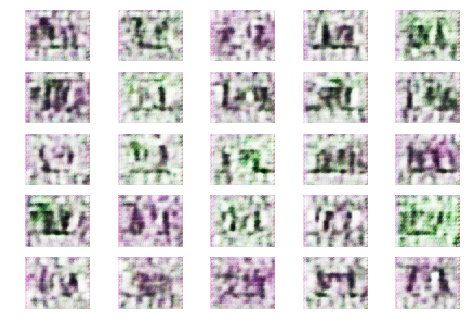

1301 [D loss: 1.012335] [G loss: 1.474833]
1302 [D loss: 1.010259] [G loss: 1.467637]
1303 [D loss: 1.010075] [G loss: 1.470281]
1304 [D loss: 1.010202] [G loss: 1.466972]
1305 [D loss: 1.012499] [G loss: 1.468461]
1306 [D loss: 1.012515] [G loss: 1.472076]
1307 [D loss: 1.011925] [G loss: 1.470534]
1308 [D loss: 1.013159] [G loss: 1.472272]
1309 [D loss: 1.009767] [G loss: 1.469278]
1310 [D loss: 1.014518] [G loss: 1.472652]
1311 [D loss: 1.011964] [G loss: 1.474575]
1312 [D loss: 1.010971] [G loss: 1.466716]
1313 [D loss: 1.013605] [G loss: 1.472226]
1314 [D loss: 1.016865] [G loss: 1.471354]
1315 [D loss: 1.009890] [G loss: 1.467129]
1316 [D loss: 1.009932] [G loss: 1.473831]
1317 [D loss: 1.013156] [G loss: 1.470852]
1318 [D loss: 1.009181] [G loss: 1.473553]
1319 [D loss: 1.011099] [G loss: 1.469234]
1320 [D loss: 1.011364] [G loss: 1.478531]
1321 [D loss: 1.011008] [G loss: 1.475625]
1322 [D loss: 1.013132] [G loss: 1.475764]
1323 [D loss: 1.011305] [G loss: 1.473493]
1324 [D los

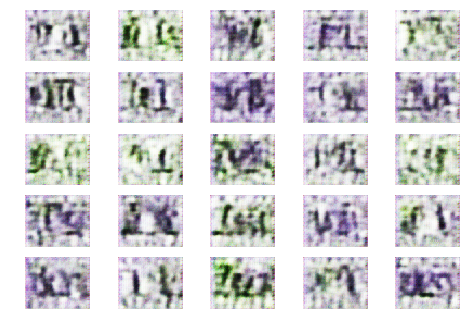

1351 [D loss: 1.012783] [G loss: 1.468914]
1352 [D loss: 1.011643] [G loss: 1.467078]
1353 [D loss: 1.009804] [G loss: 1.469049]
1354 [D loss: 1.014625] [G loss: 1.464207]
1355 [D loss: 1.015043] [G loss: 1.468082]
1356 [D loss: 1.014737] [G loss: 1.463025]
1357 [D loss: 1.010594] [G loss: 1.466024]
1358 [D loss: 1.013193] [G loss: 1.471847]
1359 [D loss: 1.012614] [G loss: 1.468684]
1360 [D loss: 1.012255] [G loss: 1.469284]
1361 [D loss: 1.010492] [G loss: 1.469905]
1362 [D loss: 1.011779] [G loss: 1.466919]
1363 [D loss: 1.013152] [G loss: 1.468447]
1364 [D loss: 1.014356] [G loss: 1.467591]
1365 [D loss: 1.013812] [G loss: 1.468237]
1366 [D loss: 1.013806] [G loss: 1.470111]
1367 [D loss: 1.014060] [G loss: 1.472243]
1368 [D loss: 1.009927] [G loss: 1.470806]
1369 [D loss: 1.014407] [G loss: 1.473141]
1370 [D loss: 1.014406] [G loss: 1.473467]
1371 [D loss: 1.012648] [G loss: 1.472606]
1372 [D loss: 1.014330] [G loss: 1.470907]
1373 [D loss: 1.014777] [G loss: 1.470284]
1374 [D los

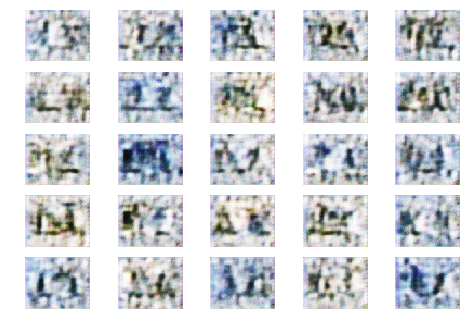

1401 [D loss: 1.011831] [G loss: 1.466680]
1402 [D loss: 1.012858] [G loss: 1.469179]
1403 [D loss: 1.011507] [G loss: 1.466911]
1404 [D loss: 1.010888] [G loss: 1.464024]
1405 [D loss: 1.009894] [G loss: 1.467914]
1406 [D loss: 1.008809] [G loss: 1.471138]
1407 [D loss: 1.007410] [G loss: 1.475050]
1408 [D loss: 1.009322] [G loss: 1.473761]
1409 [D loss: 1.010064] [G loss: 1.474841]
1410 [D loss: 1.009953] [G loss: 1.476861]
1411 [D loss: 1.014038] [G loss: 1.464252]
1412 [D loss: 1.012936] [G loss: 1.474819]
1413 [D loss: 1.009089] [G loss: 1.476696]
1414 [D loss: 1.009302] [G loss: 1.475532]
1415 [D loss: 1.013150] [G loss: 1.473534]
1416 [D loss: 1.007338] [G loss: 1.479541]
1417 [D loss: 1.008004] [G loss: 1.475563]
1418 [D loss: 1.011233] [G loss: 1.475788]
1419 [D loss: 1.010857] [G loss: 1.473390]
1420 [D loss: 1.006987] [G loss: 1.478335]
1421 [D loss: 1.011862] [G loss: 1.470858]
1422 [D loss: 1.010036] [G loss: 1.473816]
1423 [D loss: 1.010479] [G loss: 1.467928]
1424 [D los

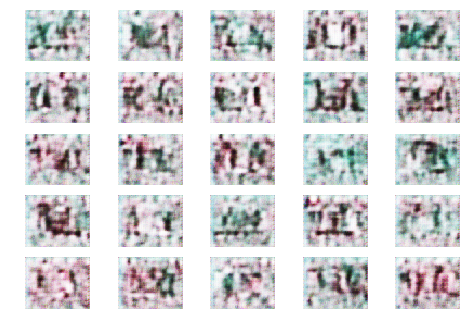

1451 [D loss: 1.013993] [G loss: 1.464858]
1452 [D loss: 1.009197] [G loss: 1.462105]
1453 [D loss: 1.008213] [G loss: 1.458874]
1454 [D loss: 1.009734] [G loss: 1.459492]
1455 [D loss: 1.012639] [G loss: 1.462354]
1456 [D loss: 1.009459] [G loss: 1.461955]
1457 [D loss: 1.010958] [G loss: 1.459848]
1458 [D loss: 1.014560] [G loss: 1.463288]
1459 [D loss: 1.013312] [G loss: 1.463213]
1460 [D loss: 1.009821] [G loss: 1.460002]
1461 [D loss: 1.012732] [G loss: 1.462074]
1462 [D loss: 1.014573] [G loss: 1.461020]
1463 [D loss: 1.010017] [G loss: 1.464856]
1464 [D loss: 1.011825] [G loss: 1.460729]
1465 [D loss: 1.013241] [G loss: 1.458680]
1466 [D loss: 1.012568] [G loss: 1.461636]
1467 [D loss: 1.010059] [G loss: 1.464447]
1468 [D loss: 1.011327] [G loss: 1.455197]
1469 [D loss: 1.010913] [G loss: 1.461620]
1470 [D loss: 1.013898] [G loss: 1.465198]
1471 [D loss: 1.011467] [G loss: 1.458264]
1472 [D loss: 1.008453] [G loss: 1.459970]
1473 [D loss: 1.014158] [G loss: 1.463680]
1474 [D los

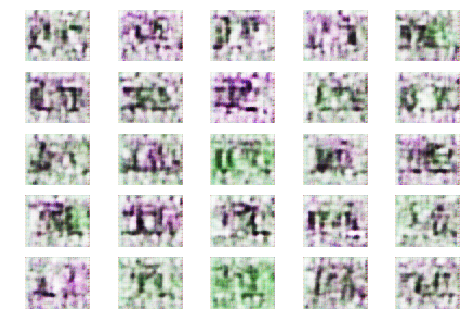

1501 [D loss: 1.011260] [G loss: 1.465294]
1502 [D loss: 1.009195] [G loss: 1.464278]
1503 [D loss: 1.008728] [G loss: 1.469764]
1504 [D loss: 1.008545] [G loss: 1.467826]
1505 [D loss: 1.009345] [G loss: 1.472619]
1506 [D loss: 1.009283] [G loss: 1.465318]
1507 [D loss: 1.005119] [G loss: 1.470179]
1508 [D loss: 1.007442] [G loss: 1.471417]
1509 [D loss: 1.009902] [G loss: 1.467797]
1510 [D loss: 1.008841] [G loss: 1.467829]
1511 [D loss: 1.010686] [G loss: 1.471727]
1512 [D loss: 1.006493] [G loss: 1.473379]
1513 [D loss: 1.010713] [G loss: 1.467293]
1514 [D loss: 1.007995] [G loss: 1.465416]
1515 [D loss: 1.012774] [G loss: 1.463791]
1516 [D loss: 1.013098] [G loss: 1.463436]
1517 [D loss: 1.009840] [G loss: 1.464526]
1518 [D loss: 1.005859] [G loss: 1.470070]
1519 [D loss: 1.011800] [G loss: 1.467781]
1520 [D loss: 1.009317] [G loss: 1.468427]
1521 [D loss: 1.008848] [G loss: 1.470520]
1522 [D loss: 1.010288] [G loss: 1.469634]
1523 [D loss: 1.009717] [G loss: 1.468839]
1524 [D los

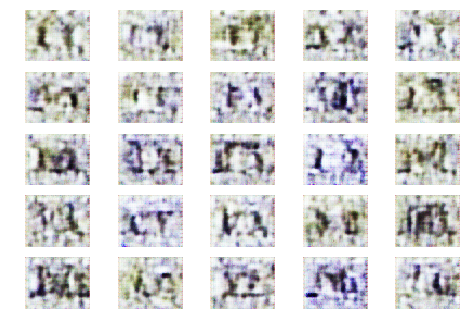

1551 [D loss: 1.008564] [G loss: 1.464830]
1552 [D loss: 1.009231] [G loss: 1.464719]
1553 [D loss: 1.011583] [G loss: 1.465808]
1554 [D loss: 1.011872] [G loss: 1.463153]
1555 [D loss: 1.012398] [G loss: 1.459590]
1556 [D loss: 1.006866] [G loss: 1.461457]
1557 [D loss: 1.009772] [G loss: 1.459373]
1558 [D loss: 1.008995] [G loss: 1.462353]
1559 [D loss: 1.008815] [G loss: 1.461958]
1560 [D loss: 1.009077] [G loss: 1.462351]
1561 [D loss: 1.010220] [G loss: 1.464366]
1562 [D loss: 1.009496] [G loss: 1.471198]
1563 [D loss: 1.005922] [G loss: 1.466639]
1564 [D loss: 1.011090] [G loss: 1.464279]
1565 [D loss: 1.010452] [G loss: 1.464706]
1566 [D loss: 1.010652] [G loss: 1.460854]
1567 [D loss: 1.010041] [G loss: 1.467274]
1568 [D loss: 1.010606] [G loss: 1.470560]
1569 [D loss: 1.011242] [G loss: 1.471484]
1570 [D loss: 1.012447] [G loss: 1.468529]
1571 [D loss: 1.011021] [G loss: 1.465367]
1572 [D loss: 1.013023] [G loss: 1.461568]
1573 [D loss: 1.014487] [G loss: 1.464961]
1574 [D los

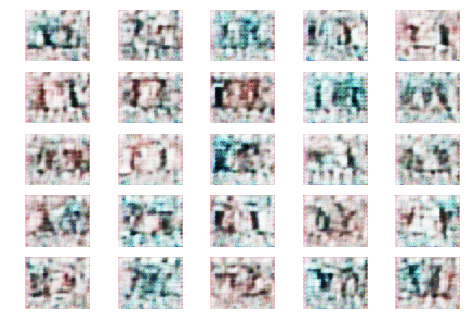

1601 [D loss: 1.012589] [G loss: 1.472250]
1602 [D loss: 1.009703] [G loss: 1.470207]
1603 [D loss: 1.008811] [G loss: 1.467659]
1604 [D loss: 1.009781] [G loss: 1.463982]
1605 [D loss: 1.013170] [G loss: 1.466832]
1606 [D loss: 1.014713] [G loss: 1.464055]
1607 [D loss: 1.015226] [G loss: 1.461150]
1608 [D loss: 1.011038] [G loss: 1.463001]
1609 [D loss: 1.008748] [G loss: 1.467293]
1610 [D loss: 1.016728] [G loss: 1.467617]
1611 [D loss: 1.011335] [G loss: 1.469124]
1612 [D loss: 1.010316] [G loss: 1.470019]
1613 [D loss: 1.012549] [G loss: 1.466759]
1614 [D loss: 1.012229] [G loss: 1.465646]
1615 [D loss: 1.014285] [G loss: 1.457619]
1616 [D loss: 1.009520] [G loss: 1.461531]
1617 [D loss: 1.011429] [G loss: 1.460058]
1618 [D loss: 1.011712] [G loss: 1.464966]
1619 [D loss: 1.009829] [G loss: 1.459898]
1620 [D loss: 1.010568] [G loss: 1.460090]
1621 [D loss: 1.017357] [G loss: 1.460155]
1622 [D loss: 1.014290] [G loss: 1.464412]
1623 [D loss: 1.011343] [G loss: 1.464439]
1624 [D los

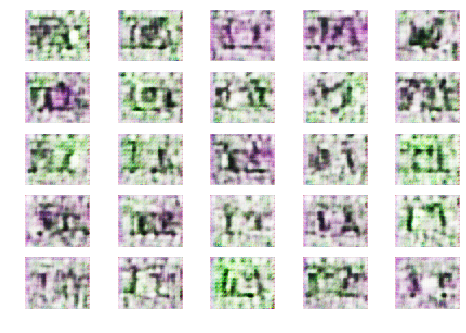

1651 [D loss: 1.014689] [G loss: 1.466518]
1652 [D loss: 1.008776] [G loss: 1.470962]
1653 [D loss: 1.011974] [G loss: 1.468208]
1654 [D loss: 1.010277] [G loss: 1.469458]
1655 [D loss: 1.010084] [G loss: 1.464679]
1656 [D loss: 1.007285] [G loss: 1.470242]
1657 [D loss: 1.009417] [G loss: 1.470200]
1658 [D loss: 1.012933] [G loss: 1.476255]
1659 [D loss: 1.010900] [G loss: 1.472826]
1660 [D loss: 1.010356] [G loss: 1.469423]
1661 [D loss: 1.010482] [G loss: 1.470106]
1662 [D loss: 1.010352] [G loss: 1.470312]
1663 [D loss: 1.010356] [G loss: 1.471511]
1664 [D loss: 1.009974] [G loss: 1.468544]
1665 [D loss: 1.009795] [G loss: 1.466319]
1666 [D loss: 1.009664] [G loss: 1.467619]
1667 [D loss: 1.008933] [G loss: 1.470570]
1668 [D loss: 1.009397] [G loss: 1.467738]
1669 [D loss: 1.010556] [G loss: 1.467088]
1670 [D loss: 1.010370] [G loss: 1.466865]
1671 [D loss: 1.009932] [G loss: 1.471408]
1672 [D loss: 1.007521] [G loss: 1.467735]
1673 [D loss: 1.011673] [G loss: 1.466515]
1674 [D los

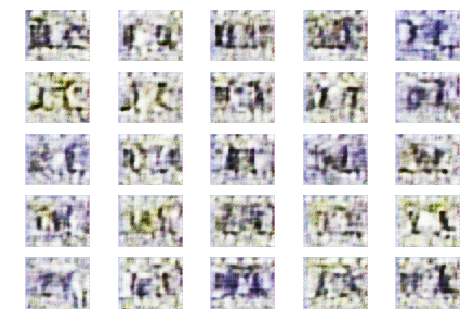

1701 [D loss: 1.007990] [G loss: 1.465844]
1702 [D loss: 1.011561] [G loss: 1.469200]
1703 [D loss: 1.010097] [G loss: 1.464058]
1704 [D loss: 1.009000] [G loss: 1.466400]
1705 [D loss: 1.013428] [G loss: 1.465775]
1706 [D loss: 1.013052] [G loss: 1.463505]
1707 [D loss: 1.006936] [G loss: 1.465294]
1708 [D loss: 1.011326] [G loss: 1.472415]
1709 [D loss: 1.009164] [G loss: 1.471426]
1710 [D loss: 1.012122] [G loss: 1.474701]
1711 [D loss: 1.010774] [G loss: 1.466812]
1712 [D loss: 1.011433] [G loss: 1.467719]
1713 [D loss: 1.011591] [G loss: 1.467859]
1714 [D loss: 1.010299] [G loss: 1.468804]
1715 [D loss: 1.009555] [G loss: 1.469369]
1716 [D loss: 1.008079] [G loss: 1.475408]
1717 [D loss: 1.013051] [G loss: 1.475351]
1718 [D loss: 1.011918] [G loss: 1.471102]
1719 [D loss: 1.012341] [G loss: 1.467273]
1720 [D loss: 1.014242] [G loss: 1.467716]
1721 [D loss: 1.008963] [G loss: 1.475036]
1722 [D loss: 1.009628] [G loss: 1.474425]
1723 [D loss: 1.007736] [G loss: 1.471288]
1724 [D los

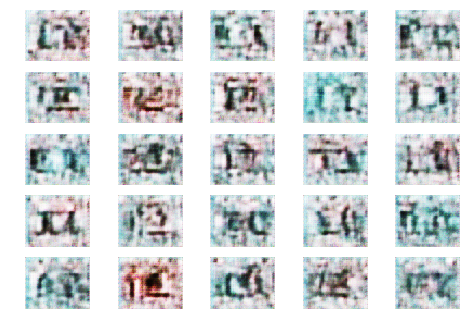

1751 [D loss: 1.010947] [G loss: 1.468050]
1752 [D loss: 1.009970] [G loss: 1.468708]
1753 [D loss: 1.009077] [G loss: 1.468155]
1754 [D loss: 1.009700] [G loss: 1.465976]
1755 [D loss: 1.013198] [G loss: 1.465280]
1756 [D loss: 1.010440] [G loss: 1.460750]
1757 [D loss: 1.009963] [G loss: 1.465441]
1758 [D loss: 1.014869] [G loss: 1.462638]
1759 [D loss: 1.010437] [G loss: 1.465003]
1760 [D loss: 1.011948] [G loss: 1.468693]
1761 [D loss: 1.014435] [G loss: 1.465372]
1762 [D loss: 1.008866] [G loss: 1.466659]
1763 [D loss: 1.012717] [G loss: 1.461819]
1764 [D loss: 1.007371] [G loss: 1.462904]
1765 [D loss: 1.014188] [G loss: 1.465198]
1766 [D loss: 1.010837] [G loss: 1.466837]
1767 [D loss: 1.011838] [G loss: 1.461910]
1768 [D loss: 1.009771] [G loss: 1.466562]
1769 [D loss: 1.012333] [G loss: 1.463627]
1770 [D loss: 1.013473] [G loss: 1.461425]
1771 [D loss: 1.015551] [G loss: 1.461396]
1772 [D loss: 1.011937] [G loss: 1.461768]
1773 [D loss: 1.013425] [G loss: 1.457722]
1774 [D los

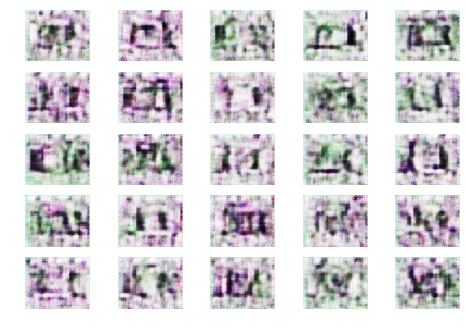

1801 [D loss: 1.010111] [G loss: 1.460958]
1802 [D loss: 1.009462] [G loss: 1.463110]
1803 [D loss: 1.011718] [G loss: 1.466163]
1804 [D loss: 1.008957] [G loss: 1.466869]
1805 [D loss: 1.010364] [G loss: 1.464041]
1806 [D loss: 1.012762] [G loss: 1.464215]
1807 [D loss: 1.008694] [G loss: 1.467106]
1808 [D loss: 1.008726] [G loss: 1.472458]
1809 [D loss: 1.008023] [G loss: 1.469125]
1810 [D loss: 1.010809] [G loss: 1.470480]
1811 [D loss: 1.008436] [G loss: 1.466960]
1812 [D loss: 1.011604] [G loss: 1.461957]
1813 [D loss: 1.011215] [G loss: 1.465419]
1814 [D loss: 1.012352] [G loss: 1.460773]
1815 [D loss: 1.012156] [G loss: 1.463384]
1816 [D loss: 1.008645] [G loss: 1.466914]
1817 [D loss: 1.006966] [G loss: 1.463739]
1818 [D loss: 1.012663] [G loss: 1.470949]
1819 [D loss: 1.009107] [G loss: 1.467955]
1820 [D loss: 1.011594] [G loss: 1.460401]
1821 [D loss: 1.009585] [G loss: 1.463350]
1822 [D loss: 1.006891] [G loss: 1.466328]
1823 [D loss: 1.009882] [G loss: 1.465618]
1824 [D los

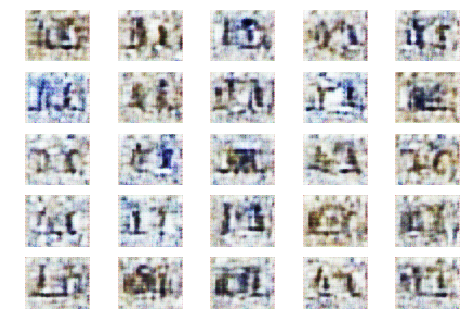

1851 [D loss: 1.005551] [G loss: 1.469020]
1852 [D loss: 1.007376] [G loss: 1.464813]
1853 [D loss: 1.008600] [G loss: 1.463618]
1854 [D loss: 1.007309] [G loss: 1.463213]
1855 [D loss: 1.010826] [G loss: 1.461595]
1856 [D loss: 1.008008] [G loss: 1.459893]
1857 [D loss: 1.009527] [G loss: 1.466899]
1858 [D loss: 1.010738] [G loss: 1.466540]
1859 [D loss: 1.009022] [G loss: 1.463226]
1860 [D loss: 1.007483] [G loss: 1.464861]
1861 [D loss: 1.010063] [G loss: 1.463465]
1862 [D loss: 1.012646] [G loss: 1.465873]
1863 [D loss: 1.005653] [G loss: 1.464795]
1864 [D loss: 1.007215] [G loss: 1.464007]
1865 [D loss: 1.008064] [G loss: 1.464270]
1866 [D loss: 1.009456] [G loss: 1.464100]
1867 [D loss: 1.010145] [G loss: 1.464707]
1868 [D loss: 1.011042] [G loss: 1.464782]
1869 [D loss: 1.008944] [G loss: 1.464688]
1870 [D loss: 1.008799] [G loss: 1.461196]
1871 [D loss: 1.007506] [G loss: 1.465456]
1872 [D loss: 1.010315] [G loss: 1.466669]
1873 [D loss: 1.009459] [G loss: 1.467467]
1874 [D los

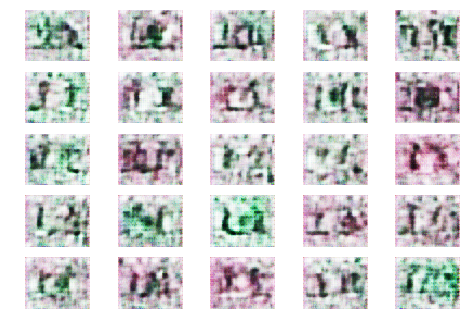

1901 [D loss: 1.005957] [G loss: 1.469884]
1902 [D loss: 1.011740] [G loss: 1.466551]
1903 [D loss: 1.009886] [G loss: 1.469846]
1904 [D loss: 1.010919] [G loss: 1.466543]
1905 [D loss: 1.010949] [G loss: 1.469723]
1906 [D loss: 1.008927] [G loss: 1.467956]
1907 [D loss: 1.013094] [G loss: 1.471229]
1908 [D loss: 1.008484] [G loss: 1.472967]
1909 [D loss: 1.012031] [G loss: 1.472281]
1910 [D loss: 1.012151] [G loss: 1.466560]
1911 [D loss: 1.008675] [G loss: 1.469240]
1912 [D loss: 1.009575] [G loss: 1.472880]
1913 [D loss: 1.009995] [G loss: 1.463709]
1914 [D loss: 1.010679] [G loss: 1.462563]
1915 [D loss: 1.009929] [G loss: 1.463397]
1916 [D loss: 1.006884] [G loss: 1.464390]
1917 [D loss: 1.015454] [G loss: 1.463024]
1918 [D loss: 1.008929] [G loss: 1.463604]
1919 [D loss: 1.013465] [G loss: 1.463754]
1920 [D loss: 1.011638] [G loss: 1.458949]
1921 [D loss: 1.010879] [G loss: 1.460482]
1922 [D loss: 1.008396] [G loss: 1.465882]
1923 [D loss: 1.008000] [G loss: 1.462441]
1924 [D los

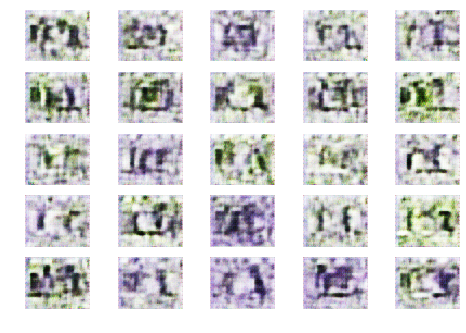

1951 [D loss: 1.011325] [G loss: 1.468095]
1952 [D loss: 1.008639] [G loss: 1.469211]
1953 [D loss: 1.010245] [G loss: 1.463931]
1954 [D loss: 1.011176] [G loss: 1.470162]
1955 [D loss: 1.010011] [G loss: 1.472663]
1956 [D loss: 1.010049] [G loss: 1.469220]
1957 [D loss: 1.009156] [G loss: 1.469037]
1958 [D loss: 1.005917] [G loss: 1.466687]
1959 [D loss: 1.008248] [G loss: 1.471473]
1960 [D loss: 1.010976] [G loss: 1.468435]
1961 [D loss: 1.007802] [G loss: 1.470144]
1962 [D loss: 1.010758] [G loss: 1.467245]
1963 [D loss: 1.012293] [G loss: 1.470859]
1964 [D loss: 1.011705] [G loss: 1.467673]
1965 [D loss: 1.010391] [G loss: 1.467622]
1966 [D loss: 1.012228] [G loss: 1.466002]
1967 [D loss: 1.010975] [G loss: 1.470090]
1968 [D loss: 1.008308] [G loss: 1.471305]
1969 [D loss: 1.009281] [G loss: 1.466899]
1970 [D loss: 1.008782] [G loss: 1.471651]
1971 [D loss: 1.009993] [G loss: 1.470187]
1972 [D loss: 1.005083] [G loss: 1.470272]
1973 [D loss: 1.011577] [G loss: 1.467580]
1974 [D los

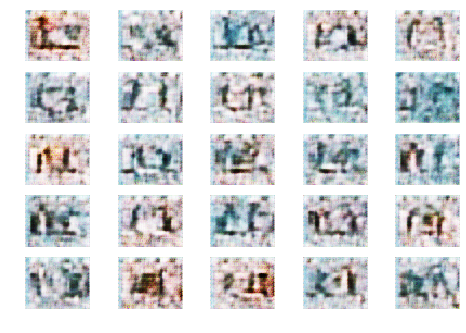

2001 [D loss: 1.008949] [G loss: 1.469950]
2002 [D loss: 1.010161] [G loss: 1.466509]
2003 [D loss: 1.009809] [G loss: 1.461305]
2004 [D loss: 1.008760] [G loss: 1.462730]
2005 [D loss: 1.010280] [G loss: 1.464879]
2006 [D loss: 1.006583] [G loss: 1.466683]
2007 [D loss: 1.007069] [G loss: 1.461313]
2008 [D loss: 1.008618] [G loss: 1.463233]
2009 [D loss: 1.008551] [G loss: 1.461565]
2010 [D loss: 1.008014] [G loss: 1.461610]
2011 [D loss: 1.007564] [G loss: 1.466053]
2012 [D loss: 1.008793] [G loss: 1.468642]
2013 [D loss: 1.007008] [G loss: 1.467358]
2014 [D loss: 1.008359] [G loss: 1.471334]
2015 [D loss: 1.008467] [G loss: 1.465658]
2016 [D loss: 1.008959] [G loss: 1.465497]
2017 [D loss: 1.009750] [G loss: 1.463107]
2018 [D loss: 1.004943] [G loss: 1.465456]
2019 [D loss: 1.010034] [G loss: 1.472549]
2020 [D loss: 1.008917] [G loss: 1.469708]
2021 [D loss: 1.005604] [G loss: 1.468025]
2022 [D loss: 1.010434] [G loss: 1.463300]
2023 [D loss: 1.009663] [G loss: 1.465850]
2024 [D los

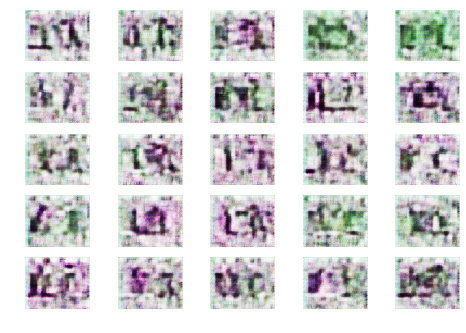

2051 [D loss: 1.009195] [G loss: 1.473452]
2052 [D loss: 1.011110] [G loss: 1.466145]
2053 [D loss: 1.007554] [G loss: 1.470355]
2054 [D loss: 1.009522] [G loss: 1.467517]
2055 [D loss: 1.007500] [G loss: 1.474159]
2056 [D loss: 1.010009] [G loss: 1.468948]
2057 [D loss: 1.010256] [G loss: 1.467141]
2058 [D loss: 1.005179] [G loss: 1.471396]
2059 [D loss: 1.009485] [G loss: 1.471409]
2060 [D loss: 1.010041] [G loss: 1.467080]
2061 [D loss: 1.010917] [G loss: 1.471448]
2062 [D loss: 1.010660] [G loss: 1.469502]
2063 [D loss: 1.008534] [G loss: 1.471781]
2064 [D loss: 1.007707] [G loss: 1.467750]
2065 [D loss: 1.009728] [G loss: 1.465854]
2066 [D loss: 1.008204] [G loss: 1.468666]
2067 [D loss: 1.013155] [G loss: 1.467388]
2068 [D loss: 1.010793] [G loss: 1.466110]
2069 [D loss: 1.009817] [G loss: 1.462382]
2070 [D loss: 1.011792] [G loss: 1.465103]
2071 [D loss: 1.006231] [G loss: 1.462426]
2072 [D loss: 1.011149] [G loss: 1.467648]
2073 [D loss: 1.009382] [G loss: 1.470150]
2074 [D los

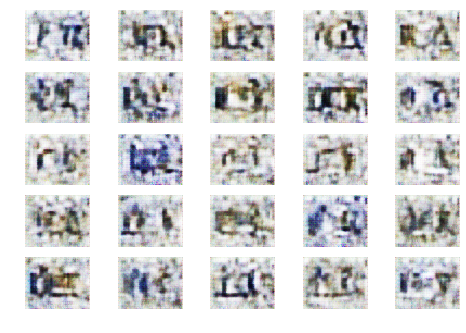

2101 [D loss: 1.010362] [G loss: 1.465903]
2102 [D loss: 1.011898] [G loss: 1.466800]
2103 [D loss: 1.012070] [G loss: 1.466032]
2104 [D loss: 1.009427] [G loss: 1.470042]
2105 [D loss: 1.011313] [G loss: 1.467116]
2106 [D loss: 1.012767] [G loss: 1.467563]
2107 [D loss: 1.012258] [G loss: 1.464634]
2108 [D loss: 1.011530] [G loss: 1.463331]
2109 [D loss: 1.013302] [G loss: 1.462341]
2110 [D loss: 1.011978] [G loss: 1.463966]
2111 [D loss: 1.009524] [G loss: 1.466171]
2112 [D loss: 1.010201] [G loss: 1.464123]
2113 [D loss: 1.007185] [G loss: 1.461534]
2114 [D loss: 1.013537] [G loss: 1.462190]
2115 [D loss: 1.008377] [G loss: 1.457838]
2116 [D loss: 1.007672] [G loss: 1.460491]
2117 [D loss: 1.008653] [G loss: 1.455628]
2118 [D loss: 1.010197] [G loss: 1.456508]
2119 [D loss: 1.007146] [G loss: 1.457068]
2120 [D loss: 1.011355] [G loss: 1.458746]
2121 [D loss: 1.006278] [G loss: 1.460856]
2122 [D loss: 1.010069] [G loss: 1.460685]
2123 [D loss: 1.010021] [G loss: 1.461743]
2124 [D los

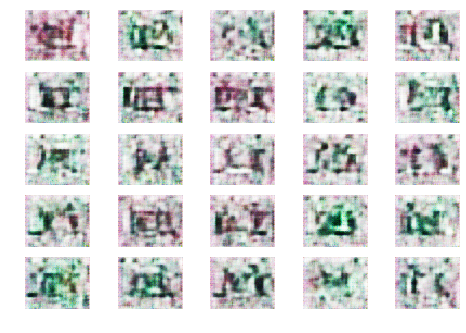

2151 [D loss: 1.008186] [G loss: 1.471600]
2152 [D loss: 1.006500] [G loss: 1.467063]
2153 [D loss: 1.006971] [G loss: 1.464974]
2154 [D loss: 1.007293] [G loss: 1.464113]
2155 [D loss: 1.007372] [G loss: 1.464778]
2156 [D loss: 1.009210] [G loss: 1.463495]
2157 [D loss: 1.008722] [G loss: 1.467609]
2158 [D loss: 1.005455] [G loss: 1.472168]
2159 [D loss: 1.011047] [G loss: 1.467190]
2160 [D loss: 1.008719] [G loss: 1.468181]
2161 [D loss: 1.008362] [G loss: 1.465596]
2162 [D loss: 1.006265] [G loss: 1.467081]
2163 [D loss: 1.009718] [G loss: 1.469166]
2164 [D loss: 1.007760] [G loss: 1.469172]
2165 [D loss: 1.007289] [G loss: 1.468233]
2166 [D loss: 1.008557] [G loss: 1.463607]
2167 [D loss: 1.006005] [G loss: 1.461468]
2168 [D loss: 1.008914] [G loss: 1.465158]
2169 [D loss: 1.006473] [G loss: 1.462092]
2170 [D loss: 1.004095] [G loss: 1.467011]
2171 [D loss: 1.007776] [G loss: 1.468828]
2172 [D loss: 1.008634] [G loss: 1.466778]
2173 [D loss: 1.007606] [G loss: 1.475025]
2174 [D los

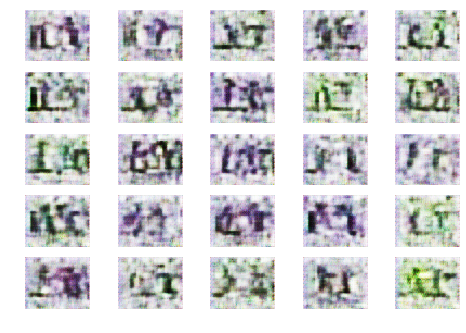

2201 [D loss: 1.007042] [G loss: 1.466601]
2202 [D loss: 1.008961] [G loss: 1.464516]
2203 [D loss: 1.006760] [G loss: 1.463221]
2204 [D loss: 1.009117] [G loss: 1.466580]
2205 [D loss: 1.009025] [G loss: 1.467592]
2206 [D loss: 1.007892] [G loss: 1.467000]
2207 [D loss: 1.008207] [G loss: 1.472829]
2208 [D loss: 1.010527] [G loss: 1.475783]
2209 [D loss: 1.008150] [G loss: 1.472856]
2210 [D loss: 1.007252] [G loss: 1.478608]
2211 [D loss: 1.009071] [G loss: 1.473592]
2212 [D loss: 1.007325] [G loss: 1.474763]
2213 [D loss: 1.005554] [G loss: 1.472629]
2214 [D loss: 1.008881] [G loss: 1.472173]
2215 [D loss: 1.009243] [G loss: 1.471183]
2216 [D loss: 1.010264] [G loss: 1.471242]
2217 [D loss: 1.007855] [G loss: 1.465462]
2218 [D loss: 1.007533] [G loss: 1.467359]
2219 [D loss: 1.009292] [G loss: 1.471244]
2220 [D loss: 1.008499] [G loss: 1.469160]
2221 [D loss: 1.009545] [G loss: 1.470583]
2222 [D loss: 1.005809] [G loss: 1.473279]
2223 [D loss: 1.007859] [G loss: 1.466938]
2224 [D los

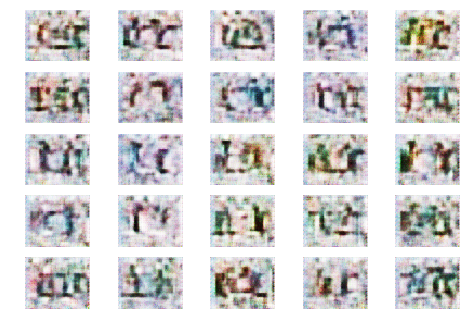

2251 [D loss: 1.007763] [G loss: 1.473864]
2252 [D loss: 1.009384] [G loss: 1.469637]
2253 [D loss: 1.005881] [G loss: 1.471153]
2254 [D loss: 1.007899] [G loss: 1.473684]
2255 [D loss: 1.007374] [G loss: 1.474992]
2256 [D loss: 1.007556] [G loss: 1.474621]
2257 [D loss: 1.007958] [G loss: 1.474077]
2258 [D loss: 1.006917] [G loss: 1.472729]
2259 [D loss: 1.006187] [G loss: 1.470633]
2260 [D loss: 1.002786] [G loss: 1.471931]
2261 [D loss: 1.005166] [G loss: 1.476161]
2262 [D loss: 1.005408] [G loss: 1.469811]
2263 [D loss: 1.003867] [G loss: 1.475046]
2264 [D loss: 1.007061] [G loss: 1.476976]
2265 [D loss: 1.006260] [G loss: 1.472602]
2266 [D loss: 1.008126] [G loss: 1.477820]
2267 [D loss: 1.005621] [G loss: 1.476240]
2268 [D loss: 1.009388] [G loss: 1.476082]
2269 [D loss: 1.007134] [G loss: 1.473532]
2270 [D loss: 1.006870] [G loss: 1.474625]
2271 [D loss: 1.005592] [G loss: 1.476136]
2272 [D loss: 1.002714] [G loss: 1.476027]
2273 [D loss: 1.004804] [G loss: 1.474793]
2274 [D los

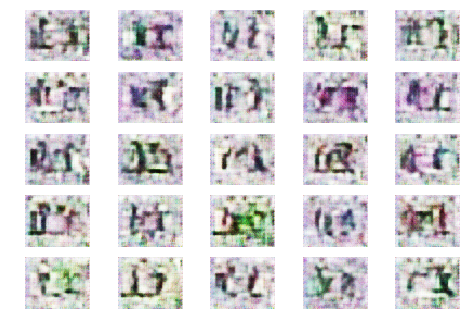

2301 [D loss: 1.006293] [G loss: 1.470876]
2302 [D loss: 1.007245] [G loss: 1.468344]
2303 [D loss: 1.009077] [G loss: 1.469891]
2304 [D loss: 1.008565] [G loss: 1.472727]
2305 [D loss: 1.007900] [G loss: 1.467552]
2306 [D loss: 1.008378] [G loss: 1.467516]
2307 [D loss: 1.008145] [G loss: 1.473331]
2308 [D loss: 1.005136] [G loss: 1.468897]
2309 [D loss: 1.005483] [G loss: 1.473738]
2310 [D loss: 1.005014] [G loss: 1.471472]
2311 [D loss: 1.007444] [G loss: 1.468044]
2312 [D loss: 1.008539] [G loss: 1.472820]
2313 [D loss: 1.007287] [G loss: 1.471048]
2314 [D loss: 1.007459] [G loss: 1.472675]
2315 [D loss: 1.009232] [G loss: 1.470808]
2316 [D loss: 1.006799] [G loss: 1.474006]
2317 [D loss: 1.003542] [G loss: 1.468320]
2318 [D loss: 1.007505] [G loss: 1.470139]
2319 [D loss: 1.008573] [G loss: 1.472697]
2320 [D loss: 1.004773] [G loss: 1.476936]
2321 [D loss: 1.009699] [G loss: 1.470261]
2322 [D loss: 1.007380] [G loss: 1.473167]
2323 [D loss: 1.007179] [G loss: 1.469885]
2324 [D los

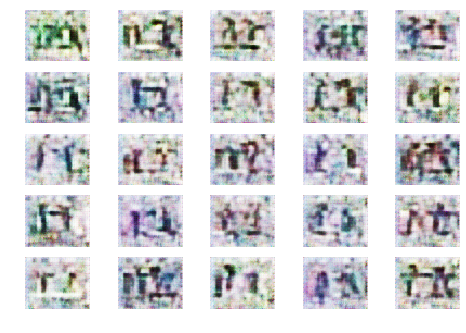

2351 [D loss: 1.007590] [G loss: 1.478490]
2352 [D loss: 1.005679] [G loss: 1.479878]
2353 [D loss: 1.003001] [G loss: 1.479482]
2354 [D loss: 1.006493] [G loss: 1.482739]
2355 [D loss: 1.007639] [G loss: 1.480971]
2356 [D loss: 1.007484] [G loss: 1.481755]
2357 [D loss: 1.006737] [G loss: 1.479722]
2358 [D loss: 1.004914] [G loss: 1.477411]
2359 [D loss: 1.006381] [G loss: 1.479888]
2360 [D loss: 1.007102] [G loss: 1.475976]
2361 [D loss: 1.003003] [G loss: 1.478710]
2362 [D loss: 1.007004] [G loss: 1.478939]
2363 [D loss: 1.007257] [G loss: 1.483410]
2364 [D loss: 1.005848] [G loss: 1.474983]
2365 [D loss: 1.006263] [G loss: 1.476528]
2366 [D loss: 1.007057] [G loss: 1.480090]
2367 [D loss: 1.008215] [G loss: 1.475936]
2368 [D loss: 1.004900] [G loss: 1.480479]
2369 [D loss: 1.007054] [G loss: 1.475577]
2370 [D loss: 1.004464] [G loss: 1.476347]
2371 [D loss: 1.006881] [G loss: 1.474132]
2372 [D loss: 1.006518] [G loss: 1.478365]
2373 [D loss: 1.003365] [G loss: 1.476984]
2374 [D los

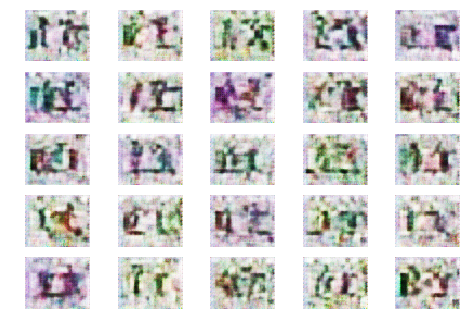

2401 [D loss: 1.005521] [G loss: 1.473390]
2402 [D loss: 1.007872] [G loss: 1.473880]
2403 [D loss: 1.006076] [G loss: 1.476676]
2404 [D loss: 1.006565] [G loss: 1.477887]
2405 [D loss: 1.007330] [G loss: 1.480694]
2406 [D loss: 1.006279] [G loss: 1.480925]
2407 [D loss: 1.005976] [G loss: 1.479595]
2408 [D loss: 1.006200] [G loss: 1.475493]
2409 [D loss: 1.005835] [G loss: 1.473394]
2410 [D loss: 1.004985] [G loss: 1.472827]
2411 [D loss: 1.006135] [G loss: 1.476219]
2412 [D loss: 1.008027] [G loss: 1.474431]
2413 [D loss: 1.006745] [G loss: 1.472730]
2414 [D loss: 1.006376] [G loss: 1.479771]
2415 [D loss: 1.006678] [G loss: 1.477602]
2416 [D loss: 1.007022] [G loss: 1.473976]
2417 [D loss: 1.005970] [G loss: 1.474453]
2418 [D loss: 1.005844] [G loss: 1.474089]
2419 [D loss: 1.003317] [G loss: 1.477119]
2420 [D loss: 1.003648] [G loss: 1.474952]
2421 [D loss: 1.006722] [G loss: 1.479319]
2422 [D loss: 1.008532] [G loss: 1.477371]
2423 [D loss: 1.008661] [G loss: 1.479068]
2424 [D los

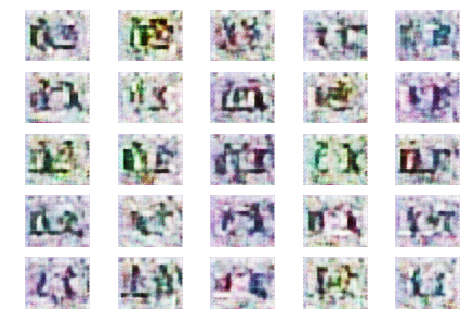

2451 [D loss: 1.003975] [G loss: 1.480991]
2452 [D loss: 1.004973] [G loss: 1.479914]
2453 [D loss: 1.003652] [G loss: 1.477425]
2454 [D loss: 1.007152] [G loss: 1.482499]
2455 [D loss: 1.004166] [G loss: 1.478483]
2456 [D loss: 1.005963] [G loss: 1.476687]
2457 [D loss: 1.006772] [G loss: 1.479585]
2458 [D loss: 1.006244] [G loss: 1.475633]
2459 [D loss: 1.004939] [G loss: 1.478708]
2460 [D loss: 1.003637] [G loss: 1.479517]
2461 [D loss: 1.007762] [G loss: 1.478439]
2462 [D loss: 1.008299] [G loss: 1.478785]
2463 [D loss: 1.007751] [G loss: 1.478359]
2464 [D loss: 1.007853] [G loss: 1.476104]
2465 [D loss: 1.005076] [G loss: 1.478249]
2466 [D loss: 1.005648] [G loss: 1.479318]
2467 [D loss: 1.005413] [G loss: 1.478411]
2468 [D loss: 1.004562] [G loss: 1.478485]
2469 [D loss: 1.006377] [G loss: 1.477419]
2470 [D loss: 1.003368] [G loss: 1.482358]
2471 [D loss: 1.004564] [G loss: 1.478972]
2472 [D loss: 1.006733] [G loss: 1.481312]
2473 [D loss: 1.006757] [G loss: 1.476232]
2474 [D los

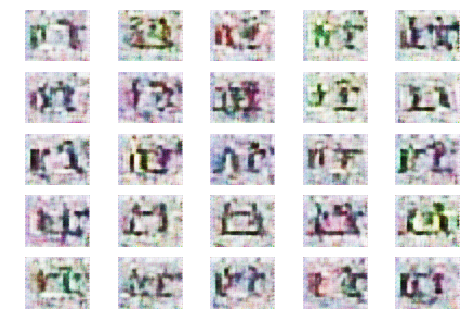

2501 [D loss: 1.006920] [G loss: 1.474774]
2502 [D loss: 1.005098] [G loss: 1.478722]
2503 [D loss: 1.007812] [G loss: 1.477367]
2504 [D loss: 1.005760] [G loss: 1.477785]
2505 [D loss: 1.006536] [G loss: 1.475438]
2506 [D loss: 1.005252] [G loss: 1.478331]
2507 [D loss: 1.006389] [G loss: 1.478146]
2508 [D loss: 1.007153] [G loss: 1.480015]
2509 [D loss: 1.003605] [G loss: 1.479027]
2510 [D loss: 1.006270] [G loss: 1.480276]
2511 [D loss: 1.006308] [G loss: 1.477600]
2512 [D loss: 1.006383] [G loss: 1.479312]
2513 [D loss: 1.005126] [G loss: 1.478459]
2514 [D loss: 1.001459] [G loss: 1.483422]
2515 [D loss: 1.005165] [G loss: 1.485449]
2516 [D loss: 1.005773] [G loss: 1.478013]
2517 [D loss: 1.003365] [G loss: 1.478046]
2518 [D loss: 1.006105] [G loss: 1.476210]
2519 [D loss: 1.005720] [G loss: 1.481166]
2520 [D loss: 1.005976] [G loss: 1.480050]
2521 [D loss: 1.005077] [G loss: 1.482490]
2522 [D loss: 1.005296] [G loss: 1.475797]
2523 [D loss: 1.006628] [G loss: 1.476511]
2524 [D los

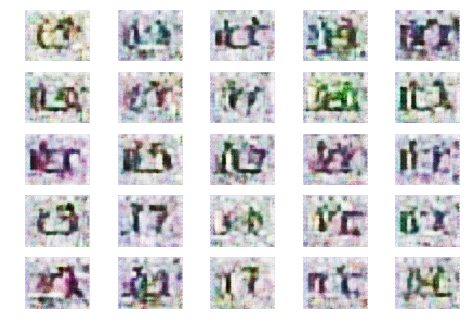

2551 [D loss: 1.006192] [G loss: 1.482055]
2552 [D loss: 1.005019] [G loss: 1.483706]
2553 [D loss: 1.003056] [G loss: 1.482824]
2554 [D loss: 1.004760] [G loss: 1.481346]
2555 [D loss: 1.002503] [G loss: 1.477756]
2556 [D loss: 1.005527] [G loss: 1.480819]
2557 [D loss: 1.006512] [G loss: 1.483019]
2558 [D loss: 1.005274] [G loss: 1.480376]
2559 [D loss: 1.004472] [G loss: 1.479187]
2560 [D loss: 1.002537] [G loss: 1.481943]
2561 [D loss: 1.005023] [G loss: 1.480133]
2562 [D loss: 1.006736] [G loss: 1.480589]
2563 [D loss: 1.005131] [G loss: 1.481892]
2564 [D loss: 1.005559] [G loss: 1.484585]
2565 [D loss: 1.004763] [G loss: 1.484563]
2566 [D loss: 1.005430] [G loss: 1.483761]
2567 [D loss: 1.005445] [G loss: 1.483538]
2568 [D loss: 1.005878] [G loss: 1.480506]
2569 [D loss: 1.005376] [G loss: 1.480857]
2570 [D loss: 1.006215] [G loss: 1.484060]
2571 [D loss: 1.007012] [G loss: 1.480961]
2572 [D loss: 1.004158] [G loss: 1.479723]
2573 [D loss: 1.003658] [G loss: 1.482199]
2574 [D los

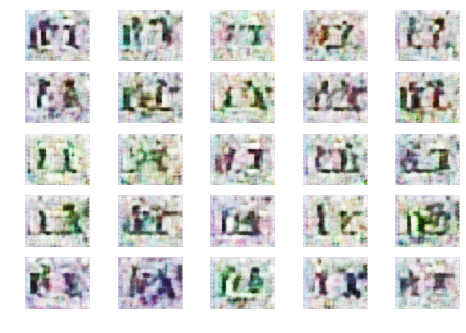

2601 [D loss: 1.005584] [G loss: 1.483276]
2602 [D loss: 1.004888] [G loss: 1.481325]
2603 [D loss: 1.004530] [G loss: 1.482303]
2604 [D loss: 1.004848] [G loss: 1.482021]
2605 [D loss: 1.004855] [G loss: 1.478537]
2606 [D loss: 1.005073] [G loss: 1.479248]
2607 [D loss: 1.006701] [G loss: 1.479263]
2608 [D loss: 1.004205] [G loss: 1.479059]
2609 [D loss: 1.002832] [G loss: 1.483686]
2610 [D loss: 1.005113] [G loss: 1.479741]
2611 [D loss: 1.005423] [G loss: 1.477700]
2612 [D loss: 1.005103] [G loss: 1.479685]
2613 [D loss: 1.004935] [G loss: 1.479656]
2614 [D loss: 1.006274] [G loss: 1.476618]
2615 [D loss: 1.004639] [G loss: 1.482496]
2616 [D loss: 1.003600] [G loss: 1.480329]
2617 [D loss: 1.005624] [G loss: 1.479988]
2618 [D loss: 1.004859] [G loss: 1.478348]
2619 [D loss: 1.006563] [G loss: 1.477653]
2620 [D loss: 1.005292] [G loss: 1.474173]
2621 [D loss: 1.004244] [G loss: 1.478722]
2622 [D loss: 1.007473] [G loss: 1.475885]
2623 [D loss: 1.003849] [G loss: 1.479551]
2624 [D los

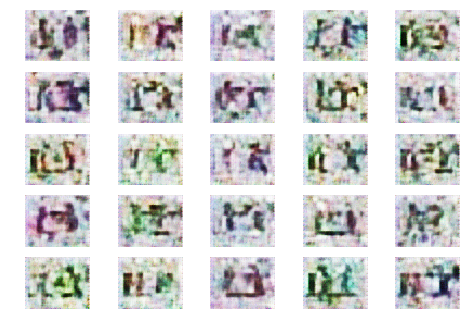

2651 [D loss: 1.005848] [G loss: 1.479033]
2652 [D loss: 1.006018] [G loss: 1.477661]
2653 [D loss: 1.006099] [G loss: 1.479760]
2654 [D loss: 1.005451] [G loss: 1.480047]
2655 [D loss: 1.002788] [G loss: 1.480682]
2656 [D loss: 1.003678] [G loss: 1.481792]
2657 [D loss: 1.006231] [G loss: 1.479289]
2658 [D loss: 1.004105] [G loss: 1.479044]
2659 [D loss: 1.003625] [G loss: 1.482135]
2660 [D loss: 1.005293] [G loss: 1.475260]
2661 [D loss: 1.004551] [G loss: 1.477010]
2662 [D loss: 1.005969] [G loss: 1.481101]
2663 [D loss: 1.007559] [G loss: 1.482089]
2664 [D loss: 1.009836] [G loss: 1.480466]
2665 [D loss: 1.007244] [G loss: 1.478384]
2666 [D loss: 1.005239] [G loss: 1.483421]
2667 [D loss: 1.004264] [G loss: 1.479042]
2668 [D loss: 1.004062] [G loss: 1.478592]
2669 [D loss: 1.005290] [G loss: 1.480246]
2670 [D loss: 1.007113] [G loss: 1.483575]
2671 [D loss: 1.005275] [G loss: 1.481636]
2672 [D loss: 1.004180] [G loss: 1.480637]
2673 [D loss: 1.004922] [G loss: 1.481422]
2674 [D los

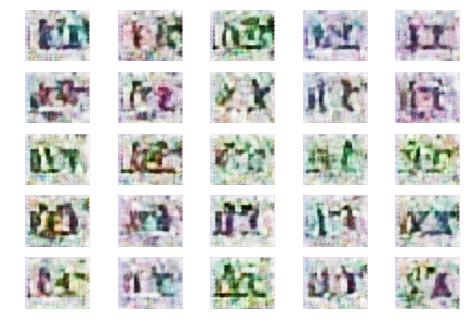

2701 [D loss: 1.004857] [G loss: 1.483655]
2702 [D loss: 1.005342] [G loss: 1.480159]
2703 [D loss: 1.005660] [G loss: 1.481446]
2704 [D loss: 1.006980] [G loss: 1.482187]
2705 [D loss: 1.004767] [G loss: 1.481181]
2706 [D loss: 1.004553] [G loss: 1.481606]
2707 [D loss: 1.004053] [G loss: 1.480448]
2708 [D loss: 1.005337] [G loss: 1.483041]
2709 [D loss: 1.005484] [G loss: 1.478404]
2710 [D loss: 1.006277] [G loss: 1.480475]
2711 [D loss: 1.007950] [G loss: 1.479232]
2712 [D loss: 1.005026] [G loss: 1.482927]
2713 [D loss: 1.004436] [G loss: 1.482864]
2714 [D loss: 1.007333] [G loss: 1.481753]
2715 [D loss: 1.004005] [G loss: 1.485309]
2716 [D loss: 1.005474] [G loss: 1.482931]
2717 [D loss: 1.005575] [G loss: 1.481949]
2718 [D loss: 1.004628] [G loss: 1.481366]
2719 [D loss: 1.007997] [G loss: 1.479604]
2720 [D loss: 1.006479] [G loss: 1.481957]
2721 [D loss: 1.006142] [G loss: 1.477257]
2722 [D loss: 1.007636] [G loss: 1.481013]
2723 [D loss: 1.003126] [G loss: 1.481467]
2724 [D los

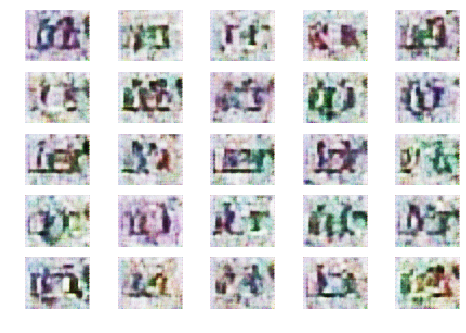

2751 [D loss: 1.004551] [G loss: 1.482533]
2752 [D loss: 1.002662] [G loss: 1.482923]
2753 [D loss: 1.007118] [G loss: 1.483489]
2754 [D loss: 1.004549] [G loss: 1.483324]
2755 [D loss: 1.003972] [G loss: 1.481882]
2756 [D loss: 1.006576] [G loss: 1.480473]
2757 [D loss: 1.006106] [G loss: 1.481016]
2758 [D loss: 1.003591] [G loss: 1.483110]
2759 [D loss: 1.006301] [G loss: 1.484167]
2760 [D loss: 1.004885] [G loss: 1.481286]
2761 [D loss: 1.005288] [G loss: 1.480186]
2762 [D loss: 1.002846] [G loss: 1.478750]
2763 [D loss: 1.003334] [G loss: 1.480952]
2764 [D loss: 1.004156] [G loss: 1.478524]
2765 [D loss: 1.001903] [G loss: 1.480224]
2766 [D loss: 1.005618] [G loss: 1.478514]
2767 [D loss: 1.004875] [G loss: 1.480356]
2768 [D loss: 1.005961] [G loss: 1.477752]
2769 [D loss: 1.003394] [G loss: 1.480723]
2770 [D loss: 1.004215] [G loss: 1.482649]
2771 [D loss: 1.007505] [G loss: 1.479176]
2772 [D loss: 1.006447] [G loss: 1.483472]
2773 [D loss: 1.008200] [G loss: 1.481601]
2774 [D los

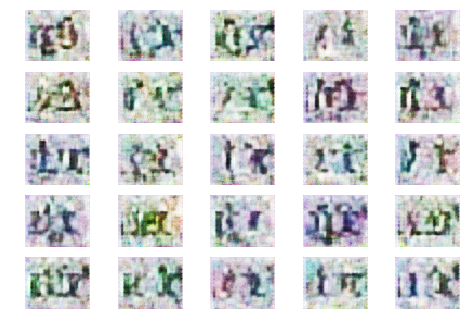

2801 [D loss: 1.003937] [G loss: 1.482262]
2802 [D loss: 1.004469] [G loss: 1.484219]
2803 [D loss: 1.003707] [G loss: 1.484972]
2804 [D loss: 1.006714] [G loss: 1.482123]
2805 [D loss: 1.005050] [G loss: 1.480665]
2806 [D loss: 1.003463] [G loss: 1.481532]
2807 [D loss: 1.004707] [G loss: 1.481374]
2808 [D loss: 1.006872] [G loss: 1.482046]
2809 [D loss: 1.002941] [G loss: 1.482448]
2810 [D loss: 1.003662] [G loss: 1.484958]
2811 [D loss: 1.006794] [G loss: 1.480314]
2812 [D loss: 1.005200] [G loss: 1.481371]
2813 [D loss: 1.005356] [G loss: 1.479349]
2814 [D loss: 1.003897] [G loss: 1.484335]
2815 [D loss: 1.005581] [G loss: 1.481246]
2816 [D loss: 1.004299] [G loss: 1.481172]
2817 [D loss: 1.004287] [G loss: 1.482713]
2818 [D loss: 1.005207] [G loss: 1.478620]
2819 [D loss: 1.005865] [G loss: 1.482278]
2820 [D loss: 1.005912] [G loss: 1.483484]
2821 [D loss: 1.007023] [G loss: 1.481053]
2822 [D loss: 1.004964] [G loss: 1.482769]
2823 [D loss: 1.005305] [G loss: 1.480625]
2824 [D los

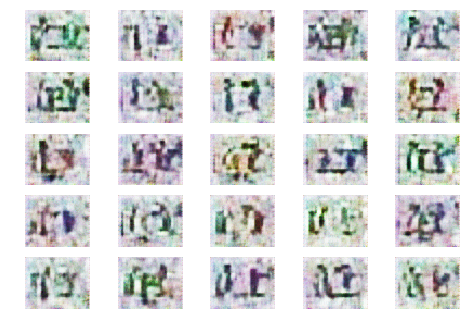

2851 [D loss: 1.004307] [G loss: 1.485084]
2852 [D loss: 1.005659] [G loss: 1.483630]
2853 [D loss: 1.006045] [G loss: 1.483844]
2854 [D loss: 1.004093] [G loss: 1.483280]
2855 [D loss: 1.004129] [G loss: 1.481259]
2856 [D loss: 1.004522] [G loss: 1.481014]
2857 [D loss: 1.004304] [G loss: 1.482262]
2858 [D loss: 1.005666] [G loss: 1.483871]
2859 [D loss: 1.004160] [G loss: 1.483603]
2860 [D loss: 1.004048] [G loss: 1.481695]
2861 [D loss: 1.005208] [G loss: 1.479638]
2862 [D loss: 1.006552] [G loss: 1.479552]
2863 [D loss: 1.005452] [G loss: 1.482224]
2864 [D loss: 1.002897] [G loss: 1.484058]
2865 [D loss: 1.004622] [G loss: 1.483276]
2866 [D loss: 1.004287] [G loss: 1.481658]
2867 [D loss: 1.006118] [G loss: 1.481465]
2868 [D loss: 1.002329] [G loss: 1.484436]
2869 [D loss: 1.001163] [G loss: 1.481768]
2870 [D loss: 1.003894] [G loss: 1.482160]
2871 [D loss: 1.005267] [G loss: 1.481069]
2872 [D loss: 1.004991] [G loss: 1.480693]
2873 [D loss: 1.004443] [G loss: 1.482231]
2874 [D los

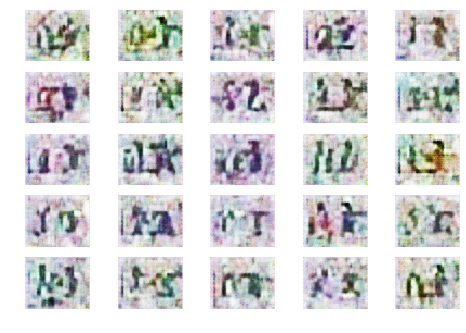

2901 [D loss: 1.003572] [G loss: 1.484758]
2902 [D loss: 1.004773] [G loss: 1.480947]
2903 [D loss: 1.006195] [G loss: 1.484417]
2904 [D loss: 1.002592] [G loss: 1.482348]
2905 [D loss: 1.002545] [G loss: 1.485345]
2906 [D loss: 1.003567] [G loss: 1.484203]
2907 [D loss: 1.005296] [G loss: 1.482136]
2908 [D loss: 1.004132] [G loss: 1.483007]
2909 [D loss: 1.004838] [G loss: 1.481330]
2910 [D loss: 1.005780] [G loss: 1.479721]
2911 [D loss: 1.002873] [G loss: 1.481025]
2912 [D loss: 1.005197] [G loss: 1.483580]
2913 [D loss: 1.004715] [G loss: 1.481128]
2914 [D loss: 1.002686] [G loss: 1.481518]
2915 [D loss: 1.003981] [G loss: 1.481117]
2916 [D loss: 1.007293] [G loss: 1.482716]
2917 [D loss: 1.003198] [G loss: 1.484608]
2918 [D loss: 1.007690] [G loss: 1.481645]
2919 [D loss: 1.002782] [G loss: 1.481906]
2920 [D loss: 1.004619] [G loss: 1.487124]
2921 [D loss: 1.003080] [G loss: 1.484325]
2922 [D loss: 1.005478] [G loss: 1.482926]
2923 [D loss: 1.003445] [G loss: 1.484826]
2924 [D los

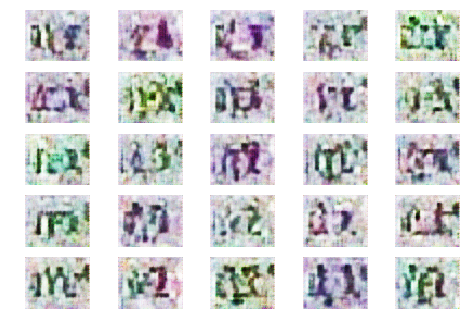

2951 [D loss: 1.005626] [G loss: 1.484705]
2952 [D loss: 1.004249] [G loss: 1.488128]
2953 [D loss: 1.004338] [G loss: 1.483360]
2954 [D loss: 1.006012] [G loss: 1.484422]
2955 [D loss: 1.001982] [G loss: 1.481574]
2956 [D loss: 1.004913] [G loss: 1.480618]
2957 [D loss: 1.004256] [G loss: 1.483821]
2958 [D loss: 1.002775] [G loss: 1.481960]
2959 [D loss: 1.004938] [G loss: 1.483211]
2960 [D loss: 1.004263] [G loss: 1.483967]
2961 [D loss: 1.004568] [G loss: 1.485342]
2962 [D loss: 1.005402] [G loss: 1.485073]
2963 [D loss: 1.006896] [G loss: 1.483179]
2964 [D loss: 1.004539] [G loss: 1.483080]
2965 [D loss: 1.002859] [G loss: 1.483957]
2966 [D loss: 1.001732] [G loss: 1.484578]
2967 [D loss: 1.004135] [G loss: 1.482864]
2968 [D loss: 1.002545] [G loss: 1.483725]
2969 [D loss: 1.002069] [G loss: 1.482175]
2970 [D loss: 1.003764] [G loss: 1.482769]
2971 [D loss: 1.003461] [G loss: 1.485329]
2972 [D loss: 1.006708] [G loss: 1.485609]
2973 [D loss: 1.006629] [G loss: 1.485773]
2974 [D los

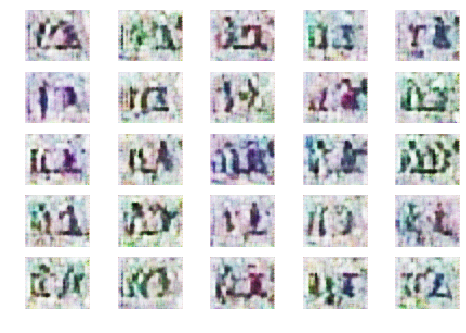

3001 [D loss: 1.004848] [G loss: 1.483187]
3002 [D loss: 1.003095] [G loss: 1.483881]
3003 [D loss: 1.007807] [G loss: 1.487190]
3004 [D loss: 1.003374] [G loss: 1.488571]
3005 [D loss: 1.004444] [G loss: 1.484157]
3006 [D loss: 1.004061] [G loss: 1.484854]
3007 [D loss: 1.004128] [G loss: 1.487533]
3008 [D loss: 1.006147] [G loss: 1.485045]
3009 [D loss: 1.004184] [G loss: 1.482619]
3010 [D loss: 1.005793] [G loss: 1.482241]
3011 [D loss: 1.005482] [G loss: 1.483181]
3012 [D loss: 1.002991] [G loss: 1.481975]
3013 [D loss: 1.004667] [G loss: 1.481791]
3014 [D loss: 1.004209] [G loss: 1.482086]
3015 [D loss: 1.002527] [G loss: 1.482202]
3016 [D loss: 1.005113] [G loss: 1.484837]
3017 [D loss: 1.003081] [G loss: 1.486188]
3018 [D loss: 1.006237] [G loss: 1.480241]
3019 [D loss: 1.001738] [G loss: 1.480648]
3020 [D loss: 1.002121] [G loss: 1.480818]
3021 [D loss: 1.003182] [G loss: 1.483898]
3022 [D loss: 1.003516] [G loss: 1.482251]
3023 [D loss: 1.005124] [G loss: 1.483269]
3024 [D los

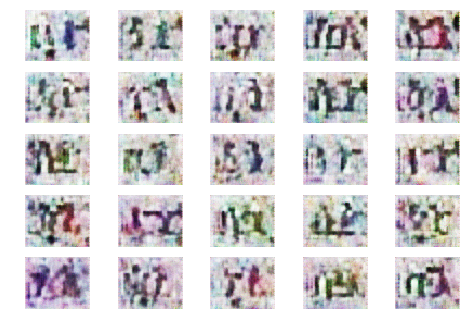

3051 [D loss: 1.003524] [G loss: 1.486005]
3052 [D loss: 1.003520] [G loss: 1.483612]
3053 [D loss: 1.004390] [G loss: 1.482718]
3054 [D loss: 1.000977] [G loss: 1.483293]
3055 [D loss: 1.004685] [G loss: 1.484753]
3056 [D loss: 1.005060] [G loss: 1.485569]
3057 [D loss: 1.003897] [G loss: 1.482784]
3058 [D loss: 1.004677] [G loss: 1.483442]
3059 [D loss: 1.004406] [G loss: 1.486134]
3060 [D loss: 1.003964] [G loss: 1.485556]
3061 [D loss: 1.004008] [G loss: 1.484536]
3062 [D loss: 1.001292] [G loss: 1.483673]
3063 [D loss: 1.000699] [G loss: 1.486661]
3064 [D loss: 1.003123] [G loss: 1.483896]
3065 [D loss: 1.003845] [G loss: 1.485935]
3066 [D loss: 1.005393] [G loss: 1.486242]
3067 [D loss: 1.003037] [G loss: 1.488572]
3068 [D loss: 1.004242] [G loss: 1.484479]
3069 [D loss: 1.003603] [G loss: 1.487565]
3070 [D loss: 1.003310] [G loss: 1.486857]
3071 [D loss: 1.003869] [G loss: 1.484581]
3072 [D loss: 1.004235] [G loss: 1.484133]
3073 [D loss: 1.005027] [G loss: 1.484950]
3074 [D los

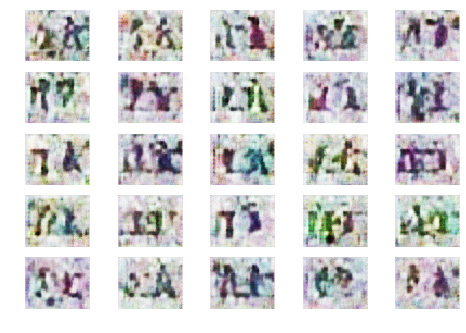

3101 [D loss: 1.003719] [G loss: 1.485078]
3102 [D loss: 1.001900] [G loss: 1.483791]
3103 [D loss: 1.003159] [G loss: 1.485226]
3104 [D loss: 1.003465] [G loss: 1.483576]
3105 [D loss: 1.001899] [G loss: 1.483233]
3106 [D loss: 1.005022] [G loss: 1.485738]
3107 [D loss: 1.003943] [G loss: 1.486070]
3108 [D loss: 1.000793] [G loss: 1.487206]
3109 [D loss: 1.004940] [G loss: 1.486263]
3110 [D loss: 1.002217] [G loss: 1.482352]
3111 [D loss: 1.002688] [G loss: 1.484875]
3112 [D loss: 1.003916] [G loss: 1.483322]
3113 [D loss: 1.006050] [G loss: 1.486019]
3114 [D loss: 1.003304] [G loss: 1.486035]
3115 [D loss: 1.006405] [G loss: 1.483555]
3116 [D loss: 1.003365] [G loss: 1.484493]
3117 [D loss: 1.004251] [G loss: 1.485241]
3118 [D loss: 1.005214] [G loss: 1.484630]
3119 [D loss: 1.004231] [G loss: 1.483386]
3120 [D loss: 1.003103] [G loss: 1.487590]
3121 [D loss: 1.004729] [G loss: 1.486096]
3122 [D loss: 1.004754] [G loss: 1.487183]
3123 [D loss: 1.001910] [G loss: 1.484961]
3124 [D los

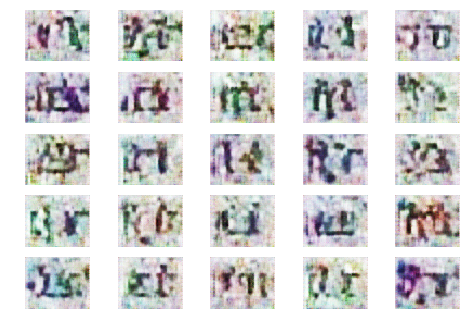

3151 [D loss: 1.003925] [G loss: 1.482679]
3152 [D loss: 1.003327] [G loss: 1.483658]
3153 [D loss: 1.002597] [G loss: 1.484295]
3154 [D loss: 1.006342] [G loss: 1.482327]
3155 [D loss: 1.005605] [G loss: 1.482147]
3156 [D loss: 1.002921] [G loss: 1.484063]
3157 [D loss: 1.004970] [G loss: 1.486779]
3158 [D loss: 1.004891] [G loss: 1.486309]
3159 [D loss: 1.003970] [G loss: 1.484029]
3160 [D loss: 1.001840] [G loss: 1.481436]
3161 [D loss: 1.004870] [G loss: 1.482815]
3162 [D loss: 1.001211] [G loss: 1.484955]
3163 [D loss: 1.004600] [G loss: 1.486937]
3164 [D loss: 1.003529] [G loss: 1.484992]
3165 [D loss: 1.003988] [G loss: 1.483748]
3166 [D loss: 1.003820] [G loss: 1.483957]
3167 [D loss: 1.006639] [G loss: 1.483940]
3168 [D loss: 1.004182] [G loss: 1.483958]
3169 [D loss: 1.006287] [G loss: 1.482915]
3170 [D loss: 1.002155] [G loss: 1.485156]
3171 [D loss: 1.003962] [G loss: 1.485709]
3172 [D loss: 1.002604] [G loss: 1.488106]
3173 [D loss: 1.003220] [G loss: 1.487141]
3174 [D los

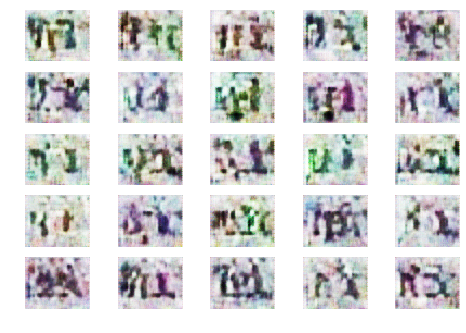

3201 [D loss: 1.003468] [G loss: 1.486026]
3202 [D loss: 1.003420] [G loss: 1.481980]
3203 [D loss: 1.004218] [G loss: 1.484664]
3204 [D loss: 1.004143] [G loss: 1.486107]
3205 [D loss: 1.003099] [G loss: 1.484603]
3206 [D loss: 1.004155] [G loss: 1.481949]
3207 [D loss: 1.003165] [G loss: 1.484581]
3208 [D loss: 1.004428] [G loss: 1.484407]
3209 [D loss: 1.004569] [G loss: 1.487242]
3210 [D loss: 1.004949] [G loss: 1.483543]
3211 [D loss: 1.004440] [G loss: 1.486574]
3212 [D loss: 1.004096] [G loss: 1.488902]
3213 [D loss: 1.003747] [G loss: 1.485278]
3214 [D loss: 1.002763] [G loss: 1.484090]
3215 [D loss: 1.006273] [G loss: 1.485812]
3216 [D loss: 1.003919] [G loss: 1.485301]
3217 [D loss: 1.004865] [G loss: 1.485720]
3218 [D loss: 1.005575] [G loss: 1.483115]
3219 [D loss: 1.004329] [G loss: 1.481660]
3220 [D loss: 1.003903] [G loss: 1.485284]
3221 [D loss: 1.006101] [G loss: 1.485082]
3222 [D loss: 1.002965] [G loss: 1.484611]
3223 [D loss: 1.004270] [G loss: 1.486288]
3224 [D los

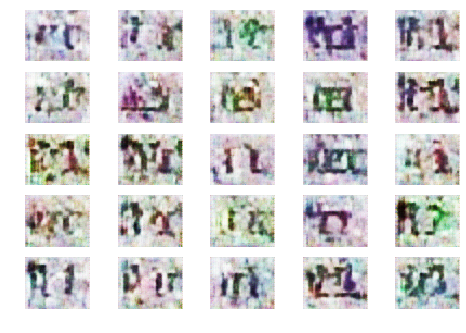

3251 [D loss: 1.003825] [G loss: 1.483567]
3252 [D loss: 1.003389] [G loss: 1.483033]
3253 [D loss: 1.004562] [G loss: 1.485878]
3254 [D loss: 1.005090] [G loss: 1.482502]
3255 [D loss: 1.001853] [G loss: 1.485932]
3256 [D loss: 1.005742] [G loss: 1.487753]
3257 [D loss: 1.003710] [G loss: 1.482081]
3258 [D loss: 1.003152] [G loss: 1.484129]
3259 [D loss: 1.006547] [G loss: 1.487681]
3260 [D loss: 1.003304] [G loss: 1.485292]
3261 [D loss: 1.003045] [G loss: 1.490057]
3262 [D loss: 1.002103] [G loss: 1.484579]
3263 [D loss: 1.001704] [G loss: 1.485829]
3264 [D loss: 1.004238] [G loss: 1.485743]
3265 [D loss: 1.002491] [G loss: 1.488298]
3266 [D loss: 1.003642] [G loss: 1.485942]
3267 [D loss: 1.005292] [G loss: 1.484790]
3268 [D loss: 1.003344] [G loss: 1.485690]
3269 [D loss: 1.004215] [G loss: 1.482416]
3270 [D loss: 1.002426] [G loss: 1.484648]
3271 [D loss: 1.004186] [G loss: 1.484802]
3272 [D loss: 1.006080] [G loss: 1.485882]
3273 [D loss: 1.003492] [G loss: 1.481760]
3274 [D los

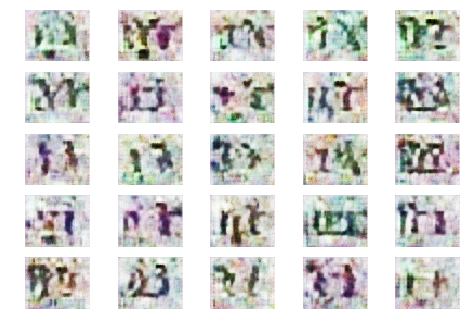

3301 [D loss: 1.004257] [G loss: 1.484516]
3302 [D loss: 1.002694] [G loss: 1.489185]
3303 [D loss: 1.004621] [G loss: 1.485632]
3304 [D loss: 1.004036] [G loss: 1.485263]
3305 [D loss: 1.005456] [G loss: 1.483528]
3306 [D loss: 1.003434] [G loss: 1.484026]
3307 [D loss: 1.004596] [G loss: 1.486268]
3308 [D loss: 1.004687] [G loss: 1.487721]
3309 [D loss: 1.005386] [G loss: 1.485251]
3310 [D loss: 1.005521] [G loss: 1.484445]
3311 [D loss: 1.002389] [G loss: 1.483474]
3312 [D loss: 1.003806] [G loss: 1.483876]
3313 [D loss: 1.003121] [G loss: 1.482621]
3314 [D loss: 1.004676] [G loss: 1.485571]
3315 [D loss: 1.004718] [G loss: 1.484265]
3316 [D loss: 1.002634] [G loss: 1.487248]
3317 [D loss: 1.005484] [G loss: 1.482163]
3318 [D loss: 1.002848] [G loss: 1.481810]
3319 [D loss: 1.003402] [G loss: 1.485449]
3320 [D loss: 1.002791] [G loss: 1.480409]
3321 [D loss: 1.005310] [G loss: 1.484331]
3322 [D loss: 1.003290] [G loss: 1.485043]
3323 [D loss: 1.003858] [G loss: 1.485082]
3324 [D los

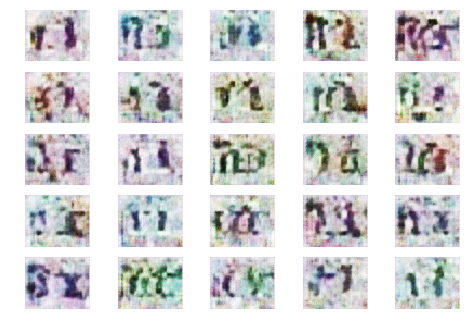

3351 [D loss: 1.005118] [G loss: 1.486593]
3352 [D loss: 1.002609] [G loss: 1.484846]
3353 [D loss: 1.004067] [G loss: 1.485323]
3354 [D loss: 1.001999] [G loss: 1.485485]
3355 [D loss: 1.004929] [G loss: 1.484827]
3356 [D loss: 1.003482] [G loss: 1.486125]
3357 [D loss: 1.003062] [G loss: 1.483559]
3358 [D loss: 1.003918] [G loss: 1.485741]
3359 [D loss: 1.003217] [G loss: 1.485995]
3360 [D loss: 1.006526] [G loss: 1.486498]
3361 [D loss: 1.004361] [G loss: 1.484508]
3362 [D loss: 1.001316] [G loss: 1.486518]
3363 [D loss: 1.004276] [G loss: 1.486235]
3364 [D loss: 1.003358] [G loss: 1.485576]
3365 [D loss: 1.002670] [G loss: 1.482108]
3366 [D loss: 1.005286] [G loss: 1.486082]
3367 [D loss: 1.005168] [G loss: 1.482807]
3368 [D loss: 1.004290] [G loss: 1.485105]
3369 [D loss: 1.002045] [G loss: 1.483771]
3370 [D loss: 1.002613] [G loss: 1.484737]
3371 [D loss: 1.003687] [G loss: 1.483007]
3372 [D loss: 1.005144] [G loss: 1.482801]
3373 [D loss: 1.004279] [G loss: 1.483327]
3374 [D los

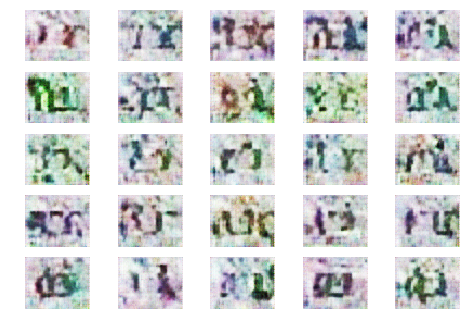

3401 [D loss: 1.003862] [G loss: 1.484463]
3402 [D loss: 1.004307] [G loss: 1.484782]
3403 [D loss: 1.005946] [G loss: 1.485171]
3404 [D loss: 1.004297] [G loss: 1.484220]
3405 [D loss: 1.005765] [G loss: 1.485073]
3406 [D loss: 1.004668] [G loss: 1.486675]
3407 [D loss: 1.006568] [G loss: 1.489325]
3408 [D loss: 1.006804] [G loss: 1.484362]
3409 [D loss: 1.005291] [G loss: 1.484685]
3410 [D loss: 1.003772] [G loss: 1.484154]
3411 [D loss: 1.003667] [G loss: 1.487830]
3412 [D loss: 1.002743] [G loss: 1.485021]
3413 [D loss: 1.004905] [G loss: 1.485341]
3414 [D loss: 1.003692] [G loss: 1.487023]
3415 [D loss: 1.003699] [G loss: 1.487981]
3416 [D loss: 1.002375] [G loss: 1.484529]
3417 [D loss: 1.003060] [G loss: 1.487633]
3418 [D loss: 1.004518] [G loss: 1.486162]
3419 [D loss: 1.003319] [G loss: 1.487535]
3420 [D loss: 1.005359] [G loss: 1.484256]
3421 [D loss: 1.004914] [G loss: 1.484066]
3422 [D loss: 1.003844] [G loss: 1.486997]
3423 [D loss: 1.004797] [G loss: 1.487359]
3424 [D los

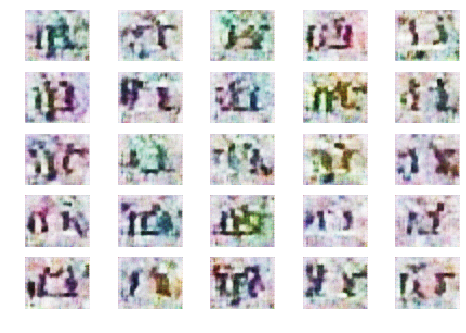

3451 [D loss: 1.002116] [G loss: 1.482695]
3452 [D loss: 1.003993] [G loss: 1.484721]
3453 [D loss: 1.002338] [G loss: 1.484465]
3454 [D loss: 1.004891] [G loss: 1.486622]
3455 [D loss: 1.002301] [G loss: 1.485098]
3456 [D loss: 1.003832] [G loss: 1.486089]
3457 [D loss: 1.003702] [G loss: 1.487355]
3458 [D loss: 1.004040] [G loss: 1.486564]
3459 [D loss: 1.002206] [G loss: 1.487255]
3460 [D loss: 1.004213] [G loss: 1.485174]
3461 [D loss: 1.002415] [G loss: 1.484793]
3462 [D loss: 1.005307] [G loss: 1.487270]
3463 [D loss: 1.004533] [G loss: 1.484895]
3464 [D loss: 1.005246] [G loss: 1.485039]
3465 [D loss: 1.004167] [G loss: 1.482821]
3466 [D loss: 1.004215] [G loss: 1.485275]
3467 [D loss: 1.003421] [G loss: 1.488111]
3468 [D loss: 1.005499] [G loss: 1.483107]
3469 [D loss: 1.004604] [G loss: 1.485534]
3470 [D loss: 1.003828] [G loss: 1.485346]
3471 [D loss: 1.004167] [G loss: 1.485074]
3472 [D loss: 1.003531] [G loss: 1.486332]
3473 [D loss: 1.003765] [G loss: 1.486774]
3474 [D los

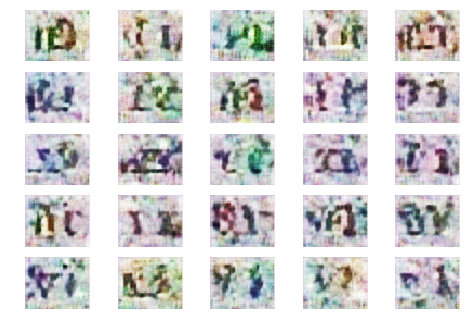

3501 [D loss: 1.004458] [G loss: 1.485135]
3502 [D loss: 1.004803] [G loss: 1.487161]
3503 [D loss: 1.005316] [G loss: 1.484883]
3504 [D loss: 1.004647] [G loss: 1.485026]
3505 [D loss: 1.005132] [G loss: 1.483658]
3506 [D loss: 1.005029] [G loss: 1.486245]
3507 [D loss: 1.004389] [G loss: 1.484923]
3508 [D loss: 1.005840] [G loss: 1.488484]
3509 [D loss: 1.003569] [G loss: 1.487968]
3510 [D loss: 1.001761] [G loss: 1.485720]
3511 [D loss: 1.003937] [G loss: 1.483554]
3512 [D loss: 1.004669] [G loss: 1.484673]
3513 [D loss: 1.003353] [G loss: 1.483717]
3514 [D loss: 1.004964] [G loss: 1.487131]
3515 [D loss: 1.004943] [G loss: 1.483835]
3516 [D loss: 1.005609] [G loss: 1.482921]
3517 [D loss: 1.004496] [G loss: 1.485120]
3518 [D loss: 1.003972] [G loss: 1.485518]
3519 [D loss: 1.002417] [G loss: 1.488507]
3520 [D loss: 1.003949] [G loss: 1.483634]
3521 [D loss: 1.004427] [G loss: 1.487355]
3522 [D loss: 1.004385] [G loss: 1.487766]
3523 [D loss: 1.000984] [G loss: 1.485553]
3524 [D los

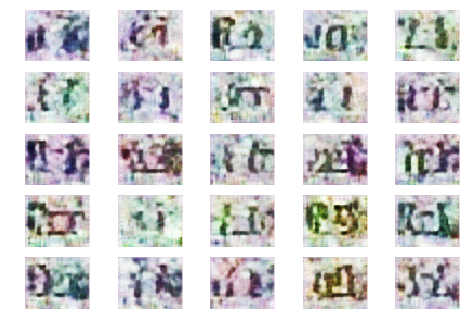

3551 [D loss: 1.003733] [G loss: 1.486587]
3552 [D loss: 1.005831] [G loss: 1.487637]
3553 [D loss: 1.005344] [G loss: 1.485634]
3554 [D loss: 1.004281] [G loss: 1.489481]
3555 [D loss: 1.005935] [G loss: 1.485191]
3556 [D loss: 1.003717] [G loss: 1.483734]
3557 [D loss: 1.003415] [G loss: 1.485835]
3558 [D loss: 1.007417] [G loss: 1.484056]
3559 [D loss: 1.002924] [G loss: 1.485736]
3560 [D loss: 1.002372] [G loss: 1.486079]
3561 [D loss: 1.004764] [G loss: 1.487979]
3562 [D loss: 1.002318] [G loss: 1.486301]
3563 [D loss: 1.001648] [G loss: 1.487280]
3564 [D loss: 1.004038] [G loss: 1.487916]
3565 [D loss: 1.005615] [G loss: 1.485707]
3566 [D loss: 1.004682] [G loss: 1.488741]
3567 [D loss: 1.003939] [G loss: 1.486123]
3568 [D loss: 1.004706] [G loss: 1.483657]
3569 [D loss: 1.003875] [G loss: 1.486895]
3570 [D loss: 1.003900] [G loss: 1.488167]
3571 [D loss: 1.004078] [G loss: 1.485006]
3572 [D loss: 1.008311] [G loss: 1.486388]
3573 [D loss: 1.005348] [G loss: 1.487383]
3574 [D los

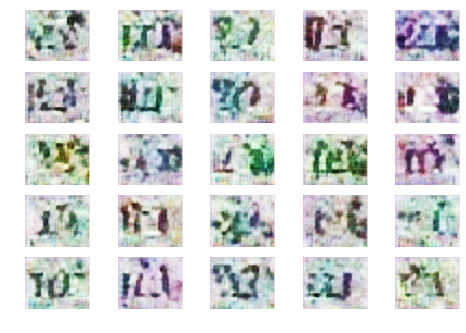

3601 [D loss: 1.005213] [G loss: 1.487728]
3602 [D loss: 1.007208] [G loss: 1.487334]
3603 [D loss: 1.001467] [G loss: 1.488410]
3604 [D loss: 1.002795] [G loss: 1.487292]
3605 [D loss: 1.005642] [G loss: 1.487311]
3606 [D loss: 1.001547] [G loss: 1.484109]
3607 [D loss: 1.004064] [G loss: 1.483715]
3608 [D loss: 1.003769] [G loss: 1.484553]
3609 [D loss: 1.002690] [G loss: 1.486590]
3610 [D loss: 1.003866] [G loss: 1.484897]
3611 [D loss: 1.003423] [G loss: 1.484344]
3612 [D loss: 1.003885] [G loss: 1.487157]
3613 [D loss: 1.003023] [G loss: 1.484408]
3614 [D loss: 1.004099] [G loss: 1.484281]
3615 [D loss: 1.004400] [G loss: 1.484950]
3616 [D loss: 1.004212] [G loss: 1.485664]
3617 [D loss: 1.004424] [G loss: 1.486101]
3618 [D loss: 1.002473] [G loss: 1.487323]
3619 [D loss: 1.005411] [G loss: 1.487726]
3620 [D loss: 1.001241] [G loss: 1.489987]
3621 [D loss: 1.005290] [G loss: 1.487432]
3622 [D loss: 1.003990] [G loss: 1.485857]
3623 [D loss: 1.004858] [G loss: 1.488542]
3624 [D los

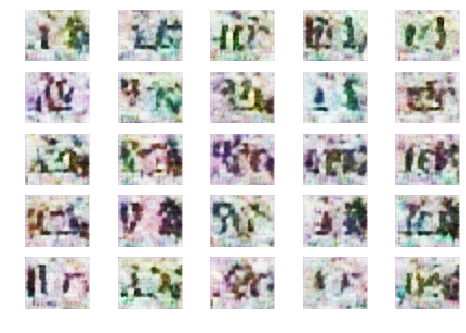

3651 [D loss: 1.003420] [G loss: 1.490680]
3652 [D loss: 1.003638] [G loss: 1.487173]
3653 [D loss: 1.003062] [G loss: 1.487791]
3654 [D loss: 1.004454] [G loss: 1.488085]
3655 [D loss: 1.001653] [G loss: 1.486150]
3656 [D loss: 1.003180] [G loss: 1.484739]
3657 [D loss: 1.005145] [G loss: 1.488386]
3658 [D loss: 1.002048] [G loss: 1.486113]
3659 [D loss: 1.002956] [G loss: 1.487107]
3660 [D loss: 1.003583] [G loss: 1.486753]
3661 [D loss: 1.003191] [G loss: 1.486575]
3662 [D loss: 1.003641] [G loss: 1.486511]
3663 [D loss: 1.003641] [G loss: 1.485212]
3664 [D loss: 1.005894] [G loss: 1.486025]
3665 [D loss: 1.003986] [G loss: 1.488118]
3666 [D loss: 1.003102] [G loss: 1.483925]
3667 [D loss: 1.008271] [G loss: 1.484889]
3668 [D loss: 1.004810] [G loss: 1.484995]
3669 [D loss: 1.002086] [G loss: 1.484956]
3670 [D loss: 1.001738] [G loss: 1.488983]
3671 [D loss: 1.005455] [G loss: 1.488232]
3672 [D loss: 1.003902] [G loss: 1.485842]
3673 [D loss: 1.003510] [G loss: 1.487561]
3674 [D los

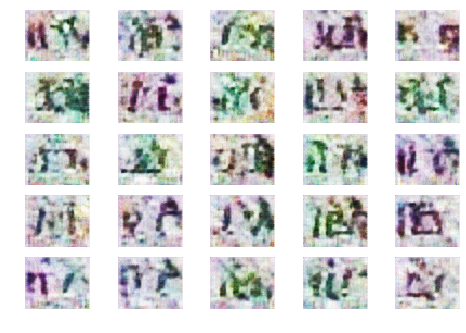

3701 [D loss: 1.003956] [G loss: 1.490629]
3702 [D loss: 1.004170] [G loss: 1.489951]
3703 [D loss: 1.004132] [G loss: 1.489819]
3704 [D loss: 1.004282] [G loss: 1.486527]
3705 [D loss: 1.003248] [G loss: 1.490445]
3706 [D loss: 1.004653] [G loss: 1.489645]
3707 [D loss: 1.005454] [G loss: 1.485826]
3708 [D loss: 1.005205] [G loss: 1.487410]
3709 [D loss: 1.000886] [G loss: 1.488906]
3710 [D loss: 1.004146] [G loss: 1.488168]
3711 [D loss: 1.003309] [G loss: 1.487126]
3712 [D loss: 1.004673] [G loss: 1.485025]
3713 [D loss: 1.003565] [G loss: 1.486666]
3714 [D loss: 1.003394] [G loss: 1.487537]
3715 [D loss: 1.005159] [G loss: 1.488894]
3716 [D loss: 1.002488] [G loss: 1.489217]
3717 [D loss: 1.003622] [G loss: 1.489537]
3718 [D loss: 1.004048] [G loss: 1.489232]
3719 [D loss: 1.004509] [G loss: 1.487447]
3720 [D loss: 1.003914] [G loss: 1.487233]
3721 [D loss: 1.001643] [G loss: 1.487964]
3722 [D loss: 1.000400] [G loss: 1.487371]
3723 [D loss: 1.002576] [G loss: 1.489096]
3724 [D los

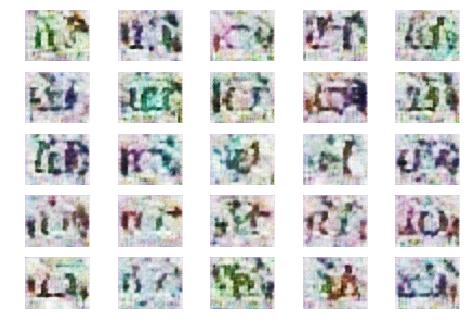

3751 [D loss: 1.002696] [G loss: 1.485651]
3752 [D loss: 1.002845] [G loss: 1.488659]
3753 [D loss: 1.006171] [G loss: 1.488836]
3754 [D loss: 1.002735] [G loss: 1.491665]
3755 [D loss: 1.003274] [G loss: 1.489588]
3756 [D loss: 1.003267] [G loss: 1.488076]
3757 [D loss: 1.004682] [G loss: 1.488323]
3758 [D loss: 1.003243] [G loss: 1.487330]
3759 [D loss: 1.003329] [G loss: 1.487759]
3760 [D loss: 1.002889] [G loss: 1.488647]
3761 [D loss: 1.002851] [G loss: 1.487924]
3762 [D loss: 1.005263] [G loss: 1.487653]
3763 [D loss: 1.005619] [G loss: 1.487447]
3764 [D loss: 1.003019] [G loss: 1.485343]
3765 [D loss: 1.001221] [G loss: 1.488528]
3766 [D loss: 1.002889] [G loss: 1.491774]
3767 [D loss: 1.000387] [G loss: 1.489444]
3768 [D loss: 1.005478] [G loss: 1.484724]
3769 [D loss: 1.004782] [G loss: 1.489116]
3770 [D loss: 1.003803] [G loss: 1.486829]
3771 [D loss: 1.002106] [G loss: 1.487837]
3772 [D loss: 1.003125] [G loss: 1.486713]
3773 [D loss: 1.004522] [G loss: 1.488744]
3774 [D los

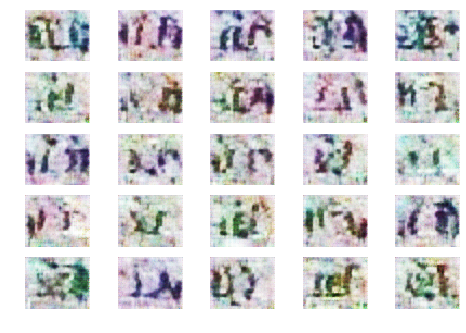

3801 [D loss: 1.001831] [G loss: 1.489231]
3802 [D loss: 1.002184] [G loss: 1.490511]
3803 [D loss: 1.003497] [G loss: 1.493477]
3804 [D loss: 1.002516] [G loss: 1.490073]
3805 [D loss: 1.003437] [G loss: 1.487702]
3806 [D loss: 1.002466] [G loss: 1.488567]
3807 [D loss: 1.002563] [G loss: 1.485799]
3808 [D loss: 1.003166] [G loss: 1.488094]
3809 [D loss: 1.003870] [G loss: 1.487365]
3810 [D loss: 1.004537] [G loss: 1.486964]
3811 [D loss: 1.005262] [G loss: 1.486405]
3812 [D loss: 1.004926] [G loss: 1.488001]
3813 [D loss: 1.003363] [G loss: 1.487204]
3814 [D loss: 1.002932] [G loss: 1.487791]
3815 [D loss: 1.002585] [G loss: 1.491382]
3816 [D loss: 1.002948] [G loss: 1.488090]
3817 [D loss: 1.002195] [G loss: 1.489808]
3818 [D loss: 1.003604] [G loss: 1.487742]
3819 [D loss: 1.003735] [G loss: 1.489413]
3820 [D loss: 1.002250] [G loss: 1.489778]
3821 [D loss: 1.001792] [G loss: 1.493036]
3822 [D loss: 1.005999] [G loss: 1.488461]
3823 [D loss: 1.003351] [G loss: 1.487368]
3824 [D los

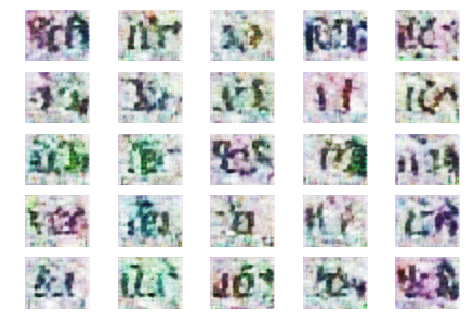

3851 [D loss: 1.003682] [G loss: 1.489720]
3852 [D loss: 1.002429] [G loss: 1.488834]
3853 [D loss: 1.003747] [G loss: 1.489199]
3854 [D loss: 1.003977] [G loss: 1.488916]
3855 [D loss: 1.004207] [G loss: 1.486739]
3856 [D loss: 1.004240] [G loss: 1.489828]
3857 [D loss: 1.004718] [G loss: 1.486379]
3858 [D loss: 1.003862] [G loss: 1.487951]
3859 [D loss: 1.002925] [G loss: 1.487744]
3860 [D loss: 1.002639] [G loss: 1.489338]
3861 [D loss: 1.004963] [G loss: 1.489311]
3862 [D loss: 1.003280] [G loss: 1.491341]
3863 [D loss: 1.004709] [G loss: 1.492636]
3864 [D loss: 1.003320] [G loss: 1.489140]
3865 [D loss: 1.003145] [G loss: 1.489264]
3866 [D loss: 1.003124] [G loss: 1.489997]
3867 [D loss: 1.004980] [G loss: 1.487125]
3868 [D loss: 1.002477] [G loss: 1.488997]
3869 [D loss: 1.003102] [G loss: 1.488614]
3870 [D loss: 1.005086] [G loss: 1.489430]
3871 [D loss: 1.003355] [G loss: 1.488589]
3872 [D loss: 1.001886] [G loss: 1.489342]
3873 [D loss: 1.005286] [G loss: 1.490421]
3874 [D los

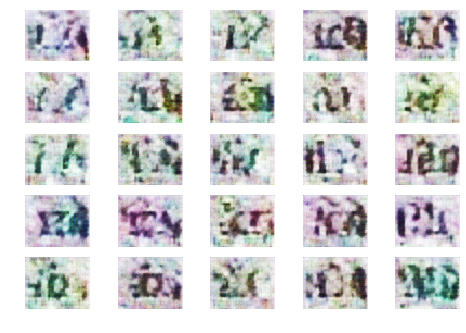

3901 [D loss: 1.003759] [G loss: 1.487496]
3902 [D loss: 1.005096] [G loss: 1.489333]
3903 [D loss: 1.002912] [G loss: 1.487465]
3904 [D loss: 1.002098] [G loss: 1.486866]
3905 [D loss: 1.003697] [G loss: 1.491362]
3906 [D loss: 1.004394] [G loss: 1.491633]
3907 [D loss: 1.002863] [G loss: 1.490269]
3908 [D loss: 1.002442] [G loss: 1.488954]
3909 [D loss: 1.004243] [G loss: 1.489201]
3910 [D loss: 1.003865] [G loss: 1.489536]
3911 [D loss: 1.003605] [G loss: 1.491305]
3912 [D loss: 1.003862] [G loss: 1.490696]
3913 [D loss: 1.004499] [G loss: 1.489518]
3914 [D loss: 1.002272] [G loss: 1.490087]
3915 [D loss: 1.002593] [G loss: 1.490881]
3916 [D loss: 1.003506] [G loss: 1.488635]
3917 [D loss: 1.004875] [G loss: 1.489058]
3918 [D loss: 1.004032] [G loss: 1.489638]
3919 [D loss: 1.002532] [G loss: 1.489400]
3920 [D loss: 1.002959] [G loss: 1.489088]
3921 [D loss: 1.002491] [G loss: 1.488966]
3922 [D loss: 1.003930] [G loss: 1.488803]
3923 [D loss: 1.004154] [G loss: 1.490663]
3924 [D los

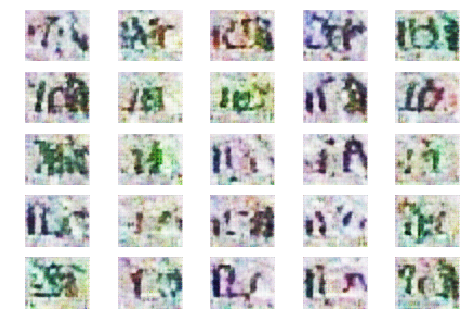

3951 [D loss: 1.002475] [G loss: 1.488625]
3952 [D loss: 1.003182] [G loss: 1.491627]
3953 [D loss: 1.002563] [G loss: 1.489231]
3954 [D loss: 1.005083] [G loss: 1.488191]
3955 [D loss: 1.003004] [G loss: 1.488131]
3956 [D loss: 1.003610] [G loss: 1.488328]
3957 [D loss: 1.003219] [G loss: 1.487980]
3958 [D loss: 1.004132] [G loss: 1.488907]
3959 [D loss: 1.004422] [G loss: 1.490176]
3960 [D loss: 1.002694] [G loss: 1.488155]
3961 [D loss: 1.002874] [G loss: 1.487329]
3962 [D loss: 1.004179] [G loss: 1.490591]
3963 [D loss: 1.002673] [G loss: 1.489170]
3964 [D loss: 1.003958] [G loss: 1.489545]
3965 [D loss: 1.003509] [G loss: 1.487697]
3966 [D loss: 1.003635] [G loss: 1.488394]
3967 [D loss: 1.004583] [G loss: 1.490893]
3968 [D loss: 1.003678] [G loss: 1.490191]
3969 [D loss: 1.003808] [G loss: 1.488444]
3970 [D loss: 1.002692] [G loss: 1.490530]
3971 [D loss: 1.003324] [G loss: 1.490797]
3972 [D loss: 1.002845] [G loss: 1.490766]
3973 [D loss: 1.003794] [G loss: 1.489978]
3974 [D los

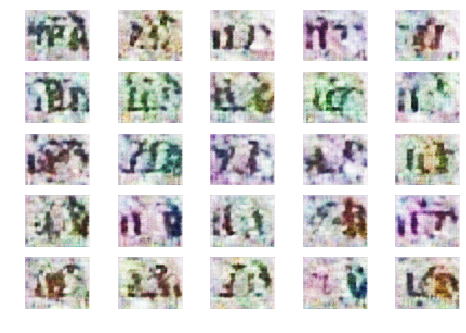

4001 [D loss: 1.003399] [G loss: 1.490891]
4002 [D loss: 1.002189] [G loss: 1.490495]
4003 [D loss: 1.005165] [G loss: 1.490354]
4004 [D loss: 1.003524] [G loss: 1.489682]
4005 [D loss: 1.004079] [G loss: 1.492395]
4006 [D loss: 1.003231] [G loss: 1.490575]
4007 [D loss: 1.004357] [G loss: 1.490720]
4008 [D loss: 1.001689] [G loss: 1.488995]
4009 [D loss: 1.001700] [G loss: 1.491358]
4010 [D loss: 1.002544] [G loss: 1.490467]
4011 [D loss: 1.001086] [G loss: 1.491048]
4012 [D loss: 1.002755] [G loss: 1.491318]
4013 [D loss: 1.003000] [G loss: 1.492613]
4014 [D loss: 1.004647] [G loss: 1.490800]
4015 [D loss: 1.002755] [G loss: 1.488056]
4016 [D loss: 1.004940] [G loss: 1.489528]
4017 [D loss: 1.002874] [G loss: 1.487536]
4018 [D loss: 1.000653] [G loss: 1.490312]
4019 [D loss: 1.004767] [G loss: 1.487663]
4020 [D loss: 1.003540] [G loss: 1.489544]
4021 [D loss: 1.001991] [G loss: 1.490175]
4022 [D loss: 1.003142] [G loss: 1.491522]
4023 [D loss: 1.004183] [G loss: 1.491001]
4024 [D los

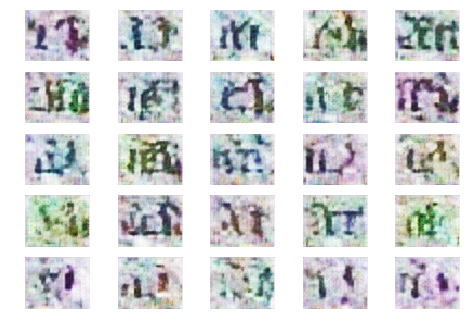

4051 [D loss: 1.003210] [G loss: 1.489864]
4052 [D loss: 1.002996] [G loss: 1.491294]
4053 [D loss: 1.002589] [G loss: 1.491080]
4054 [D loss: 1.003027] [G loss: 1.491013]
4055 [D loss: 1.004069] [G loss: 1.489403]
4056 [D loss: 1.004447] [G loss: 1.489546]
4057 [D loss: 1.003847] [G loss: 1.490794]
4058 [D loss: 1.002813] [G loss: 1.491259]
4059 [D loss: 1.003405] [G loss: 1.489642]
4060 [D loss: 1.004187] [G loss: 1.488675]
4061 [D loss: 1.004093] [G loss: 1.489080]
4062 [D loss: 1.003123] [G loss: 1.488541]
4063 [D loss: 1.003500] [G loss: 1.490413]
4064 [D loss: 1.002854] [G loss: 1.489874]
4065 [D loss: 1.003291] [G loss: 1.492274]
4066 [D loss: 1.003646] [G loss: 1.491198]
4067 [D loss: 1.004216] [G loss: 1.489709]
4068 [D loss: 1.002577] [G loss: 1.490351]
4069 [D loss: 1.004058] [G loss: 1.489412]
4070 [D loss: 1.003870] [G loss: 1.488880]
4071 [D loss: 1.001289] [G loss: 1.493455]
4072 [D loss: 1.001204] [G loss: 1.490800]
4073 [D loss: 1.001363] [G loss: 1.491811]
4074 [D los

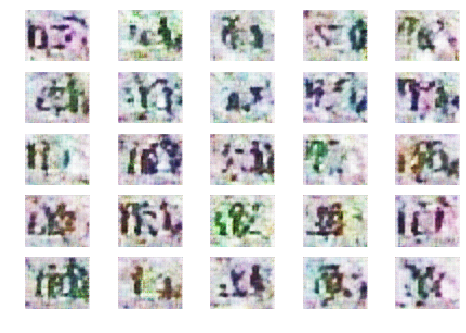

4101 [D loss: 1.000071] [G loss: 1.492039]
4102 [D loss: 1.001831] [G loss: 1.490307]
4103 [D loss: 1.002408] [G loss: 1.491402]
4104 [D loss: 1.002755] [G loss: 1.490088]
4105 [D loss: 1.004865] [G loss: 1.489025]
4106 [D loss: 1.002061] [G loss: 1.491530]
4107 [D loss: 1.002414] [G loss: 1.489263]
4108 [D loss: 1.003101] [G loss: 1.490866]
4109 [D loss: 1.003863] [G loss: 1.490479]
4110 [D loss: 1.001561] [G loss: 1.489308]
4111 [D loss: 1.001550] [G loss: 1.490939]
4112 [D loss: 1.005713] [G loss: 1.490103]
4113 [D loss: 1.004843] [G loss: 1.490063]
4114 [D loss: 1.003607] [G loss: 1.490568]
4115 [D loss: 1.001803] [G loss: 1.493055]
4116 [D loss: 1.003869] [G loss: 1.490892]
4117 [D loss: 1.001561] [G loss: 1.490687]
4118 [D loss: 1.002562] [G loss: 1.490118]
4119 [D loss: 1.003250] [G loss: 1.489967]
4120 [D loss: 1.000730] [G loss: 1.489855]
4121 [D loss: 1.001823] [G loss: 1.490419]
4122 [D loss: 1.003612] [G loss: 1.492606]
4123 [D loss: 1.002438] [G loss: 1.489416]
4124 [D los

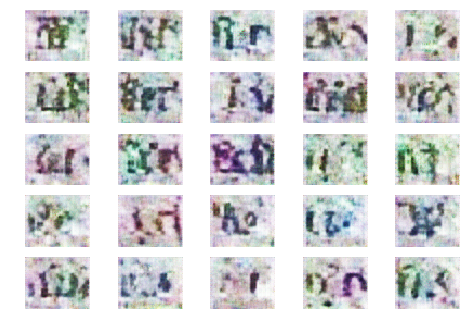

4151 [D loss: 1.000811] [G loss: 1.492089]
4152 [D loss: 1.004171] [G loss: 1.490023]
4153 [D loss: 1.001921] [G loss: 1.492295]
4154 [D loss: 1.002464] [G loss: 1.491446]
4155 [D loss: 1.003054] [G loss: 1.491251]
4156 [D loss: 1.003636] [G loss: 1.492848]
4157 [D loss: 1.001241] [G loss: 1.490717]
4158 [D loss: 1.001018] [G loss: 1.491275]
4159 [D loss: 1.003607] [G loss: 1.491297]
4160 [D loss: 1.002718] [G loss: 1.490167]
4161 [D loss: 1.002798] [G loss: 1.488414]
4162 [D loss: 1.003535] [G loss: 1.492721]
4163 [D loss: 1.003456] [G loss: 1.490675]
4164 [D loss: 1.003704] [G loss: 1.491265]
4165 [D loss: 1.002905] [G loss: 1.491271]
4166 [D loss: 1.002190] [G loss: 1.491362]
4167 [D loss: 1.002640] [G loss: 1.489553]
4168 [D loss: 1.001613] [G loss: 1.490011]
4169 [D loss: 1.005296] [G loss: 1.488080]
4170 [D loss: 1.002064] [G loss: 1.494060]
4171 [D loss: 1.000916] [G loss: 1.493801]
4172 [D loss: 1.003498] [G loss: 1.493567]
4173 [D loss: 1.002627] [G loss: 1.490676]
4174 [D los

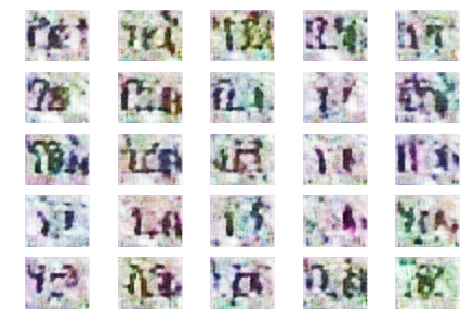

4201 [D loss: 1.001650] [G loss: 1.489574]
4202 [D loss: 1.003355] [G loss: 1.490948]
4203 [D loss: 1.002586] [G loss: 1.489641]
4204 [D loss: 1.001226] [G loss: 1.490006]
4205 [D loss: 1.000616] [G loss: 1.492373]
4206 [D loss: 1.002986] [G loss: 1.491243]
4207 [D loss: 1.000947] [G loss: 1.491747]
4208 [D loss: 1.003773] [G loss: 1.492485]
4209 [D loss: 1.003883] [G loss: 1.491223]
4210 [D loss: 1.002871] [G loss: 1.493149]
4211 [D loss: 1.000328] [G loss: 1.491019]
4212 [D loss: 1.003496] [G loss: 1.491709]
4213 [D loss: 1.002840] [G loss: 1.491463]
4214 [D loss: 1.001655] [G loss: 1.492458]
4215 [D loss: 1.001236] [G loss: 1.490610]
4216 [D loss: 1.001619] [G loss: 1.492765]
4217 [D loss: 1.001165] [G loss: 1.491551]
4218 [D loss: 1.002034] [G loss: 1.490860]
4219 [D loss: 1.002593] [G loss: 1.493331]
4220 [D loss: 1.002176] [G loss: 1.490473]
4221 [D loss: 1.000638] [G loss: 1.491018]
4222 [D loss: 1.003921] [G loss: 1.492033]
4223 [D loss: 1.000981] [G loss: 1.491539]
4224 [D los

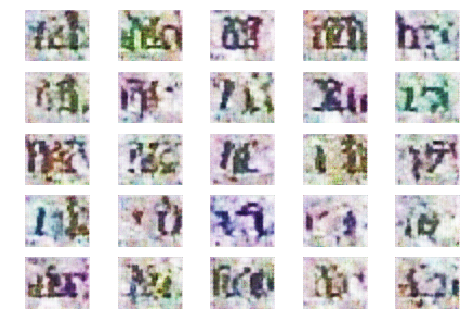

4251 [D loss: 1.002780] [G loss: 1.490832]
4252 [D loss: 1.003236] [G loss: 1.491078]
4253 [D loss: 1.001767] [G loss: 1.490572]
4254 [D loss: 1.003178] [G loss: 1.493117]
4255 [D loss: 1.003027] [G loss: 1.488678]
4256 [D loss: 1.001361] [G loss: 1.490266]
4257 [D loss: 1.003313] [G loss: 1.491456]
4258 [D loss: 1.001494] [G loss: 1.492262]
4259 [D loss: 1.001559] [G loss: 1.490756]
4260 [D loss: 1.003680] [G loss: 1.491844]
4261 [D loss: 1.002305] [G loss: 1.491639]
4262 [D loss: 1.003296] [G loss: 1.489360]
4263 [D loss: 1.004241] [G loss: 1.490744]
4264 [D loss: 1.003776] [G loss: 1.489403]
4265 [D loss: 1.002260] [G loss: 1.491924]
4266 [D loss: 1.002122] [G loss: 1.490860]
4267 [D loss: 1.002600] [G loss: 1.489186]
4268 [D loss: 1.002113] [G loss: 1.489677]
4269 [D loss: 1.002010] [G loss: 1.491768]
4270 [D loss: 1.003066] [G loss: 1.490760]
4271 [D loss: 1.000803] [G loss: 1.492016]
4272 [D loss: 1.000291] [G loss: 1.491250]
4273 [D loss: 1.001850] [G loss: 1.489345]
4274 [D los

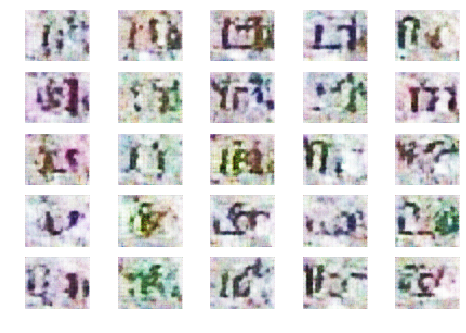

4301 [D loss: 1.003749] [G loss: 1.493180]
4302 [D loss: 1.000921] [G loss: 1.490686]
4303 [D loss: 1.001925] [G loss: 1.492333]
4304 [D loss: 1.003442] [G loss: 1.489351]
4305 [D loss: 1.002578] [G loss: 1.490864]
4306 [D loss: 1.001871] [G loss: 1.492585]
4307 [D loss: 1.003105] [G loss: 1.490427]
4308 [D loss: 1.001329] [G loss: 1.489717]
4309 [D loss: 1.001998] [G loss: 1.489282]
4310 [D loss: 1.002600] [G loss: 1.489171]
4311 [D loss: 1.000997] [G loss: 1.489968]
4312 [D loss: 1.003206] [G loss: 1.489637]
4313 [D loss: 1.005033] [G loss: 1.490088]
4314 [D loss: 1.002523] [G loss: 1.491589]
4315 [D loss: 1.001945] [G loss: 1.492414]
4316 [D loss: 1.003346] [G loss: 1.492493]
4317 [D loss: 1.000144] [G loss: 1.491563]
4318 [D loss: 1.002628] [G loss: 1.489740]
4319 [D loss: 1.001878] [G loss: 1.488850]
4320 [D loss: 1.002079] [G loss: 1.491598]
4321 [D loss: 1.003304] [G loss: 1.493430]
4322 [D loss: 1.001666] [G loss: 1.488954]
4323 [D loss: 1.003303] [G loss: 1.489907]
4324 [D los

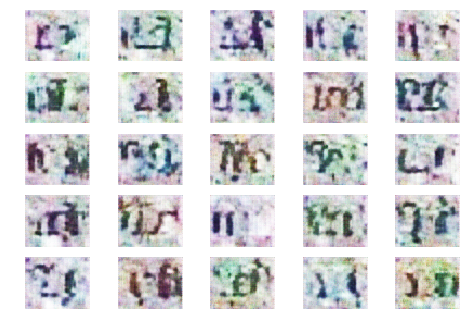

4351 [D loss: 1.002874] [G loss: 1.490813]
4352 [D loss: 1.002492] [G loss: 1.491844]
4353 [D loss: 1.002563] [G loss: 1.491070]
4354 [D loss: 1.002110] [G loss: 1.494022]
4355 [D loss: 1.002657] [G loss: 1.489809]
4356 [D loss: 1.002587] [G loss: 1.491104]
4357 [D loss: 1.003039] [G loss: 1.491282]
4358 [D loss: 1.002358] [G loss: 1.490885]
4359 [D loss: 1.003132] [G loss: 1.490190]
4360 [D loss: 1.003609] [G loss: 1.491894]
4361 [D loss: 1.002454] [G loss: 1.492766]
4362 [D loss: 1.002091] [G loss: 1.491331]
4363 [D loss: 1.002222] [G loss: 1.492362]
4364 [D loss: 1.003780] [G loss: 1.490035]
4365 [D loss: 1.000988] [G loss: 1.490574]
4366 [D loss: 1.003075] [G loss: 1.491377]
4367 [D loss: 1.003003] [G loss: 1.491455]
4368 [D loss: 1.002542] [G loss: 1.490562]
4369 [D loss: 1.002475] [G loss: 1.490165]
4370 [D loss: 1.001925] [G loss: 1.490589]
4371 [D loss: 1.001823] [G loss: 1.489382]
4372 [D loss: 1.002367] [G loss: 1.492668]
4373 [D loss: 1.002724] [G loss: 1.489950]
4374 [D los

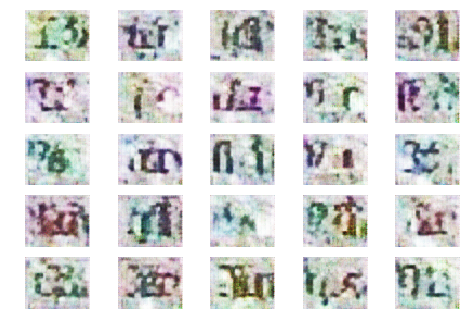

4401 [D loss: 1.002754] [G loss: 1.490926]
4402 [D loss: 1.003658] [G loss: 1.491566]
4403 [D loss: 1.000172] [G loss: 1.490384]
4404 [D loss: 1.003427] [G loss: 1.489799]
4405 [D loss: 1.001792] [G loss: 1.488543]
4406 [D loss: 1.001690] [G loss: 1.490281]
4407 [D loss: 1.003106] [G loss: 1.490563]
4408 [D loss: 1.001660] [G loss: 1.490827]
4409 [D loss: 0.998907] [G loss: 1.490655]
4410 [D loss: 1.002161] [G loss: 1.491771]
4411 [D loss: 1.001478] [G loss: 1.490827]
4412 [D loss: 1.002906] [G loss: 1.489006]
4413 [D loss: 1.002411] [G loss: 1.491362]
4414 [D loss: 1.001574] [G loss: 1.491296]
4415 [D loss: 1.004283] [G loss: 1.490623]
4416 [D loss: 1.002523] [G loss: 1.489242]
4417 [D loss: 1.002387] [G loss: 1.489346]
4418 [D loss: 1.002322] [G loss: 1.492624]
4419 [D loss: 1.002571] [G loss: 1.490306]
4420 [D loss: 1.002495] [G loss: 1.491101]
4421 [D loss: 1.002646] [G loss: 1.491573]
4422 [D loss: 1.003396] [G loss: 1.490476]
4423 [D loss: 1.000598] [G loss: 1.489467]
4424 [D los

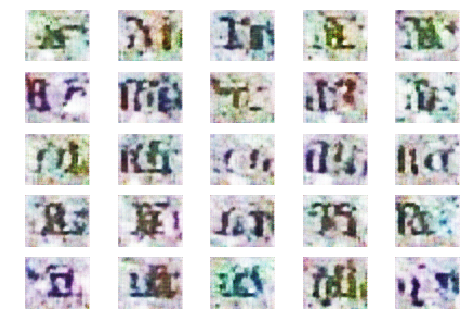

4451 [D loss: 1.001263] [G loss: 1.489784]
4452 [D loss: 1.001970] [G loss: 1.490454]
4453 [D loss: 1.002292] [G loss: 1.491280]
4454 [D loss: 1.001715] [G loss: 1.489278]
4455 [D loss: 1.003777] [G loss: 1.490519]
4456 [D loss: 1.002170] [G loss: 1.492489]
4457 [D loss: 1.002421] [G loss: 1.492969]
4458 [D loss: 1.002609] [G loss: 1.493181]
4459 [D loss: 1.002008] [G loss: 1.489069]
4460 [D loss: 1.001535] [G loss: 1.488784]
4461 [D loss: 1.001440] [G loss: 1.492636]
4462 [D loss: 1.003066] [G loss: 1.488881]
4463 [D loss: 1.002179] [G loss: 1.490244]
4464 [D loss: 1.004857] [G loss: 1.489601]
4465 [D loss: 1.001914] [G loss: 1.490975]
4466 [D loss: 1.002467] [G loss: 1.491624]
4467 [D loss: 1.002295] [G loss: 1.491056]
4468 [D loss: 1.002303] [G loss: 1.491553]
4469 [D loss: 1.002278] [G loss: 1.491923]
4470 [D loss: 1.003226] [G loss: 1.491048]
4471 [D loss: 1.002883] [G loss: 1.492703]
4472 [D loss: 1.001828] [G loss: 1.492927]
4473 [D loss: 1.001203] [G loss: 1.489626]
4474 [D los

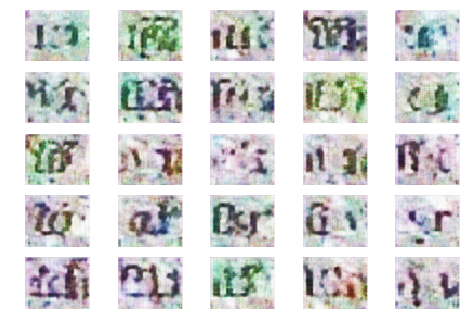

4501 [D loss: 1.003010] [G loss: 1.492879]
4502 [D loss: 1.001643] [G loss: 1.492300]
4503 [D loss: 1.002535] [G loss: 1.490805]
4504 [D loss: 1.001282] [G loss: 1.489776]
4505 [D loss: 1.002432] [G loss: 1.491588]
4506 [D loss: 1.002700] [G loss: 1.491354]
4507 [D loss: 1.001622] [G loss: 1.490758]
4508 [D loss: 1.003923] [G loss: 1.491164]
4509 [D loss: 1.004430] [G loss: 1.491757]
4510 [D loss: 1.003561] [G loss: 1.491254]
4511 [D loss: 1.001937] [G loss: 1.489921]
4512 [D loss: 1.002374] [G loss: 1.489621]
4513 [D loss: 1.000792] [G loss: 1.488570]
4514 [D loss: 1.002305] [G loss: 1.490047]
4515 [D loss: 1.002027] [G loss: 1.490484]
4516 [D loss: 1.002250] [G loss: 1.489421]
4517 [D loss: 1.002388] [G loss: 1.488640]
4518 [D loss: 1.002573] [G loss: 1.489527]
4519 [D loss: 1.002516] [G loss: 1.489991]
4520 [D loss: 1.002330] [G loss: 1.489100]
4521 [D loss: 1.002237] [G loss: 1.490068]
4522 [D loss: 1.002913] [G loss: 1.489919]
4523 [D loss: 1.002590] [G loss: 1.489694]
4524 [D los

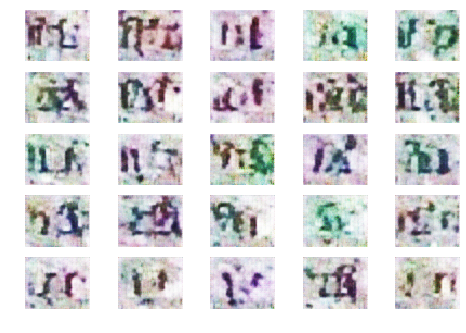

4551 [D loss: 1.001876] [G loss: 1.492267]
4552 [D loss: 1.001025] [G loss: 1.491544]
4553 [D loss: 1.002178] [G loss: 1.488084]
4554 [D loss: 1.002987] [G loss: 1.492250]
4555 [D loss: 1.002818] [G loss: 1.491833]
4556 [D loss: 1.001463] [G loss: 1.490384]
4557 [D loss: 1.003618] [G loss: 1.489717]
4558 [D loss: 1.002298] [G loss: 1.488637]
4559 [D loss: 1.001709] [G loss: 1.489655]
4560 [D loss: 1.003502] [G loss: 1.490532]
4561 [D loss: 1.002373] [G loss: 1.493018]
4562 [D loss: 1.001586] [G loss: 1.490592]
4563 [D loss: 1.001550] [G loss: 1.493410]
4564 [D loss: 1.002242] [G loss: 1.492389]
4565 [D loss: 1.001928] [G loss: 1.490566]
4566 [D loss: 1.002184] [G loss: 1.489116]
4567 [D loss: 1.001153] [G loss: 1.492509]
4568 [D loss: 1.001552] [G loss: 1.490781]
4569 [D loss: 1.001711] [G loss: 1.490677]
4570 [D loss: 1.002347] [G loss: 1.493249]
4571 [D loss: 1.002274] [G loss: 1.491214]
4572 [D loss: 1.002238] [G loss: 1.490812]
4573 [D loss: 1.002312] [G loss: 1.489601]
4574 [D los

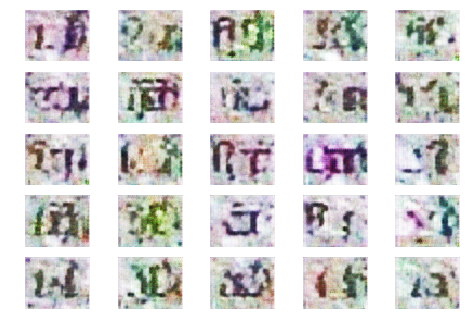

4601 [D loss: 1.002128] [G loss: 1.488994]
4602 [D loss: 1.001377] [G loss: 1.489907]
4603 [D loss: 1.003221] [G loss: 1.491958]
4604 [D loss: 1.002712] [G loss: 1.488466]
4605 [D loss: 1.000588] [G loss: 1.489464]
4606 [D loss: 1.001477] [G loss: 1.490508]
4607 [D loss: 1.001318] [G loss: 1.489294]
4608 [D loss: 1.003590] [G loss: 1.489939]
4609 [D loss: 1.000635] [G loss: 1.493613]
4610 [D loss: 1.002845] [G loss: 1.490817]
4611 [D loss: 1.001554] [G loss: 1.488582]
4612 [D loss: 1.001212] [G loss: 1.490573]
4613 [D loss: 1.001728] [G loss: 1.490136]
4614 [D loss: 1.000945] [G loss: 1.490194]
4615 [D loss: 1.001226] [G loss: 1.490947]
4616 [D loss: 1.002411] [G loss: 1.494038]
4617 [D loss: 1.003269] [G loss: 1.491900]
4618 [D loss: 1.001696] [G loss: 1.490080]
4619 [D loss: 1.002413] [G loss: 1.488921]
4620 [D loss: 1.001220] [G loss: 1.490306]
4621 [D loss: 1.003306] [G loss: 1.491082]
4622 [D loss: 1.003819] [G loss: 1.486809]
4623 [D loss: 1.003355] [G loss: 1.487588]
4624 [D los

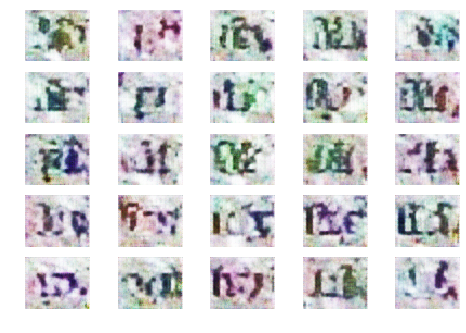

4651 [D loss: 1.003589] [G loss: 1.491989]
4652 [D loss: 1.001301] [G loss: 1.489693]
4653 [D loss: 1.002773] [G loss: 1.489747]
4654 [D loss: 1.001044] [G loss: 1.491379]
4655 [D loss: 1.000818] [G loss: 1.489092]
4656 [D loss: 1.001882] [G loss: 1.489368]
4657 [D loss: 1.000747] [G loss: 1.491428]
4658 [D loss: 1.003275] [G loss: 1.490539]
4659 [D loss: 1.002027] [G loss: 1.490200]
4660 [D loss: 1.000567] [G loss: 1.493147]
4661 [D loss: 1.001711] [G loss: 1.489774]
4662 [D loss: 1.001618] [G loss: 1.490595]
4663 [D loss: 1.001794] [G loss: 1.490610]
4664 [D loss: 1.004005] [G loss: 1.491026]
4665 [D loss: 1.001956] [G loss: 1.494302]
4666 [D loss: 1.001226] [G loss: 1.491541]
4667 [D loss: 1.002153] [G loss: 1.491651]
4668 [D loss: 1.002017] [G loss: 1.489909]
4669 [D loss: 1.002630] [G loss: 1.492380]
4670 [D loss: 1.002853] [G loss: 1.489639]
4671 [D loss: 1.000729] [G loss: 1.490602]
4672 [D loss: 1.001241] [G loss: 1.488918]
4673 [D loss: 1.003287] [G loss: 1.486691]
4674 [D los

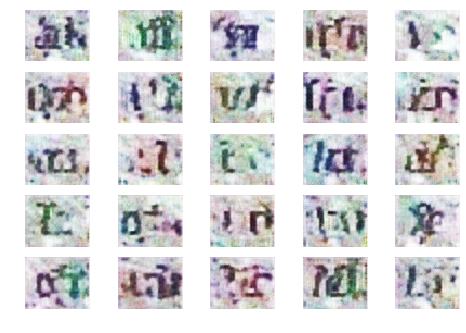

4701 [D loss: 1.001081] [G loss: 1.490977]
4702 [D loss: 1.000656] [G loss: 1.492808]
4703 [D loss: 1.002417] [G loss: 1.491001]
4704 [D loss: 1.001977] [G loss: 1.490627]
4705 [D loss: 1.001852] [G loss: 1.486902]
4706 [D loss: 1.001329] [G loss: 1.490504]
4707 [D loss: 1.002817] [G loss: 1.491210]
4708 [D loss: 1.001449] [G loss: 1.490846]
4709 [D loss: 1.003523] [G loss: 1.491271]
4710 [D loss: 1.002290] [G loss: 1.490024]
4711 [D loss: 1.001487] [G loss: 1.490336]
4712 [D loss: 1.000407] [G loss: 1.491160]
4713 [D loss: 1.001406] [G loss: 1.489525]
4714 [D loss: 1.001324] [G loss: 1.492064]
4715 [D loss: 1.002294] [G loss: 1.490331]
4716 [D loss: 1.001616] [G loss: 1.489766]
4717 [D loss: 1.003046] [G loss: 1.489841]
4718 [D loss: 1.002491] [G loss: 1.489065]
4719 [D loss: 1.000775] [G loss: 1.492040]
4720 [D loss: 1.003719] [G loss: 1.491258]
4721 [D loss: 1.000144] [G loss: 1.493391]
4722 [D loss: 1.003139] [G loss: 1.489788]
4723 [D loss: 1.002255] [G loss: 1.489366]
4724 [D los

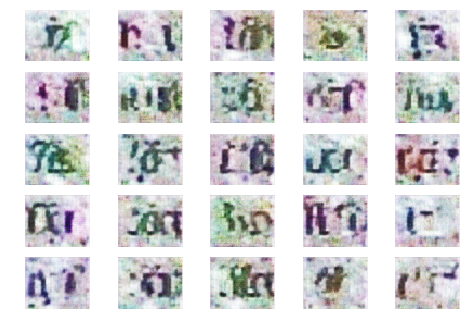

4751 [D loss: 1.001442] [G loss: 1.493131]
4752 [D loss: 1.001464] [G loss: 1.491287]
4753 [D loss: 1.002513] [G loss: 1.490767]
4754 [D loss: 1.002828] [G loss: 1.492855]
4755 [D loss: 1.001388] [G loss: 1.493375]
4756 [D loss: 1.002227] [G loss: 1.491853]
4757 [D loss: 1.000476] [G loss: 1.489839]
4758 [D loss: 1.002235] [G loss: 1.491956]
4759 [D loss: 1.001884] [G loss: 1.492465]
4760 [D loss: 1.001372] [G loss: 1.488754]
4761 [D loss: 1.002520] [G loss: 1.493004]
4762 [D loss: 1.001379] [G loss: 1.493456]
4763 [D loss: 1.002838] [G loss: 1.492288]
4764 [D loss: 1.001634] [G loss: 1.492311]
4765 [D loss: 1.002318] [G loss: 1.488797]
4766 [D loss: 1.001215] [G loss: 1.489507]
4767 [D loss: 1.001238] [G loss: 1.489572]
4768 [D loss: 1.000575] [G loss: 1.489966]
4769 [D loss: 1.001916] [G loss: 1.491424]
4770 [D loss: 1.002346] [G loss: 1.492851]
4771 [D loss: 1.001396] [G loss: 1.490521]
4772 [D loss: 1.002058] [G loss: 1.490905]
4773 [D loss: 1.001104] [G loss: 1.492189]
4774 [D los

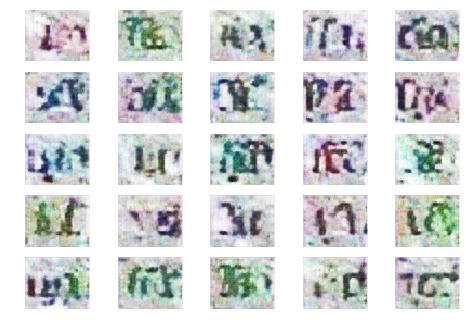

4801 [D loss: 1.002599] [G loss: 1.491943]
4802 [D loss: 1.001206] [G loss: 1.491051]
4803 [D loss: 1.001268] [G loss: 1.491180]
4804 [D loss: 1.001148] [G loss: 1.490108]
4805 [D loss: 0.999777] [G loss: 1.492859]
4806 [D loss: 1.001646] [G loss: 1.491041]
4807 [D loss: 1.000882] [G loss: 1.490736]
4808 [D loss: 1.002004] [G loss: 1.492829]
4809 [D loss: 1.003456] [G loss: 1.493074]
4810 [D loss: 1.002784] [G loss: 1.493008]
4811 [D loss: 1.001962] [G loss: 1.493150]
4812 [D loss: 1.001521] [G loss: 1.492799]
4813 [D loss: 1.001455] [G loss: 1.492389]
4814 [D loss: 1.002438] [G loss: 1.491057]
4815 [D loss: 1.000991] [G loss: 1.493308]
4816 [D loss: 1.001572] [G loss: 1.491674]
4817 [D loss: 1.003446] [G loss: 1.491451]
4818 [D loss: 1.003172] [G loss: 1.491949]
4819 [D loss: 1.000970] [G loss: 1.493140]
4820 [D loss: 1.002422] [G loss: 1.491926]
4821 [D loss: 1.000978] [G loss: 1.493452]
4822 [D loss: 1.002386] [G loss: 1.493020]
4823 [D loss: 0.999687] [G loss: 1.492585]
4824 [D los

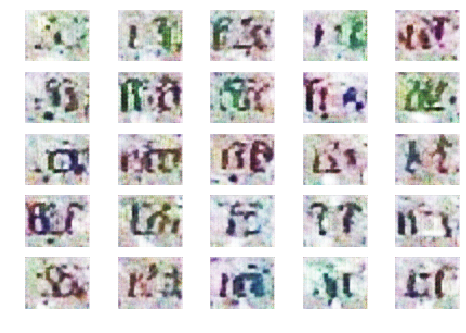

4851 [D loss: 1.002820] [G loss: 1.490440]
4852 [D loss: 1.001902] [G loss: 1.492595]
4853 [D loss: 1.000413] [G loss: 1.491902]
4854 [D loss: 1.000409] [G loss: 1.490617]
4855 [D loss: 1.001798] [G loss: 1.491142]
4856 [D loss: 0.999922] [G loss: 1.488869]
4857 [D loss: 1.002461] [G loss: 1.490871]
4858 [D loss: 1.002879] [G loss: 1.489894]
4859 [D loss: 1.002314] [G loss: 1.491601]
4860 [D loss: 1.000910] [G loss: 1.490624]
4861 [D loss: 1.002656] [G loss: 1.490295]
4862 [D loss: 1.001600] [G loss: 1.489314]
4863 [D loss: 1.002054] [G loss: 1.489803]
4864 [D loss: 1.002682] [G loss: 1.489989]
4865 [D loss: 1.001683] [G loss: 1.490773]
4866 [D loss: 1.002227] [G loss: 1.491909]
4867 [D loss: 1.002695] [G loss: 1.492295]
4868 [D loss: 1.000996] [G loss: 1.492308]
4869 [D loss: 1.003084] [G loss: 1.491485]
4870 [D loss: 1.002829] [G loss: 1.492277]
4871 [D loss: 1.001610] [G loss: 1.492383]
4872 [D loss: 1.001348] [G loss: 1.492813]
4873 [D loss: 1.000163] [G loss: 1.491468]
4874 [D los

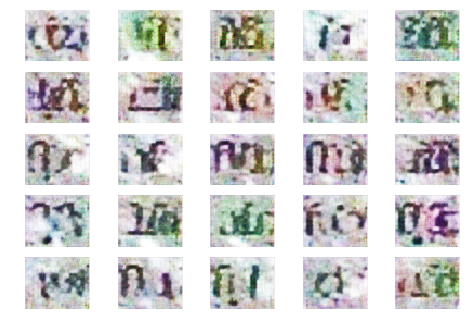

4901 [D loss: 1.001529] [G loss: 1.492793]
4902 [D loss: 1.001148] [G loss: 1.490881]
4903 [D loss: 1.002332] [G loss: 1.492322]
4904 [D loss: 1.001036] [G loss: 1.493198]
4905 [D loss: 1.002091] [G loss: 1.493339]
4906 [D loss: 1.002351] [G loss: 1.492225]
4907 [D loss: 1.002148] [G loss: 1.491833]
4908 [D loss: 1.003491] [G loss: 1.492745]
4909 [D loss: 1.002824] [G loss: 1.491586]
4910 [D loss: 1.000688] [G loss: 1.491393]
4911 [D loss: 1.001703] [G loss: 1.488658]
4912 [D loss: 1.001351] [G loss: 1.489434]
4913 [D loss: 1.001772] [G loss: 1.490572]
4914 [D loss: 1.002989] [G loss: 1.492322]
4915 [D loss: 1.002839] [G loss: 1.491998]
4916 [D loss: 1.001642] [G loss: 1.492252]
4917 [D loss: 1.000995] [G loss: 1.493086]
4918 [D loss: 1.001860] [G loss: 1.491812]
4919 [D loss: 1.001973] [G loss: 1.490448]
4920 [D loss: 1.003027] [G loss: 1.489856]
4921 [D loss: 1.002292] [G loss: 1.491735]
4922 [D loss: 1.002648] [G loss: 1.491515]
4923 [D loss: 1.001690] [G loss: 1.492667]
4924 [D los

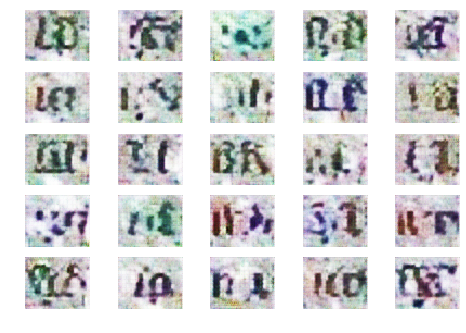

4951 [D loss: 1.002183] [G loss: 1.492098]
4952 [D loss: 1.000938] [G loss: 1.493942]
4953 [D loss: 1.002043] [G loss: 1.491873]
4954 [D loss: 1.001474] [G loss: 1.492103]
4955 [D loss: 1.002121] [G loss: 1.492566]
4956 [D loss: 1.002128] [G loss: 1.491438]
4957 [D loss: 1.002447] [G loss: 1.490945]
4958 [D loss: 1.001405] [G loss: 1.490330]
4959 [D loss: 1.002670] [G loss: 1.491801]
4960 [D loss: 1.002516] [G loss: 1.491457]
4961 [D loss: 1.001877] [G loss: 1.490592]
4962 [D loss: 1.001343] [G loss: 1.494547]
4963 [D loss: 1.001399] [G loss: 1.493272]
4964 [D loss: 1.003481] [G loss: 1.493079]
4965 [D loss: 1.001057] [G loss: 1.490587]
4966 [D loss: 1.002386] [G loss: 1.491447]
4967 [D loss: 1.001811] [G loss: 1.490997]
4968 [D loss: 1.002189] [G loss: 1.492017]
4969 [D loss: 1.002445] [G loss: 1.491462]
4970 [D loss: 0.999763] [G loss: 1.494560]
4971 [D loss: 1.001316] [G loss: 1.492587]
4972 [D loss: 1.002224] [G loss: 1.493743]
4973 [D loss: 1.001750] [G loss: 1.491820]
4974 [D los

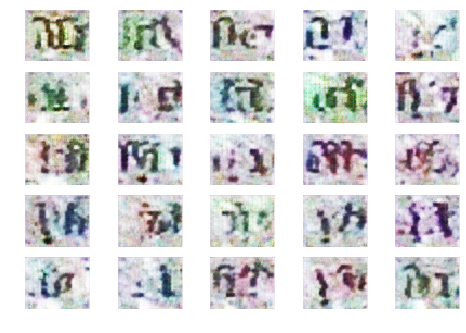

5001 [D loss: 1.002512] [G loss: 1.491303]
5002 [D loss: 1.001278] [G loss: 1.492113]
5003 [D loss: 1.001267] [G loss: 1.491312]
5004 [D loss: 1.002619] [G loss: 1.492327]
5005 [D loss: 1.001318] [G loss: 1.492516]
5006 [D loss: 1.002158] [G loss: 1.491632]
5007 [D loss: 1.001492] [G loss: 1.492404]
5008 [D loss: 1.000420] [G loss: 1.492761]
5009 [D loss: 1.002386] [G loss: 1.492788]
5010 [D loss: 1.002097] [G loss: 1.490958]
5011 [D loss: 1.002845] [G loss: 1.490731]
5012 [D loss: 1.002186] [G loss: 1.492777]
5013 [D loss: 1.001848] [G loss: 1.493401]
5014 [D loss: 1.002155] [G loss: 1.492852]
5015 [D loss: 0.999218] [G loss: 1.494187]
5016 [D loss: 1.001738] [G loss: 1.493426]
5017 [D loss: 1.001468] [G loss: 1.492621]
5018 [D loss: 1.001296] [G loss: 1.490421]
5019 [D loss: 1.001739] [G loss: 1.492239]
5020 [D loss: 1.002477] [G loss: 1.492139]
5021 [D loss: 1.002608] [G loss: 1.491864]
5022 [D loss: 1.001210] [G loss: 1.493181]
5023 [D loss: 1.001774] [G loss: 1.491155]
5024 [D los

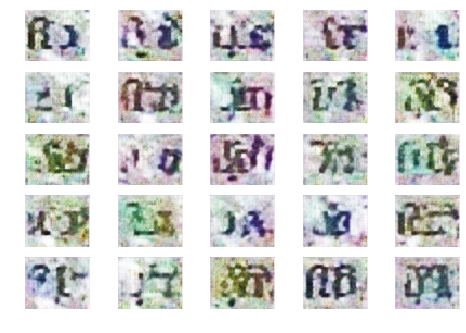

5051 [D loss: 1.001230] [G loss: 1.490851]
5052 [D loss: 1.002767] [G loss: 1.493898]
5053 [D loss: 1.001534] [G loss: 1.493330]
5054 [D loss: 1.001794] [G loss: 1.492108]
5055 [D loss: 1.000517] [G loss: 1.492927]
5056 [D loss: 1.002342] [G loss: 1.492743]
5057 [D loss: 1.001012] [G loss: 1.490896]
5058 [D loss: 1.001812] [G loss: 1.492164]
5059 [D loss: 1.002357] [G loss: 1.492462]
5060 [D loss: 1.001399] [G loss: 1.492959]
5061 [D loss: 1.001674] [G loss: 1.492362]
5062 [D loss: 1.001765] [G loss: 1.490612]
5063 [D loss: 1.001280] [G loss: 1.493111]
5064 [D loss: 1.001809] [G loss: 1.491504]
5065 [D loss: 1.001165] [G loss: 1.492259]
5066 [D loss: 1.001857] [G loss: 1.492070]
5067 [D loss: 1.002238] [G loss: 1.489778]
5068 [D loss: 1.002175] [G loss: 1.491794]
5069 [D loss: 1.002540] [G loss: 1.491390]
5070 [D loss: 1.000779] [G loss: 1.490860]
5071 [D loss: 1.000885] [G loss: 1.491923]
5072 [D loss: 1.002073] [G loss: 1.490717]
5073 [D loss: 1.000535] [G loss: 1.492426]
5074 [D los

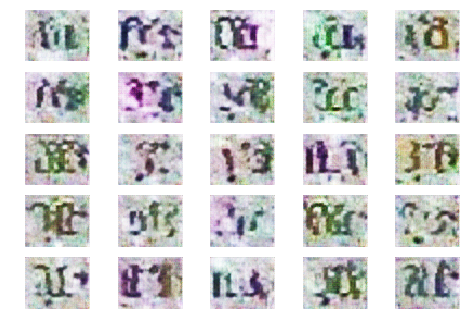

5101 [D loss: 1.002892] [G loss: 1.492977]
5102 [D loss: 1.002193] [G loss: 1.492379]
5103 [D loss: 1.001631] [G loss: 1.492439]
5104 [D loss: 1.001407] [G loss: 1.492084]
5105 [D loss: 1.001076] [G loss: 1.494336]
5106 [D loss: 1.001545] [G loss: 1.494272]
5107 [D loss: 1.001176] [G loss: 1.493458]
5108 [D loss: 1.002457] [G loss: 1.491355]
5109 [D loss: 1.002266] [G loss: 1.492941]
5110 [D loss: 1.000860] [G loss: 1.491640]
5111 [D loss: 1.002146] [G loss: 1.490927]
5112 [D loss: 1.000748] [G loss: 1.491567]
5113 [D loss: 1.000899] [G loss: 1.493397]
5114 [D loss: 1.001186] [G loss: 1.493411]
5115 [D loss: 1.000676] [G loss: 1.492313]
5116 [D loss: 1.001445] [G loss: 1.492908]
5117 [D loss: 1.001897] [G loss: 1.492696]
5118 [D loss: 1.002095] [G loss: 1.492771]
5119 [D loss: 1.001736] [G loss: 1.493331]
5120 [D loss: 1.001600] [G loss: 1.491826]
5121 [D loss: 1.002017] [G loss: 1.492556]
5122 [D loss: 1.000897] [G loss: 1.492104]
5123 [D loss: 1.002126] [G loss: 1.493719]
5124 [D los

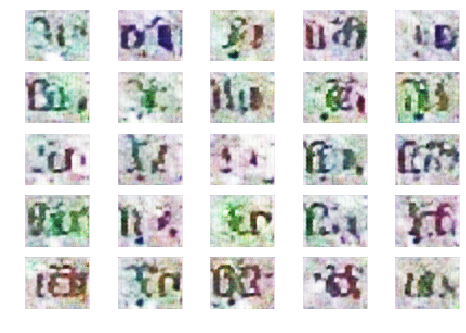

5151 [D loss: 1.002467] [G loss: 1.493986]
5152 [D loss: 1.001396] [G loss: 1.493203]
5153 [D loss: 1.000902] [G loss: 1.493839]
5154 [D loss: 1.002103] [G loss: 1.492583]
5155 [D loss: 1.001313] [G loss: 1.492208]
5156 [D loss: 1.001287] [G loss: 1.493153]
5157 [D loss: 1.001803] [G loss: 1.491315]
5158 [D loss: 1.002360] [G loss: 1.494257]
5159 [D loss: 1.001412] [G loss: 1.492612]
5160 [D loss: 1.001371] [G loss: 1.491261]
5161 [D loss: 1.001486] [G loss: 1.492585]
5162 [D loss: 1.002674] [G loss: 1.492933]
5163 [D loss: 1.000789] [G loss: 1.492817]
5164 [D loss: 1.003105] [G loss: 1.493329]
5165 [D loss: 1.002908] [G loss: 1.491944]
5166 [D loss: 1.002495] [G loss: 1.490545]
5167 [D loss: 1.002376] [G loss: 1.491668]
5168 [D loss: 1.001934] [G loss: 1.492759]
5169 [D loss: 1.002203] [G loss: 1.491521]
5170 [D loss: 1.002780] [G loss: 1.493223]
5171 [D loss: 1.002268] [G loss: 1.493862]
5172 [D loss: 1.002020] [G loss: 1.493720]
5173 [D loss: 1.002255] [G loss: 1.494167]
5174 [D los

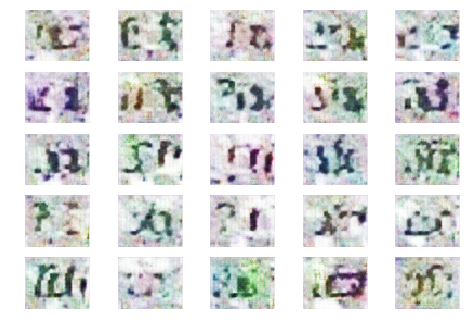

5201 [D loss: 1.000764] [G loss: 1.494945]
5202 [D loss: 1.003033] [G loss: 1.493611]
5203 [D loss: 1.002279] [G loss: 1.492770]
5204 [D loss: 1.001807] [G loss: 1.493147]
5205 [D loss: 1.000667] [G loss: 1.492668]
5206 [D loss: 1.003282] [G loss: 1.491905]
5207 [D loss: 1.001582] [G loss: 1.494064]
5208 [D loss: 1.002736] [G loss: 1.496549]
5209 [D loss: 1.000925] [G loss: 1.493951]
5210 [D loss: 1.002217] [G loss: 1.492251]
5211 [D loss: 1.001029] [G loss: 1.493326]
5212 [D loss: 1.001601] [G loss: 1.492734]
5213 [D loss: 1.002527] [G loss: 1.494801]
5214 [D loss: 1.001498] [G loss: 1.490884]
5215 [D loss: 1.002344] [G loss: 1.492057]
5216 [D loss: 1.001821] [G loss: 1.494309]
5217 [D loss: 1.001789] [G loss: 1.492742]
5218 [D loss: 1.002099] [G loss: 1.492355]
5219 [D loss: 1.003234] [G loss: 1.492521]
5220 [D loss: 1.002226] [G loss: 1.492746]
5221 [D loss: 1.001581] [G loss: 1.491440]
5222 [D loss: 1.002140] [G loss: 1.493288]
5223 [D loss: 1.002136] [G loss: 1.492204]
5224 [D los

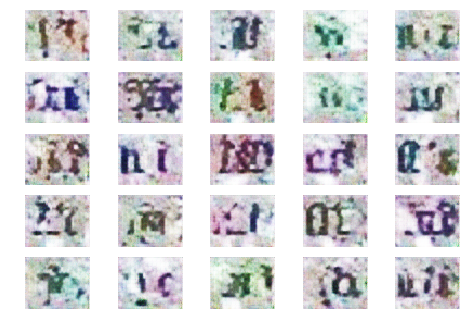

5251 [D loss: 1.001141] [G loss: 1.490214]
5252 [D loss: 1.001900] [G loss: 1.492535]
5253 [D loss: 1.001470] [G loss: 1.492348]
5254 [D loss: 1.000924] [G loss: 1.493199]
5255 [D loss: 1.001618] [G loss: 1.493281]
5256 [D loss: 1.002412] [G loss: 1.495257]
5257 [D loss: 1.001413] [G loss: 1.494061]
5258 [D loss: 1.001686] [G loss: 1.495387]
5259 [D loss: 1.001636] [G loss: 1.493268]
5260 [D loss: 1.001999] [G loss: 1.493540]
5261 [D loss: 1.002596] [G loss: 1.493319]
5262 [D loss: 1.001942] [G loss: 1.492260]
5263 [D loss: 1.002610] [G loss: 1.491706]
5264 [D loss: 1.000806] [G loss: 1.492054]
5265 [D loss: 1.002355] [G loss: 1.494130]
5266 [D loss: 1.002933] [G loss: 1.495493]
5267 [D loss: 1.000419] [G loss: 1.493062]
5268 [D loss: 1.002779] [G loss: 1.492770]
5269 [D loss: 1.000407] [G loss: 1.491769]
5270 [D loss: 1.001603] [G loss: 1.491217]
5271 [D loss: 1.003001] [G loss: 1.491117]
5272 [D loss: 1.000831] [G loss: 1.492071]
5273 [D loss: 1.002527] [G loss: 1.492692]
5274 [D los

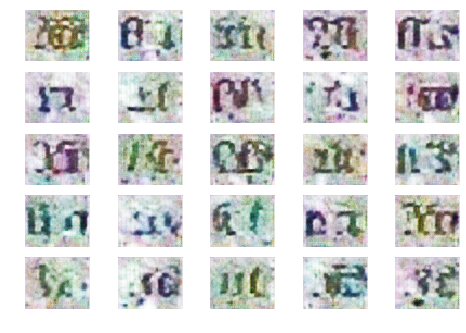

5301 [D loss: 1.001825] [G loss: 1.493073]
5302 [D loss: 1.001332] [G loss: 1.494933]
5303 [D loss: 1.001332] [G loss: 1.493861]
5304 [D loss: 1.001872] [G loss: 1.494027]
5305 [D loss: 1.001437] [G loss: 1.493156]
5306 [D loss: 1.001757] [G loss: 1.493419]
5307 [D loss: 1.002197] [G loss: 1.492080]
5308 [D loss: 1.001499] [G loss: 1.492827]
5309 [D loss: 1.001356] [G loss: 1.493185]
5310 [D loss: 1.002751] [G loss: 1.493471]
5311 [D loss: 1.001497] [G loss: 1.493191]
5312 [D loss: 1.001878] [G loss: 1.495450]
5313 [D loss: 1.001889] [G loss: 1.492967]
5314 [D loss: 1.001593] [G loss: 1.493639]
5315 [D loss: 1.001618] [G loss: 1.493422]
5316 [D loss: 1.002725] [G loss: 1.492944]
5317 [D loss: 1.003205] [G loss: 1.492898]
5318 [D loss: 1.000768] [G loss: 1.493214]
5319 [D loss: 1.001774] [G loss: 1.493428]
5320 [D loss: 1.000787] [G loss: 1.493377]
5321 [D loss: 1.002609] [G loss: 1.494340]
5322 [D loss: 1.001139] [G loss: 1.493163]
5323 [D loss: 1.001788] [G loss: 1.491763]
5324 [D los

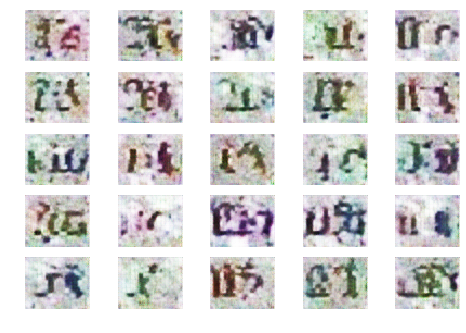

5351 [D loss: 1.002887] [G loss: 1.491742]
5352 [D loss: 1.001225] [G loss: 1.493282]
5353 [D loss: 0.999845] [G loss: 1.492955]
5354 [D loss: 1.001564] [G loss: 1.493843]
5355 [D loss: 1.002781] [G loss: 1.494841]
5356 [D loss: 1.001928] [G loss: 1.491691]
5357 [D loss: 1.000570] [G loss: 1.491710]
5358 [D loss: 1.001507] [G loss: 1.492212]
5359 [D loss: 1.002614] [G loss: 1.492775]
5360 [D loss: 1.003205] [G loss: 1.492732]
5361 [D loss: 1.001024] [G loss: 1.493232]
5362 [D loss: 1.001599] [G loss: 1.493645]
5363 [D loss: 1.001548] [G loss: 1.492415]
5364 [D loss: 1.000513] [G loss: 1.492877]
5365 [D loss: 1.000605] [G loss: 1.492880]
5366 [D loss: 1.002475] [G loss: 1.494225]
5367 [D loss: 1.001770] [G loss: 1.492265]
5368 [D loss: 1.001864] [G loss: 1.492497]
5369 [D loss: 1.002492] [G loss: 1.494691]
5370 [D loss: 1.002812] [G loss: 1.496205]
5371 [D loss: 1.001542] [G loss: 1.492837]
5372 [D loss: 1.001595] [G loss: 1.494778]
5373 [D loss: 1.001151] [G loss: 1.495582]
5374 [D los

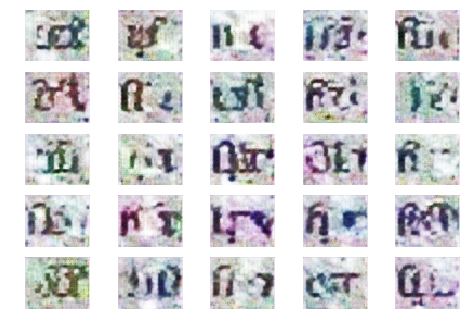

5401 [D loss: 1.001271] [G loss: 1.492936]
5402 [D loss: 1.000877] [G loss: 1.494269]
5403 [D loss: 1.001902] [G loss: 1.493173]
5404 [D loss: 1.001301] [G loss: 1.493600]
5405 [D loss: 1.000883] [G loss: 1.492382]
5406 [D loss: 1.002145] [G loss: 1.493654]
5407 [D loss: 1.001682] [G loss: 1.493047]
5408 [D loss: 1.000993] [G loss: 1.493947]
5409 [D loss: 1.000594] [G loss: 1.493518]
5410 [D loss: 1.001121] [G loss: 1.492398]
5411 [D loss: 1.001746] [G loss: 1.494940]
5412 [D loss: 1.001403] [G loss: 1.490796]
5413 [D loss: 1.001289] [G loss: 1.493255]
5414 [D loss: 1.002976] [G loss: 1.493499]
5415 [D loss: 1.002940] [G loss: 1.491215]
5416 [D loss: 1.001706] [G loss: 1.492620]
5417 [D loss: 1.002608] [G loss: 1.493274]
5418 [D loss: 1.000617] [G loss: 1.494651]
5419 [D loss: 1.000875] [G loss: 1.494503]
5420 [D loss: 1.002483] [G loss: 1.493430]
5421 [D loss: 1.000463] [G loss: 1.493297]
5422 [D loss: 1.001490] [G loss: 1.493971]
5423 [D loss: 1.002228] [G loss: 1.493791]
5424 [D los

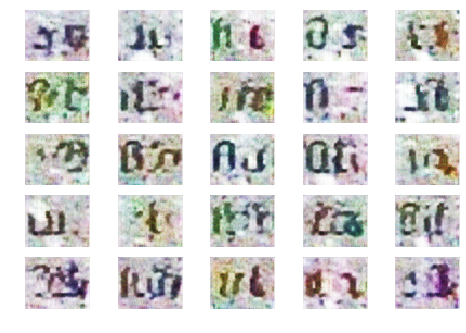

5451 [D loss: 1.001438] [G loss: 1.493077]
5452 [D loss: 1.002062] [G loss: 1.494162]
5453 [D loss: 1.001650] [G loss: 1.494133]
5454 [D loss: 1.001703] [G loss: 1.494051]
5455 [D loss: 1.001864] [G loss: 1.492245]
5456 [D loss: 1.001120] [G loss: 1.492916]
5457 [D loss: 1.001162] [G loss: 1.493774]
5458 [D loss: 1.000872] [G loss: 1.492211]
5459 [D loss: 1.001631] [G loss: 1.495135]
5460 [D loss: 1.001095] [G loss: 1.495276]
5461 [D loss: 1.002616] [G loss: 1.494823]
5462 [D loss: 1.001250] [G loss: 1.493378]
5463 [D loss: 1.002391] [G loss: 1.492865]
5464 [D loss: 1.001600] [G loss: 1.494427]
5465 [D loss: 1.001170] [G loss: 1.494807]
5466 [D loss: 1.000827] [G loss: 1.494447]
5467 [D loss: 1.000139] [G loss: 1.493260]
5468 [D loss: 1.000427] [G loss: 1.493941]
5469 [D loss: 1.000749] [G loss: 1.493879]
5470 [D loss: 1.000831] [G loss: 1.494018]
5471 [D loss: 1.002787] [G loss: 1.494022]
5472 [D loss: 1.001964] [G loss: 1.493642]
5473 [D loss: 1.001405] [G loss: 1.493395]
5474 [D los

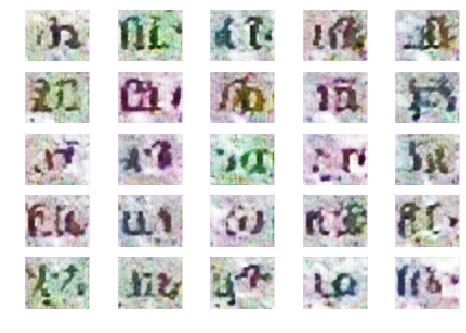

5501 [D loss: 1.001030] [G loss: 1.494099]
5502 [D loss: 1.001639] [G loss: 1.494194]
5503 [D loss: 1.002591] [G loss: 1.493306]
5504 [D loss: 1.001135] [G loss: 1.493691]
5505 [D loss: 1.002307] [G loss: 1.493964]
5506 [D loss: 1.001593] [G loss: 1.493223]
5507 [D loss: 1.001505] [G loss: 1.495626]
5508 [D loss: 1.002080] [G loss: 1.493435]
5509 [D loss: 1.001638] [G loss: 1.494671]
5510 [D loss: 1.002358] [G loss: 1.494120]
5511 [D loss: 1.002283] [G loss: 1.493494]
5512 [D loss: 1.001194] [G loss: 1.493709]
5513 [D loss: 1.001552] [G loss: 1.493583]
5514 [D loss: 1.002411] [G loss: 1.493259]
5515 [D loss: 1.001530] [G loss: 1.496579]
5516 [D loss: 1.001334] [G loss: 1.493362]
5517 [D loss: 1.002530] [G loss: 1.493370]
5518 [D loss: 1.001006] [G loss: 1.492700]
5519 [D loss: 1.000291] [G loss: 1.492764]
5520 [D loss: 1.001290] [G loss: 1.492718]
5521 [D loss: 1.001244] [G loss: 1.495546]
5522 [D loss: 1.001363] [G loss: 1.493352]
5523 [D loss: 1.001666] [G loss: 1.492495]
5524 [D los

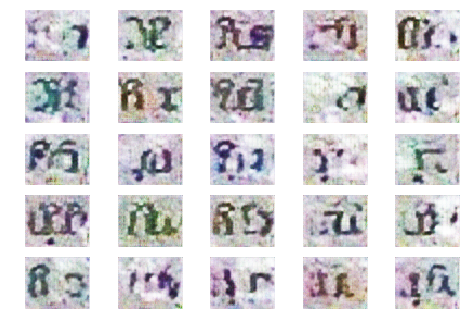

5551 [D loss: 1.001669] [G loss: 1.493133]
5552 [D loss: 1.001102] [G loss: 1.495134]
5553 [D loss: 1.001715] [G loss: 1.494450]
5554 [D loss: 1.001860] [G loss: 1.494195]
5555 [D loss: 1.001163] [G loss: 1.492900]
5556 [D loss: 1.000480] [G loss: 1.495091]
5557 [D loss: 1.000864] [G loss: 1.493237]
5558 [D loss: 1.001342] [G loss: 1.492608]
5559 [D loss: 1.000400] [G loss: 1.492272]
5560 [D loss: 1.001480] [G loss: 1.493562]
5561 [D loss: 1.000619] [G loss: 1.494404]
5562 [D loss: 1.002380] [G loss: 1.494799]
5563 [D loss: 1.001348] [G loss: 1.495564]
5564 [D loss: 1.001828] [G loss: 1.494618]
5565 [D loss: 1.002131] [G loss: 1.494691]
5566 [D loss: 1.002095] [G loss: 1.493983]
5567 [D loss: 1.001557] [G loss: 1.493258]
5568 [D loss: 1.001649] [G loss: 1.494546]
5569 [D loss: 1.001311] [G loss: 1.494216]
5570 [D loss: 1.001085] [G loss: 1.494829]
5571 [D loss: 1.002489] [G loss: 1.492915]
5572 [D loss: 1.002264] [G loss: 1.492723]
5573 [D loss: 1.000943] [G loss: 1.494148]
5574 [D los

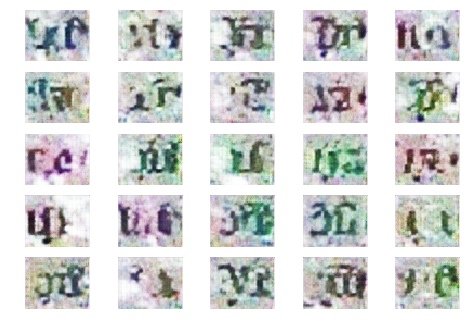

5601 [D loss: 1.002504] [G loss: 1.492910]
5602 [D loss: 1.000675] [G loss: 1.493773]
5603 [D loss: 1.002510] [G loss: 1.494476]
5604 [D loss: 1.002389] [G loss: 1.493881]
5605 [D loss: 1.001418] [G loss: 1.491618]
5606 [D loss: 1.000447] [G loss: 1.493788]
5607 [D loss: 1.002955] [G loss: 1.493761]
5608 [D loss: 1.001814] [G loss: 1.492793]
5609 [D loss: 1.001468] [G loss: 1.492850]
5610 [D loss: 1.001284] [G loss: 1.494440]
5611 [D loss: 1.001805] [G loss: 1.494373]
5612 [D loss: 1.001065] [G loss: 1.494483]
5613 [D loss: 1.001978] [G loss: 1.494782]
5614 [D loss: 1.001325] [G loss: 1.494773]
5615 [D loss: 1.001893] [G loss: 1.495739]
5616 [D loss: 1.000419] [G loss: 1.493636]
5617 [D loss: 1.002287] [G loss: 1.493129]
5618 [D loss: 1.001050] [G loss: 1.494200]
5619 [D loss: 1.001012] [G loss: 1.495051]
5620 [D loss: 1.001279] [G loss: 1.494757]
5621 [D loss: 1.002248] [G loss: 1.495645]
5622 [D loss: 1.001920] [G loss: 1.496753]
5623 [D loss: 1.000815] [G loss: 1.494209]
5624 [D los

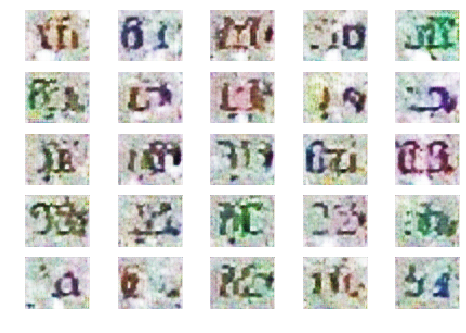

5651 [D loss: 1.001981] [G loss: 1.494846]
5652 [D loss: 1.001916] [G loss: 1.493438]
5653 [D loss: 1.000718] [G loss: 1.493516]
5654 [D loss: 1.001376] [G loss: 1.495335]
5655 [D loss: 1.001484] [G loss: 1.494403]
5656 [D loss: 1.001555] [G loss: 1.492986]
5657 [D loss: 1.001586] [G loss: 1.493176]
5658 [D loss: 1.001447] [G loss: 1.493702]
5659 [D loss: 1.001276] [G loss: 1.493159]
5660 [D loss: 1.001847] [G loss: 1.494372]
5661 [D loss: 1.000828] [G loss: 1.493800]
5662 [D loss: 1.000752] [G loss: 1.493617]
5663 [D loss: 1.001156] [G loss: 1.493631]
5664 [D loss: 1.000883] [G loss: 1.492202]
5665 [D loss: 1.002003] [G loss: 1.495087]
5666 [D loss: 1.001239] [G loss: 1.493758]
5667 [D loss: 1.001124] [G loss: 1.493562]
5668 [D loss: 1.000653] [G loss: 1.495303]
5669 [D loss: 1.001984] [G loss: 1.495211]
5670 [D loss: 1.002340] [G loss: 1.493807]
5671 [D loss: 1.002443] [G loss: 1.495190]
5672 [D loss: 1.001233] [G loss: 1.493101]
5673 [D loss: 1.001585] [G loss: 1.494403]
5674 [D los

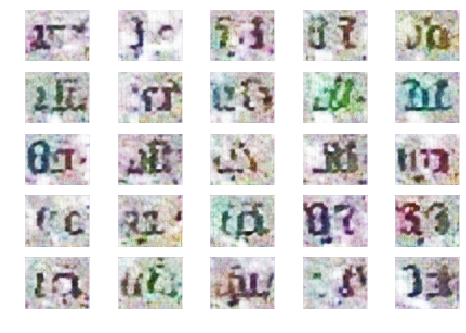

5701 [D loss: 1.001443] [G loss: 1.494765]
5702 [D loss: 1.001052] [G loss: 1.494939]
5703 [D loss: 1.002532] [G loss: 1.493335]
5704 [D loss: 1.002634] [G loss: 1.494289]
5705 [D loss: 1.002497] [G loss: 1.494681]
5706 [D loss: 1.001345] [G loss: 1.492832]
5707 [D loss: 1.001152] [G loss: 1.495275]
5708 [D loss: 1.000706] [G loss: 1.493376]
5709 [D loss: 1.000856] [G loss: 1.494778]
5710 [D loss: 1.001725] [G loss: 1.492932]
5711 [D loss: 1.001077] [G loss: 1.495057]
5712 [D loss: 1.001620] [G loss: 1.493854]
5713 [D loss: 1.000606] [G loss: 1.494934]
5714 [D loss: 1.001304] [G loss: 1.494326]
5715 [D loss: 1.001400] [G loss: 1.495444]
5716 [D loss: 1.002153] [G loss: 1.494025]
5717 [D loss: 1.001387] [G loss: 1.492008]
5718 [D loss: 1.001357] [G loss: 1.493288]
5719 [D loss: 1.001280] [G loss: 1.492763]
5720 [D loss: 1.001365] [G loss: 1.494256]
5721 [D loss: 1.001589] [G loss: 1.494850]
5722 [D loss: 1.001947] [G loss: 1.492917]
5723 [D loss: 1.001779] [G loss: 1.495183]
5724 [D los

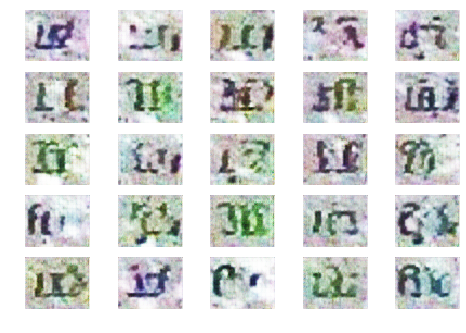

5751 [D loss: 1.002062] [G loss: 1.494048]
5752 [D loss: 1.001510] [G loss: 1.493571]
5753 [D loss: 1.001503] [G loss: 1.492998]
5754 [D loss: 1.002753] [G loss: 1.493526]
5755 [D loss: 1.002062] [G loss: 1.492975]
5756 [D loss: 1.001412] [G loss: 1.493267]
5757 [D loss: 1.002189] [G loss: 1.493694]
5758 [D loss: 1.000599] [G loss: 1.493923]
5759 [D loss: 1.001785] [G loss: 1.492985]
5760 [D loss: 1.002380] [G loss: 1.494437]
5761 [D loss: 1.001244] [G loss: 1.493831]
5762 [D loss: 1.001903] [G loss: 1.493246]
5763 [D loss: 1.001708] [G loss: 1.493048]
5764 [D loss: 1.000688] [G loss: 1.493189]
5765 [D loss: 1.001553] [G loss: 1.493542]
5766 [D loss: 1.001908] [G loss: 1.495251]
5767 [D loss: 1.001249] [G loss: 1.495421]
5768 [D loss: 1.002020] [G loss: 1.493414]
5769 [D loss: 1.001094] [G loss: 1.494073]
5770 [D loss: 1.001781] [G loss: 1.494169]
5771 [D loss: 1.001437] [G loss: 1.494301]
5772 [D loss: 1.002011] [G loss: 1.494527]
5773 [D loss: 1.000837] [G loss: 1.495178]
5774 [D los

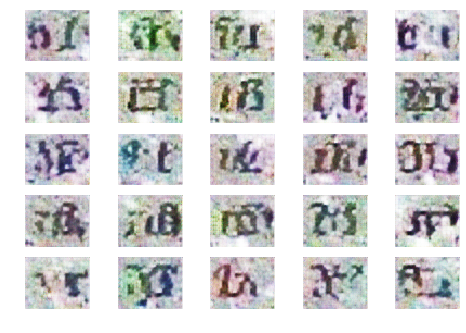

5801 [D loss: 1.002110] [G loss: 1.495070]
5802 [D loss: 1.001286] [G loss: 1.494439]
5803 [D loss: 1.001834] [G loss: 1.494214]
5804 [D loss: 1.002108] [G loss: 1.494750]
5805 [D loss: 1.001057] [G loss: 1.494462]
5806 [D loss: 1.001205] [G loss: 1.494364]
5807 [D loss: 1.001667] [G loss: 1.494535]
5808 [D loss: 1.001303] [G loss: 1.493577]
5809 [D loss: 1.001187] [G loss: 1.493971]
5810 [D loss: 1.001675] [G loss: 1.493557]
5811 [D loss: 1.002007] [G loss: 1.495497]
5812 [D loss: 1.000724] [G loss: 1.495070]
5813 [D loss: 1.000739] [G loss: 1.494982]
5814 [D loss: 1.001351] [G loss: 1.494392]
5815 [D loss: 1.001700] [G loss: 1.494692]
5816 [D loss: 1.001458] [G loss: 1.494002]
5817 [D loss: 1.001201] [G loss: 1.495801]
5818 [D loss: 1.001793] [G loss: 1.494871]
5819 [D loss: 1.002612] [G loss: 1.494790]
5820 [D loss: 1.001937] [G loss: 1.494942]
5821 [D loss: 1.001725] [G loss: 1.494705]
5822 [D loss: 1.001632] [G loss: 1.496021]
5823 [D loss: 1.001464] [G loss: 1.494408]
5824 [D los

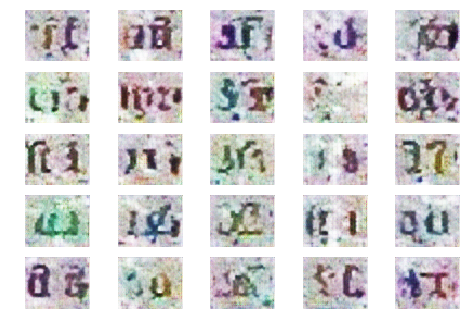

5851 [D loss: 1.001072] [G loss: 1.496595]
5852 [D loss: 1.000743] [G loss: 1.495142]
5853 [D loss: 1.001930] [G loss: 1.494466]
5854 [D loss: 1.001869] [G loss: 1.493279]
5855 [D loss: 1.001997] [G loss: 1.493206]
5856 [D loss: 1.001504] [G loss: 1.494740]
5857 [D loss: 1.000798] [G loss: 1.494584]
5858 [D loss: 1.001709] [G loss: 1.495270]
5859 [D loss: 1.000966] [G loss: 1.493928]
5860 [D loss: 1.001423] [G loss: 1.493445]
5861 [D loss: 1.001516] [G loss: 1.492174]
5862 [D loss: 1.001507] [G loss: 1.493493]
5863 [D loss: 1.001738] [G loss: 1.493975]
5864 [D loss: 1.001759] [G loss: 1.495738]
5865 [D loss: 1.001936] [G loss: 1.495277]
5866 [D loss: 1.001914] [G loss: 1.494448]
5867 [D loss: 1.001704] [G loss: 1.492950]
5868 [D loss: 1.001556] [G loss: 1.493371]
5869 [D loss: 1.001341] [G loss: 1.493805]
5870 [D loss: 1.001245] [G loss: 1.493634]
5871 [D loss: 1.001022] [G loss: 1.493334]
5872 [D loss: 1.001573] [G loss: 1.493703]
5873 [D loss: 1.001821] [G loss: 1.493807]
5874 [D los

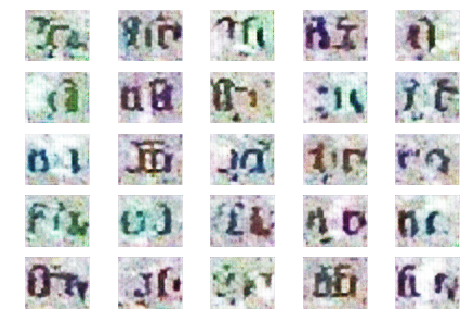

5901 [D loss: 1.001048] [G loss: 1.494212]
5902 [D loss: 1.001528] [G loss: 1.495220]
5903 [D loss: 1.001758] [G loss: 1.494586]
5904 [D loss: 1.001731] [G loss: 1.494130]
5905 [D loss: 1.002222] [G loss: 1.493344]
5906 [D loss: 1.002059] [G loss: 1.493995]
5907 [D loss: 1.001292] [G loss: 1.493610]
5908 [D loss: 1.001479] [G loss: 1.494078]
5909 [D loss: 1.000529] [G loss: 1.495536]
5910 [D loss: 1.001120] [G loss: 1.494970]
5911 [D loss: 1.001701] [G loss: 1.494967]
5912 [D loss: 1.001130] [G loss: 1.495163]
5913 [D loss: 1.001851] [G loss: 1.493958]
5914 [D loss: 1.001173] [G loss: 1.496075]
5915 [D loss: 1.001553] [G loss: 1.495698]
5916 [D loss: 1.001208] [G loss: 1.495131]
5917 [D loss: 1.000412] [G loss: 1.495013]
5918 [D loss: 1.000406] [G loss: 1.497029]
5919 [D loss: 1.001138] [G loss: 1.495905]
5920 [D loss: 1.001152] [G loss: 1.494842]
5921 [D loss: 1.001477] [G loss: 1.494911]
5922 [D loss: 1.001685] [G loss: 1.494261]
5923 [D loss: 1.002331] [G loss: 1.495173]
5924 [D los

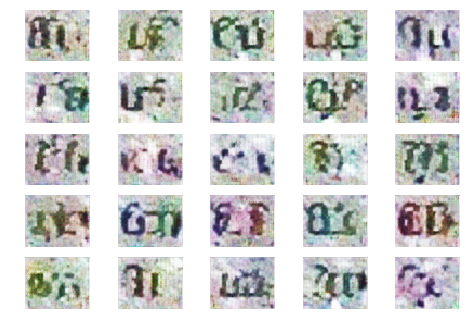

5951 [D loss: 1.001140] [G loss: 1.494367]
5952 [D loss: 1.000985] [G loss: 1.494308]
5953 [D loss: 1.002230] [G loss: 1.496067]
5954 [D loss: 1.002505] [G loss: 1.495576]
5955 [D loss: 1.001258] [G loss: 1.495248]
5956 [D loss: 1.001494] [G loss: 1.495036]
5957 [D loss: 1.001783] [G loss: 1.495842]
5958 [D loss: 1.001840] [G loss: 1.494361]
5959 [D loss: 1.001392] [G loss: 1.495359]
5960 [D loss: 1.001507] [G loss: 1.494567]
5961 [D loss: 1.001625] [G loss: 1.494337]
5962 [D loss: 1.001778] [G loss: 1.495884]
5963 [D loss: 1.001760] [G loss: 1.495462]
5964 [D loss: 1.001353] [G loss: 1.495347]
5965 [D loss: 1.002955] [G loss: 1.495023]
5966 [D loss: 1.001140] [G loss: 1.494865]
5967 [D loss: 1.002509] [G loss: 1.495144]
5968 [D loss: 1.001818] [G loss: 1.496117]
5969 [D loss: 1.001984] [G loss: 1.494825]
5970 [D loss: 1.003146] [G loss: 1.494952]
5971 [D loss: 1.000949] [G loss: 1.494497]
5972 [D loss: 1.001759] [G loss: 1.495303]
5973 [D loss: 1.002129] [G loss: 1.494788]
5974 [D los

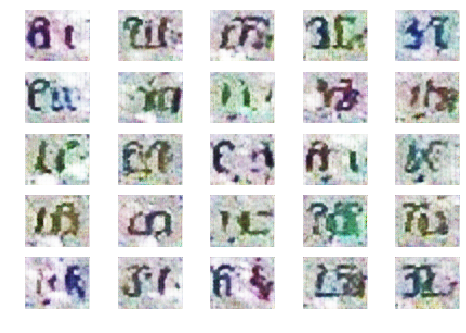

6001 [D loss: 1.001183] [G loss: 1.495312]
6002 [D loss: 1.001161] [G loss: 1.495760]
6003 [D loss: 1.001710] [G loss: 1.494749]
6004 [D loss: 1.002547] [G loss: 1.495651]
6005 [D loss: 1.001200] [G loss: 1.495257]
6006 [D loss: 1.001995] [G loss: 1.497996]
6007 [D loss: 1.002035] [G loss: 1.495947]
6008 [D loss: 1.001307] [G loss: 1.496858]
6009 [D loss: 1.001722] [G loss: 1.496641]
6010 [D loss: 1.001154] [G loss: 1.495914]
6011 [D loss: 1.002409] [G loss: 1.495817]
6012 [D loss: 1.000531] [G loss: 1.496153]
6013 [D loss: 1.000177] [G loss: 1.495138]
6014 [D loss: 1.001816] [G loss: 1.495241]
6015 [D loss: 1.002112] [G loss: 1.496264]
6016 [D loss: 1.002722] [G loss: 1.495975]
6017 [D loss: 1.001218] [G loss: 1.497169]
6018 [D loss: 1.001581] [G loss: 1.495897]
6019 [D loss: 1.001554] [G loss: 1.496282]
6020 [D loss: 1.000906] [G loss: 1.494197]
6021 [D loss: 1.001019] [G loss: 1.494637]
6022 [D loss: 1.002183] [G loss: 1.495782]
6023 [D loss: 1.001281] [G loss: 1.495027]
6024 [D los

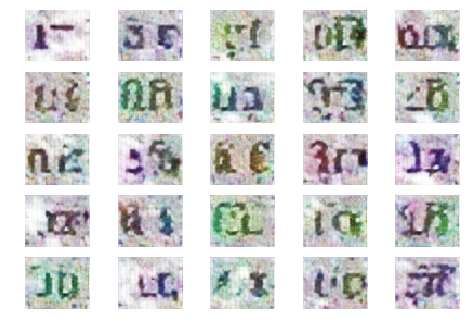

6051 [D loss: 1.002029] [G loss: 1.496947]
6052 [D loss: 1.000993] [G loss: 1.496655]
6053 [D loss: 1.002250] [G loss: 1.496535]
6054 [D loss: 1.002691] [G loss: 1.494815]
6055 [D loss: 1.001439] [G loss: 1.495063]
6056 [D loss: 1.001305] [G loss: 1.496086]
6057 [D loss: 1.002120] [G loss: 1.496163]
6058 [D loss: 1.002031] [G loss: 1.495349]
6059 [D loss: 1.000892] [G loss: 1.495640]
6060 [D loss: 1.000838] [G loss: 1.495463]
6061 [D loss: 1.000833] [G loss: 1.495444]
6062 [D loss: 1.000949] [G loss: 1.495072]
6063 [D loss: 1.000773] [G loss: 1.495931]
6064 [D loss: 1.002047] [G loss: 1.494136]
6065 [D loss: 1.000903] [G loss: 1.495697]
6066 [D loss: 1.000755] [G loss: 1.495400]
6067 [D loss: 1.002038] [G loss: 1.496248]
6068 [D loss: 1.001073] [G loss: 1.496434]
6069 [D loss: 1.001238] [G loss: 1.495921]
6070 [D loss: 1.001805] [G loss: 1.494555]
6071 [D loss: 1.002002] [G loss: 1.496395]
6072 [D loss: 1.001470] [G loss: 1.495165]
6073 [D loss: 1.001231] [G loss: 1.495921]
6074 [D los

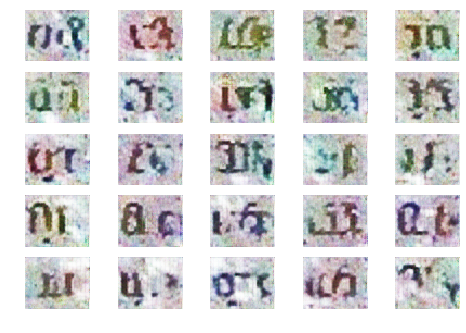

6101 [D loss: 1.000107] [G loss: 1.496510]
6102 [D loss: 1.001482] [G loss: 1.495655]
6103 [D loss: 1.001326] [G loss: 1.497065]
6104 [D loss: 1.001532] [G loss: 1.495885]
6105 [D loss: 1.001685] [G loss: 1.496147]
6106 [D loss: 1.002415] [G loss: 1.495072]
6107 [D loss: 1.000826] [G loss: 1.495978]
6108 [D loss: 1.000850] [G loss: 1.495344]
6109 [D loss: 1.000460] [G loss: 1.496001]
6110 [D loss: 1.001739] [G loss: 1.495996]
6111 [D loss: 1.001199] [G loss: 1.496968]
6112 [D loss: 1.000211] [G loss: 1.496617]
6113 [D loss: 1.001798] [G loss: 1.496214]
6114 [D loss: 1.001212] [G loss: 1.495012]
6115 [D loss: 1.001452] [G loss: 1.496390]
6116 [D loss: 1.001440] [G loss: 1.496297]
6117 [D loss: 1.001141] [G loss: 1.495365]
6118 [D loss: 1.001458] [G loss: 1.495904]
6119 [D loss: 1.000710] [G loss: 1.496206]
6120 [D loss: 1.002169] [G loss: 1.496605]
6121 [D loss: 1.000200] [G loss: 1.497214]
6122 [D loss: 1.001338] [G loss: 1.496671]
6123 [D loss: 1.001665] [G loss: 1.496666]
6124 [D los

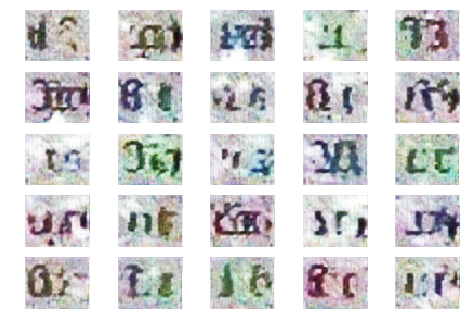

6151 [D loss: 1.000943] [G loss: 1.495163]
6152 [D loss: 1.000856] [G loss: 1.496306]
6153 [D loss: 1.001243] [G loss: 1.496679]
6154 [D loss: 1.001529] [G loss: 1.496203]
6155 [D loss: 1.001282] [G loss: 1.496747]
6156 [D loss: 1.001815] [G loss: 1.496098]
6157 [D loss: 1.001458] [G loss: 1.495266]
6158 [D loss: 1.001689] [G loss: 1.494565]
6159 [D loss: 1.000873] [G loss: 1.495729]
6160 [D loss: 1.001317] [G loss: 1.496212]
6161 [D loss: 1.002264] [G loss: 1.496796]
6162 [D loss: 1.001376] [G loss: 1.496517]
6163 [D loss: 1.001017] [G loss: 1.494431]
6164 [D loss: 1.000928] [G loss: 1.494784]
6165 [D loss: 1.000239] [G loss: 1.495289]
6166 [D loss: 1.001435] [G loss: 1.495830]
6167 [D loss: 1.002681] [G loss: 1.497382]
6168 [D loss: 1.001206] [G loss: 1.497590]
6169 [D loss: 1.000762] [G loss: 1.497038]
6170 [D loss: 1.001725] [G loss: 1.495846]
6171 [D loss: 1.000469] [G loss: 1.495867]
6172 [D loss: 1.002088] [G loss: 1.496109]
6173 [D loss: 1.001709] [G loss: 1.496393]
6174 [D los

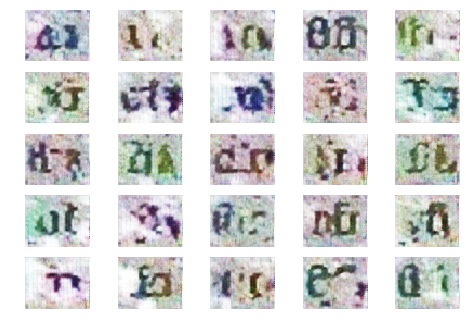

6201 [D loss: 1.000905] [G loss: 1.496319]
6202 [D loss: 1.000122] [G loss: 1.495548]
6203 [D loss: 1.001522] [G loss: 1.496646]
6204 [D loss: 1.001337] [G loss: 1.497735]
6205 [D loss: 1.001423] [G loss: 1.497197]
6206 [D loss: 1.000746] [G loss: 1.495961]
6207 [D loss: 1.001767] [G loss: 1.495400]
6208 [D loss: 1.001193] [G loss: 1.496708]
6209 [D loss: 1.001395] [G loss: 1.495007]
6210 [D loss: 1.000945] [G loss: 1.495570]
6211 [D loss: 1.000757] [G loss: 1.495714]
6212 [D loss: 1.001779] [G loss: 1.495228]
6213 [D loss: 1.000998] [G loss: 1.494610]
6214 [D loss: 1.001764] [G loss: 1.495054]
6215 [D loss: 1.001091] [G loss: 1.495101]
6216 [D loss: 1.001921] [G loss: 1.495133]
6217 [D loss: 1.001026] [G loss: 1.494554]
6218 [D loss: 1.002185] [G loss: 1.495069]
6219 [D loss: 1.001078] [G loss: 1.495389]
6220 [D loss: 1.001433] [G loss: 1.494685]
6221 [D loss: 1.001524] [G loss: 1.496950]
6222 [D loss: 1.001504] [G loss: 1.497301]
6223 [D loss: 1.001978] [G loss: 1.495126]
6224 [D los

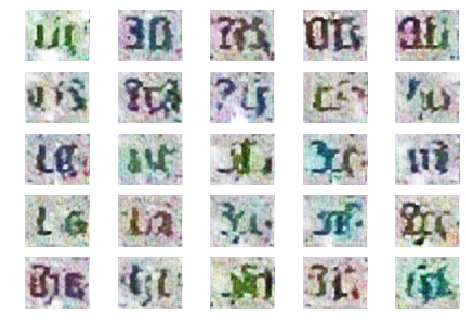

6251 [D loss: 1.001200] [G loss: 1.494674]
6252 [D loss: 1.000956] [G loss: 1.495643]
6253 [D loss: 1.000686] [G loss: 1.495465]
6254 [D loss: 1.000644] [G loss: 1.494469]
6255 [D loss: 1.000903] [G loss: 1.495928]
6256 [D loss: 1.001441] [G loss: 1.494981]
6257 [D loss: 1.001546] [G loss: 1.495992]
6258 [D loss: 1.001032] [G loss: 1.496869]
6259 [D loss: 1.001540] [G loss: 1.495743]
6260 [D loss: 1.000739] [G loss: 1.497043]
6261 [D loss: 1.001291] [G loss: 1.497146]
6262 [D loss: 1.000513] [G loss: 1.497005]
6263 [D loss: 0.999684] [G loss: 1.496576]
6264 [D loss: 1.000592] [G loss: 1.494863]
6265 [D loss: 1.001821] [G loss: 1.494958]
6266 [D loss: 1.001098] [G loss: 1.495017]
6267 [D loss: 1.002070] [G loss: 1.496202]
6268 [D loss: 1.000817] [G loss: 1.496459]
6269 [D loss: 1.001243] [G loss: 1.495809]
6270 [D loss: 1.000626] [G loss: 1.494383]
6271 [D loss: 1.000704] [G loss: 1.495150]
6272 [D loss: 1.001353] [G loss: 1.495454]
6273 [D loss: 1.001067] [G loss: 1.495776]
6274 [D los

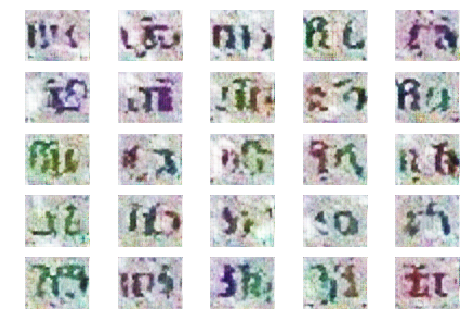

6301 [D loss: 1.001331] [G loss: 1.495724]
6302 [D loss: 1.000670] [G loss: 1.496514]
6303 [D loss: 1.002012] [G loss: 1.494614]
6304 [D loss: 1.000887] [G loss: 1.496481]
6305 [D loss: 1.000941] [G loss: 1.496884]
6306 [D loss: 1.000738] [G loss: 1.496244]
6307 [D loss: 1.001250] [G loss: 1.495762]
6308 [D loss: 1.001234] [G loss: 1.495697]
6309 [D loss: 1.001214] [G loss: 1.495784]
6310 [D loss: 1.001268] [G loss: 1.496125]
6311 [D loss: 1.000612] [G loss: 1.496082]
6312 [D loss: 1.001248] [G loss: 1.495747]
6313 [D loss: 1.001054] [G loss: 1.496016]
6314 [D loss: 1.001152] [G loss: 1.495696]
6315 [D loss: 1.001421] [G loss: 1.496380]
6316 [D loss: 1.001157] [G loss: 1.497779]
6317 [D loss: 1.000497] [G loss: 1.496315]
6318 [D loss: 1.001381] [G loss: 1.496130]
6319 [D loss: 1.001134] [G loss: 1.496236]
6320 [D loss: 1.000975] [G loss: 1.496318]
6321 [D loss: 1.000497] [G loss: 1.497278]
6322 [D loss: 1.001453] [G loss: 1.496438]
6323 [D loss: 1.001217] [G loss: 1.496101]
6324 [D los

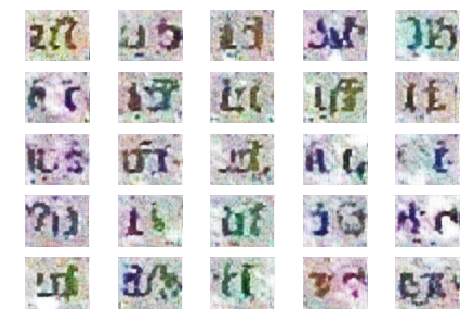

6351 [D loss: 1.001278] [G loss: 1.495776]
6352 [D loss: 1.001241] [G loss: 1.496369]
6353 [D loss: 1.000646] [G loss: 1.495996]
6354 [D loss: 1.000435] [G loss: 1.496754]
6355 [D loss: 1.001463] [G loss: 1.495791]
6356 [D loss: 1.000953] [G loss: 1.496428]
6357 [D loss: 1.001491] [G loss: 1.495407]
6358 [D loss: 1.001017] [G loss: 1.497184]
6359 [D loss: 1.000956] [G loss: 1.495964]
6360 [D loss: 1.001611] [G loss: 1.495570]
6361 [D loss: 1.001240] [G loss: 1.495954]
6362 [D loss: 1.002644] [G loss: 1.495333]
6363 [D loss: 1.001071] [G loss: 1.495181]
6364 [D loss: 1.001437] [G loss: 1.495894]
6365 [D loss: 1.000889] [G loss: 1.494769]
6366 [D loss: 1.000251] [G loss: 1.496025]
6367 [D loss: 1.000815] [G loss: 1.495337]
6368 [D loss: 1.001278] [G loss: 1.496531]
6369 [D loss: 1.000764] [G loss: 1.495284]
6370 [D loss: 1.001505] [G loss: 1.496542]
6371 [D loss: 1.000684] [G loss: 1.496636]
6372 [D loss: 1.001392] [G loss: 1.495522]
6373 [D loss: 1.000838] [G loss: 1.494500]
6374 [D los

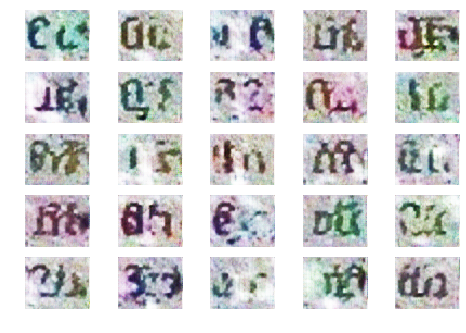

6401 [D loss: 1.000868] [G loss: 1.494368]
6402 [D loss: 1.001047] [G loss: 1.495843]
6403 [D loss: 1.001197] [G loss: 1.495895]
6404 [D loss: 1.000858] [G loss: 1.494990]
6405 [D loss: 1.002018] [G loss: 1.494789]
6406 [D loss: 1.002108] [G loss: 1.494670]
6407 [D loss: 1.001088] [G loss: 1.495522]
6408 [D loss: 1.001125] [G loss: 1.495586]
6409 [D loss: 1.001525] [G loss: 1.496567]
6410 [D loss: 1.001455] [G loss: 1.497183]
6411 [D loss: 1.000729] [G loss: 1.494920]
6412 [D loss: 1.001119] [G loss: 1.495351]
6413 [D loss: 1.000656] [G loss: 1.494859]
6414 [D loss: 1.001209] [G loss: 1.494492]
6415 [D loss: 1.001725] [G loss: 1.495988]
6416 [D loss: 1.000481] [G loss: 1.495848]
6417 [D loss: 1.000767] [G loss: 1.495773]
6418 [D loss: 1.000975] [G loss: 1.495653]
6419 [D loss: 1.001816] [G loss: 1.495386]
6420 [D loss: 1.000845] [G loss: 1.495142]
6421 [D loss: 1.000770] [G loss: 1.495987]
6422 [D loss: 1.001091] [G loss: 1.494993]
6423 [D loss: 1.000880] [G loss: 1.496354]
6424 [D los

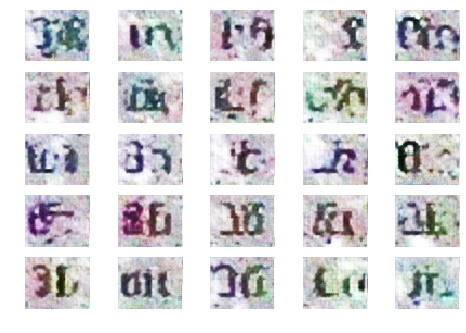

6451 [D loss: 1.000902] [G loss: 1.497312]
6452 [D loss: 1.001115] [G loss: 1.495325]
6453 [D loss: 1.001616] [G loss: 1.496176]
6454 [D loss: 1.002186] [G loss: 1.494984]
6455 [D loss: 1.001116] [G loss: 1.497655]
6456 [D loss: 1.000751] [G loss: 1.496116]
6457 [D loss: 1.001562] [G loss: 1.496588]
6458 [D loss: 1.001023] [G loss: 1.496120]
6459 [D loss: 1.001404] [G loss: 1.496559]
6460 [D loss: 1.001068] [G loss: 1.496479]
6461 [D loss: 1.000990] [G loss: 1.496326]
6462 [D loss: 1.001305] [G loss: 1.496602]
6463 [D loss: 1.001275] [G loss: 1.497746]
6464 [D loss: 1.000291] [G loss: 1.496993]
6465 [D loss: 1.002383] [G loss: 1.497050]
6466 [D loss: 1.001591] [G loss: 1.496874]
6467 [D loss: 1.000437] [G loss: 1.497014]
6468 [D loss: 1.001189] [G loss: 1.496012]
6469 [D loss: 1.001910] [G loss: 1.496409]
6470 [D loss: 1.000199] [G loss: 1.495558]
6471 [D loss: 1.001488] [G loss: 1.495279]
6472 [D loss: 1.000570] [G loss: 1.497087]
6473 [D loss: 1.001046] [G loss: 1.496833]
6474 [D los

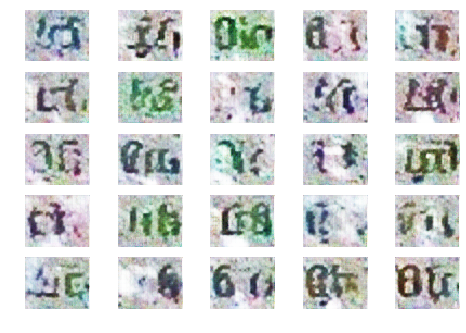

6501 [D loss: 1.001338] [G loss: 1.496290]
6502 [D loss: 1.000732] [G loss: 1.496512]
6503 [D loss: 1.000426] [G loss: 1.496269]
6504 [D loss: 1.001401] [G loss: 1.497366]
6505 [D loss: 1.001631] [G loss: 1.496283]
6506 [D loss: 1.000814] [G loss: 1.495044]
6507 [D loss: 1.000715] [G loss: 1.495951]
6508 [D loss: 1.000975] [G loss: 1.497050]
6509 [D loss: 1.000754] [G loss: 1.496917]
6510 [D loss: 1.000952] [G loss: 1.497524]
6511 [D loss: 1.000769] [G loss: 1.497994]
6512 [D loss: 1.001025] [G loss: 1.496884]
6513 [D loss: 1.000692] [G loss: 1.495776]
6514 [D loss: 1.000388] [G loss: 1.494600]
6515 [D loss: 1.001095] [G loss: 1.495884]
6516 [D loss: 1.000688] [G loss: 1.495440]
6517 [D loss: 1.001676] [G loss: 1.496017]
6518 [D loss: 1.001045] [G loss: 1.496560]
6519 [D loss: 1.001534] [G loss: 1.496459]
6520 [D loss: 1.000444] [G loss: 1.497779]
6521 [D loss: 1.001151] [G loss: 1.496532]
6522 [D loss: 1.001033] [G loss: 1.495082]
6523 [D loss: 1.001012] [G loss: 1.496880]
6524 [D los

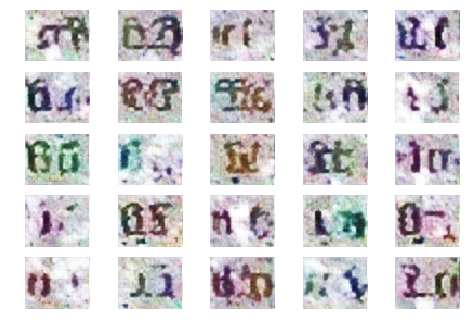

6551 [D loss: 1.000252] [G loss: 1.496479]
6552 [D loss: 1.000860] [G loss: 1.496531]
6553 [D loss: 1.000667] [G loss: 1.496101]
6554 [D loss: 1.001710] [G loss: 1.496962]
6555 [D loss: 1.001344] [G loss: 1.496934]
6556 [D loss: 1.000532] [G loss: 1.497557]
6557 [D loss: 1.001087] [G loss: 1.496739]
6558 [D loss: 1.001074] [G loss: 1.496529]
6559 [D loss: 1.001235] [G loss: 1.495770]
6560 [D loss: 1.001271] [G loss: 1.495998]
6561 [D loss: 1.000663] [G loss: 1.496610]
6562 [D loss: 1.000544] [G loss: 1.497978]
6563 [D loss: 1.001621] [G loss: 1.496831]
6564 [D loss: 1.000073] [G loss: 1.496650]
6565 [D loss: 1.000936] [G loss: 1.495963]
6566 [D loss: 1.002261] [G loss: 1.495955]
6567 [D loss: 1.000301] [G loss: 1.496846]
6568 [D loss: 1.000840] [G loss: 1.497321]
6569 [D loss: 1.001039] [G loss: 1.498711]
6570 [D loss: 1.000744] [G loss: 1.497441]
6571 [D loss: 1.001313] [G loss: 1.496508]
6572 [D loss: 1.001827] [G loss: 1.496287]
6573 [D loss: 1.000507] [G loss: 1.496295]
6574 [D los

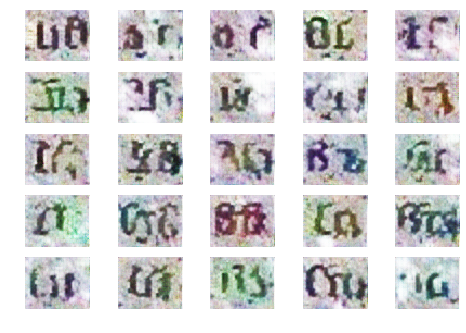

6601 [D loss: 1.001073] [G loss: 1.496599]
6602 [D loss: 1.001091] [G loss: 1.497647]
6603 [D loss: 1.000666] [G loss: 1.497063]
6604 [D loss: 1.000505] [G loss: 1.497116]
6605 [D loss: 1.000317] [G loss: 1.497633]
6606 [D loss: 1.000337] [G loss: 1.496666]
6607 [D loss: 1.000477] [G loss: 1.496016]
6608 [D loss: 1.000952] [G loss: 1.496537]
6609 [D loss: 1.000545] [G loss: 1.496936]
6610 [D loss: 1.000523] [G loss: 1.496407]
6611 [D loss: 1.001487] [G loss: 1.496177]
6612 [D loss: 1.001816] [G loss: 1.496350]
6613 [D loss: 1.001205] [G loss: 1.497001]
6614 [D loss: 1.000499] [G loss: 1.496877]
6615 [D loss: 0.999780] [G loss: 1.496792]
6616 [D loss: 1.001160] [G loss: 1.497219]
6617 [D loss: 1.001209] [G loss: 1.497310]
6618 [D loss: 1.000557] [G loss: 1.497327]
6619 [D loss: 1.000324] [G loss: 1.496271]
6620 [D loss: 1.000658] [G loss: 1.496294]
6621 [D loss: 1.000851] [G loss: 1.495619]
6622 [D loss: 1.000865] [G loss: 1.497268]
6623 [D loss: 1.000532] [G loss: 1.496101]
6624 [D los

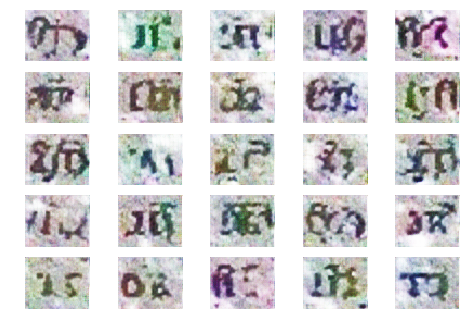

6651 [D loss: 1.000591] [G loss: 1.497636]
6652 [D loss: 1.001685] [G loss: 1.496938]
6653 [D loss: 1.001253] [G loss: 1.497588]
6654 [D loss: 1.001352] [G loss: 1.497333]
6655 [D loss: 1.000718] [G loss: 1.496712]
6656 [D loss: 1.000718] [G loss: 1.496333]
6657 [D loss: 1.000687] [G loss: 1.496403]
6658 [D loss: 1.001412] [G loss: 1.496041]
6659 [D loss: 1.001003] [G loss: 1.497049]
6660 [D loss: 1.001831] [G loss: 1.496349]
6661 [D loss: 1.000816] [G loss: 1.497050]
6662 [D loss: 1.000311] [G loss: 1.495789]
6663 [D loss: 1.001178] [G loss: 1.497229]
6664 [D loss: 1.000660] [G loss: 1.497671]
6665 [D loss: 1.000954] [G loss: 1.497594]
6666 [D loss: 1.000356] [G loss: 1.497267]
6667 [D loss: 1.000048] [G loss: 1.498316]
6668 [D loss: 1.000672] [G loss: 1.497628]
6669 [D loss: 1.001296] [G loss: 1.496786]
6670 [D loss: 1.000684] [G loss: 1.497230]
6671 [D loss: 1.000414] [G loss: 1.498018]
6672 [D loss: 1.001453] [G loss: 1.496708]
6673 [D loss: 1.000781] [G loss: 1.497450]
6674 [D los

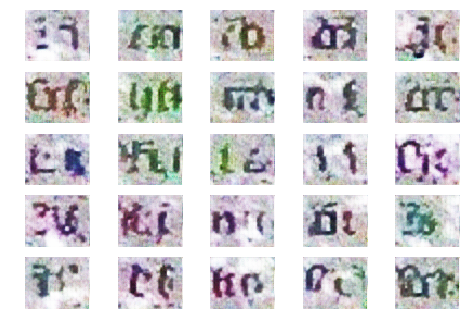

6701 [D loss: 1.001501] [G loss: 1.498102]
6702 [D loss: 1.001199] [G loss: 1.497417]
6703 [D loss: 1.000919] [G loss: 1.498566]
6704 [D loss: 1.000686] [G loss: 1.496205]
6705 [D loss: 1.000783] [G loss: 1.496227]
6706 [D loss: 1.000586] [G loss: 1.496471]
6707 [D loss: 1.000976] [G loss: 1.497517]
6708 [D loss: 1.000431] [G loss: 1.497326]
6709 [D loss: 1.000735] [G loss: 1.497336]
6710 [D loss: 1.001246] [G loss: 1.497229]
6711 [D loss: 1.001343] [G loss: 1.496919]
6712 [D loss: 1.000082] [G loss: 1.496844]
6713 [D loss: 1.000948] [G loss: 1.497232]
6714 [D loss: 1.001989] [G loss: 1.496925]
6715 [D loss: 1.000699] [G loss: 1.498496]
6716 [D loss: 1.000985] [G loss: 1.497886]
6717 [D loss: 1.001533] [G loss: 1.496455]
6718 [D loss: 1.001450] [G loss: 1.496550]
6719 [D loss: 1.001188] [G loss: 1.495081]
6720 [D loss: 1.000501] [G loss: 1.497216]
6721 [D loss: 1.000842] [G loss: 1.497968]
6722 [D loss: 1.001016] [G loss: 1.497496]
6723 [D loss: 1.001296] [G loss: 1.496833]
6724 [D los

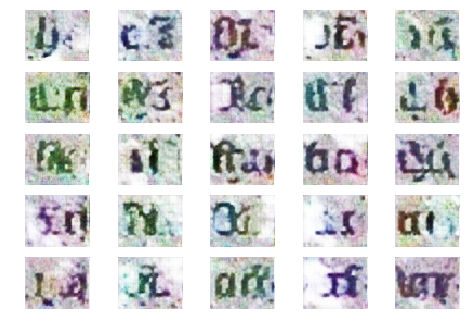

6751 [D loss: 1.000729] [G loss: 1.496149]
6752 [D loss: 1.000705] [G loss: 1.495516]
6753 [D loss: 1.000918] [G loss: 1.496611]
6754 [D loss: 1.000795] [G loss: 1.496355]
6755 [D loss: 1.001220] [G loss: 1.496038]
6756 [D loss: 1.000821] [G loss: 1.495467]
6757 [D loss: 1.001534] [G loss: 1.496498]
6758 [D loss: 1.000965] [G loss: 1.498100]
6759 [D loss: 0.999987] [G loss: 1.497360]
6760 [D loss: 1.001434] [G loss: 1.497109]
6761 [D loss: 1.000338] [G loss: 1.497497]
6762 [D loss: 1.000711] [G loss: 1.497081]
6763 [D loss: 1.000646] [G loss: 1.496356]
6764 [D loss: 1.001493] [G loss: 1.497236]
6765 [D loss: 1.001385] [G loss: 1.497362]
6766 [D loss: 1.001269] [G loss: 1.497278]
6767 [D loss: 1.000953] [G loss: 1.497145]
6768 [D loss: 1.000593] [G loss: 1.497107]
6769 [D loss: 1.000245] [G loss: 1.497482]
6770 [D loss: 1.001280] [G loss: 1.496802]
6771 [D loss: 1.000385] [G loss: 1.497380]
6772 [D loss: 1.000998] [G loss: 1.498208]
6773 [D loss: 1.001023] [G loss: 1.497549]
6774 [D los

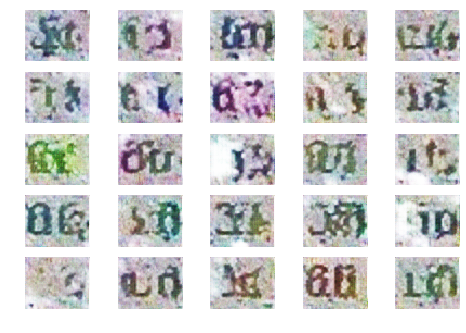

6801 [D loss: 1.001430] [G loss: 1.497221]
6802 [D loss: 1.000398] [G loss: 1.497573]
6803 [D loss: 1.001190] [G loss: 1.498498]
6804 [D loss: 1.000112] [G loss: 1.497617]
6805 [D loss: 1.000863] [G loss: 1.496693]
6806 [D loss: 1.000374] [G loss: 1.497054]
6807 [D loss: 1.000747] [G loss: 1.497566]
6808 [D loss: 1.000243] [G loss: 1.497842]
6809 [D loss: 1.000366] [G loss: 1.497810]
6810 [D loss: 1.000997] [G loss: 1.497959]
6811 [D loss: 1.001520] [G loss: 1.497359]
6812 [D loss: 1.000435] [G loss: 1.497613]
6813 [D loss: 1.000626] [G loss: 1.498011]
6814 [D loss: 1.000862] [G loss: 1.497473]
6815 [D loss: 1.001056] [G loss: 1.497399]
6816 [D loss: 1.000704] [G loss: 1.497104]
6817 [D loss: 1.001098] [G loss: 1.496737]
6818 [D loss: 1.001048] [G loss: 1.497124]
6819 [D loss: 1.001602] [G loss: 1.497065]
6820 [D loss: 1.000727] [G loss: 1.497951]
6821 [D loss: 1.000798] [G loss: 1.497911]
6822 [D loss: 1.001202] [G loss: 1.497951]
6823 [D loss: 1.001048] [G loss: 1.497743]
6824 [D los

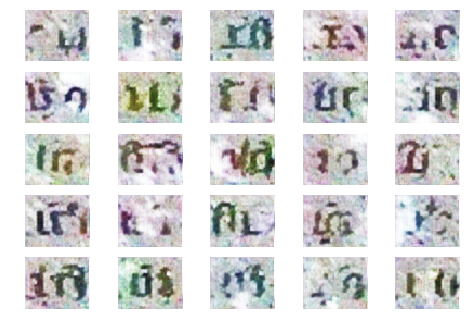

6851 [D loss: 1.000869] [G loss: 1.497379]
6852 [D loss: 1.001738] [G loss: 1.497135]
6853 [D loss: 1.000752] [G loss: 1.497203]
6854 [D loss: 1.001087] [G loss: 1.496890]
6855 [D loss: 1.000980] [G loss: 1.497330]
6856 [D loss: 1.001631] [G loss: 1.496778]
6857 [D loss: 1.000456] [G loss: 1.496496]
6858 [D loss: 1.001028] [G loss: 1.497423]
6859 [D loss: 1.001502] [G loss: 1.497015]
6860 [D loss: 1.001705] [G loss: 1.498041]
6861 [D loss: 1.000833] [G loss: 1.496322]
6862 [D loss: 1.000961] [G loss: 1.495192]
6863 [D loss: 1.000803] [G loss: 1.497273]
6864 [D loss: 1.001120] [G loss: 1.496891]
6865 [D loss: 1.000974] [G loss: 1.496951]
6866 [D loss: 1.000386] [G loss: 1.497511]
6867 [D loss: 1.000597] [G loss: 1.496633]
6868 [D loss: 1.001452] [G loss: 1.496898]
6869 [D loss: 1.000893] [G loss: 1.499035]
6870 [D loss: 1.000979] [G loss: 1.496628]
6871 [D loss: 1.000404] [G loss: 1.497298]
6872 [D loss: 1.001176] [G loss: 1.496964]
6873 [D loss: 1.001188] [G loss: 1.497036]
6874 [D los

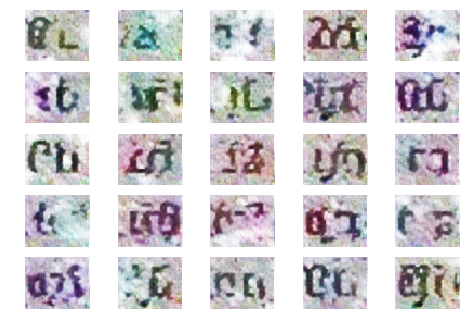

6901 [D loss: 1.001048] [G loss: 1.497160]
6902 [D loss: 1.001217] [G loss: 1.497440]
6903 [D loss: 1.000640] [G loss: 1.497503]
6904 [D loss: 1.001682] [G loss: 1.497667]
6905 [D loss: 1.000819] [G loss: 1.497152]
6906 [D loss: 1.000878] [G loss: 1.498857]
6907 [D loss: 1.000455] [G loss: 1.497445]
6908 [D loss: 1.000594] [G loss: 1.497055]
6909 [D loss: 1.000304] [G loss: 1.497409]
6910 [D loss: 1.000956] [G loss: 1.497789]
6911 [D loss: 1.000670] [G loss: 1.496718]
6912 [D loss: 1.001168] [G loss: 1.496543]
6913 [D loss: 0.999976] [G loss: 1.497141]
6914 [D loss: 1.000793] [G loss: 1.497654]
6915 [D loss: 1.000947] [G loss: 1.496464]
6916 [D loss: 1.000631] [G loss: 1.497701]
6917 [D loss: 1.000914] [G loss: 1.497775]
6918 [D loss: 1.000461] [G loss: 1.497368]
6919 [D loss: 1.001061] [G loss: 1.497424]
6920 [D loss: 1.001254] [G loss: 1.496950]
6921 [D loss: 1.000625] [G loss: 1.497029]
6922 [D loss: 1.001169] [G loss: 1.497164]
6923 [D loss: 1.000248] [G loss: 1.497355]
6924 [D los

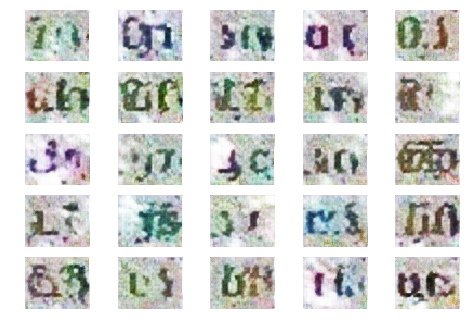

6951 [D loss: 1.001528] [G loss: 1.497281]
6952 [D loss: 1.000378] [G loss: 1.498313]
6953 [D loss: 1.000766] [G loss: 1.498155]
6954 [D loss: 1.001075] [G loss: 1.497302]
6955 [D loss: 1.001623] [G loss: 1.497733]
6956 [D loss: 1.000641] [G loss: 1.496889]
6957 [D loss: 1.000749] [G loss: 1.496907]
6958 [D loss: 1.001000] [G loss: 1.496883]
6959 [D loss: 1.001315] [G loss: 1.497845]
6960 [D loss: 1.000631] [G loss: 1.496938]
6961 [D loss: 1.000441] [G loss: 1.497938]
6962 [D loss: 1.000813] [G loss: 1.497922]
6963 [D loss: 1.001451] [G loss: 1.497594]
6964 [D loss: 1.000606] [G loss: 1.497624]
6965 [D loss: 1.001281] [G loss: 1.497245]
6966 [D loss: 1.000609] [G loss: 1.498547]
6967 [D loss: 1.000949] [G loss: 1.498045]
6968 [D loss: 1.000877] [G loss: 1.498177]
6969 [D loss: 1.001185] [G loss: 1.498657]
6970 [D loss: 1.000782] [G loss: 1.497007]
6971 [D loss: 1.000697] [G loss: 1.497890]
6972 [D loss: 1.000905] [G loss: 1.498293]
6973 [D loss: 1.001408] [G loss: 1.498094]
6974 [D los

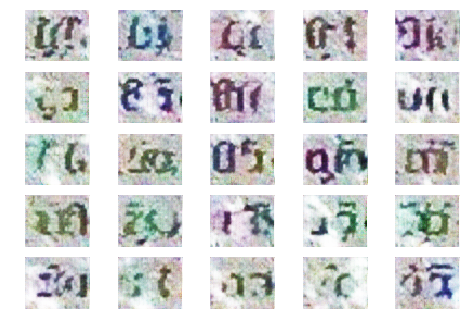

7001 [D loss: 1.002095] [G loss: 1.497147]
7002 [D loss: 1.000852] [G loss: 1.497939]
7003 [D loss: 1.000611] [G loss: 1.497345]
7004 [D loss: 1.001040] [G loss: 1.498127]
7005 [D loss: 1.001035] [G loss: 1.496926]
7006 [D loss: 1.001216] [G loss: 1.497614]
7007 [D loss: 1.001188] [G loss: 1.497487]
7008 [D loss: 1.000780] [G loss: 1.496273]
7009 [D loss: 1.000485] [G loss: 1.496836]
7010 [D loss: 1.000655] [G loss: 1.497054]
7011 [D loss: 1.001327] [G loss: 1.498085]
7012 [D loss: 1.001045] [G loss: 1.498804]
7013 [D loss: 1.001288] [G loss: 1.497797]
7014 [D loss: 1.001438] [G loss: 1.497494]
7015 [D loss: 1.001169] [G loss: 1.497762]
7016 [D loss: 1.000645] [G loss: 1.497663]
7017 [D loss: 1.000578] [G loss: 1.498328]
7018 [D loss: 1.001218] [G loss: 1.498570]
7019 [D loss: 1.001179] [G loss: 1.498257]
7020 [D loss: 1.001244] [G loss: 1.498930]
7021 [D loss: 1.000758] [G loss: 1.497994]
7022 [D loss: 1.000814] [G loss: 1.496975]
7023 [D loss: 1.000850] [G loss: 1.497310]
7024 [D los

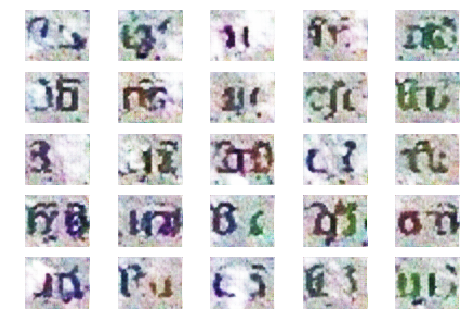

7051 [D loss: 1.000961] [G loss: 1.496679]
7052 [D loss: 1.000893] [G loss: 1.496521]
7053 [D loss: 1.000677] [G loss: 1.497100]
7054 [D loss: 1.000374] [G loss: 1.497071]
7055 [D loss: 1.000951] [G loss: 1.496660]
7056 [D loss: 1.001117] [G loss: 1.497174]
7057 [D loss: 1.001214] [G loss: 1.497848]
7058 [D loss: 1.001127] [G loss: 1.498258]
7059 [D loss: 1.001131] [G loss: 1.496706]
7060 [D loss: 1.000482] [G loss: 1.497265]
7061 [D loss: 1.000603] [G loss: 1.497674]
7062 [D loss: 1.001504] [G loss: 1.498169]
7063 [D loss: 0.999843] [G loss: 1.498108]
7064 [D loss: 1.000558] [G loss: 1.497323]
7065 [D loss: 1.000812] [G loss: 1.497453]
7066 [D loss: 1.001159] [G loss: 1.496570]
7067 [D loss: 1.001378] [G loss: 1.497222]
7068 [D loss: 1.001073] [G loss: 1.496902]
7069 [D loss: 1.001134] [G loss: 1.496041]
7070 [D loss: 1.001393] [G loss: 1.496837]
7071 [D loss: 1.000851] [G loss: 1.497596]
7072 [D loss: 1.001146] [G loss: 1.497692]
7073 [D loss: 1.001359] [G loss: 1.497603]
7074 [D los

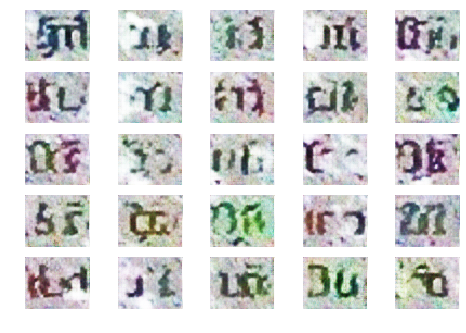

7101 [D loss: 1.001198] [G loss: 1.496603]
7102 [D loss: 1.000435] [G loss: 1.496395]
7103 [D loss: 1.001024] [G loss: 1.496647]
7104 [D loss: 1.000587] [G loss: 1.497617]
7105 [D loss: 1.000594] [G loss: 1.498706]
7106 [D loss: 1.000555] [G loss: 1.498270]
7107 [D loss: 1.001445] [G loss: 1.497603]
7108 [D loss: 1.000726] [G loss: 1.498076]
7109 [D loss: 1.001401] [G loss: 1.498836]
7110 [D loss: 1.000808] [G loss: 1.498723]
7111 [D loss: 1.001273] [G loss: 1.497196]
7112 [D loss: 1.001323] [G loss: 1.496756]
7113 [D loss: 1.000903] [G loss: 1.496951]
7114 [D loss: 1.000257] [G loss: 1.497554]
7115 [D loss: 1.001203] [G loss: 1.496485]
7116 [D loss: 1.000932] [G loss: 1.496497]
7117 [D loss: 1.000554] [G loss: 1.496967]
7118 [D loss: 1.000719] [G loss: 1.497077]
7119 [D loss: 1.000907] [G loss: 1.496411]
7120 [D loss: 1.000385] [G loss: 1.498535]
7121 [D loss: 1.001238] [G loss: 1.497900]
7122 [D loss: 1.000114] [G loss: 1.497386]
7123 [D loss: 1.000452] [G loss: 1.496959]
7124 [D los

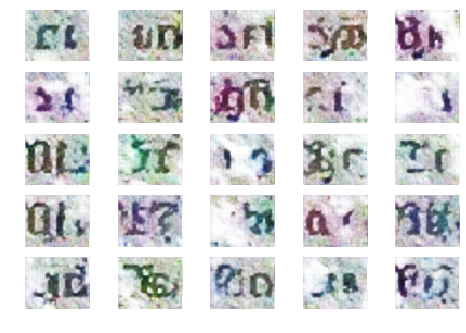

7151 [D loss: 1.000778] [G loss: 1.498145]
7152 [D loss: 1.000172] [G loss: 1.497482]
7153 [D loss: 1.001332] [G loss: 1.497078]
7154 [D loss: 1.001530] [G loss: 1.497892]
7155 [D loss: 1.000439] [G loss: 1.497442]
7156 [D loss: 1.000747] [G loss: 1.497037]
7157 [D loss: 1.001474] [G loss: 1.497385]
7158 [D loss: 1.000771] [G loss: 1.497736]
7159 [D loss: 1.001047] [G loss: 1.497714]
7160 [D loss: 1.000759] [G loss: 1.496663]
7161 [D loss: 1.000614] [G loss: 1.497491]
7162 [D loss: 1.000608] [G loss: 1.496846]
7163 [D loss: 1.001290] [G loss: 1.497413]
7164 [D loss: 1.000965] [G loss: 1.497959]
7165 [D loss: 1.000741] [G loss: 1.497568]
7166 [D loss: 1.000888] [G loss: 1.498446]
7167 [D loss: 1.001271] [G loss: 1.496917]
7168 [D loss: 1.000938] [G loss: 1.497556]
7169 [D loss: 1.000828] [G loss: 1.496949]
7170 [D loss: 1.000921] [G loss: 1.497643]
7171 [D loss: 1.001137] [G loss: 1.497984]
7172 [D loss: 0.999882] [G loss: 1.497662]
7173 [D loss: 1.000081] [G loss: 1.497640]
7174 [D los

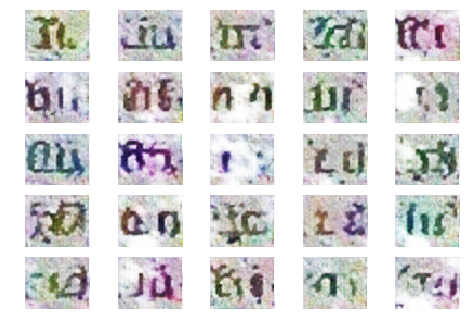

7201 [D loss: 1.000825] [G loss: 1.497848]
7202 [D loss: 1.001186] [G loss: 1.497588]
7203 [D loss: 1.000737] [G loss: 1.497245]
7204 [D loss: 1.000457] [G loss: 1.497821]
7205 [D loss: 1.000391] [G loss: 1.497291]
7206 [D loss: 1.001158] [G loss: 1.497865]
7207 [D loss: 1.000800] [G loss: 1.497180]
7208 [D loss: 1.000594] [G loss: 1.497633]
7209 [D loss: 1.000552] [G loss: 1.497699]
7210 [D loss: 1.000243] [G loss: 1.497939]
7211 [D loss: 1.000347] [G loss: 1.498243]
7212 [D loss: 1.000926] [G loss: 1.496768]
7213 [D loss: 1.000762] [G loss: 1.497724]
7214 [D loss: 1.000677] [G loss: 1.497559]
7215 [D loss: 1.000869] [G loss: 1.497332]
7216 [D loss: 1.000618] [G loss: 1.496512]
7217 [D loss: 0.999857] [G loss: 1.496593]
7218 [D loss: 1.000564] [G loss: 1.496302]
7219 [D loss: 1.000438] [G loss: 1.496639]
7220 [D loss: 1.000695] [G loss: 1.497567]
7221 [D loss: 1.001169] [G loss: 1.497745]
7222 [D loss: 1.000791] [G loss: 1.496814]
7223 [D loss: 1.000870] [G loss: 1.497826]
7224 [D los

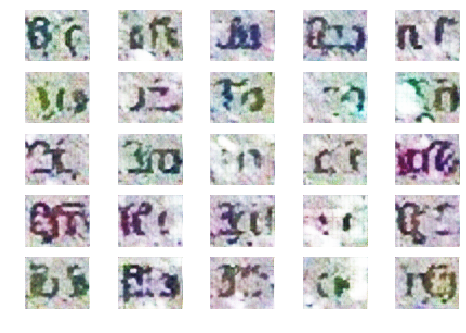

7251 [D loss: 1.001212] [G loss: 1.497709]
7252 [D loss: 1.000595] [G loss: 1.497362]
7253 [D loss: 1.000154] [G loss: 1.497496]
7254 [D loss: 1.000534] [G loss: 1.497514]
7255 [D loss: 1.001527] [G loss: 1.498733]
7256 [D loss: 0.999899] [G loss: 1.498106]
7257 [D loss: 1.000784] [G loss: 1.497922]
7258 [D loss: 1.000988] [G loss: 1.496981]
7259 [D loss: 1.000308] [G loss: 1.498188]
7260 [D loss: 1.001279] [G loss: 1.497354]
7261 [D loss: 1.000902] [G loss: 1.497569]
7262 [D loss: 1.000559] [G loss: 1.497871]
7263 [D loss: 1.001102] [G loss: 1.496923]
7264 [D loss: 1.000277] [G loss: 1.497730]
7265 [D loss: 1.001174] [G loss: 1.496749]
7266 [D loss: 1.000322] [G loss: 1.498693]
7267 [D loss: 1.001004] [G loss: 1.497940]
7268 [D loss: 1.000737] [G loss: 1.496487]
7269 [D loss: 1.000929] [G loss: 1.497037]
7270 [D loss: 1.000804] [G loss: 1.496723]
7271 [D loss: 1.000703] [G loss: 1.497487]
7272 [D loss: 1.000894] [G loss: 1.498653]
7273 [D loss: 1.000084] [G loss: 1.497120]
7274 [D los

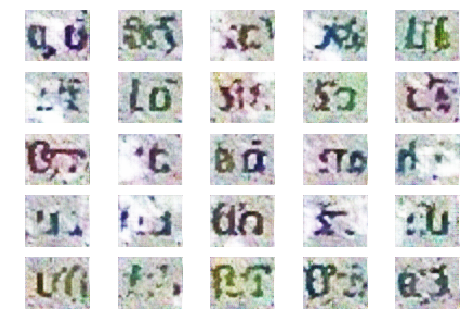

7301 [D loss: 1.001382] [G loss: 1.496708]
7302 [D loss: 1.000600] [G loss: 1.497925]
7303 [D loss: 1.000773] [G loss: 1.497836]
7304 [D loss: 1.000889] [G loss: 1.497694]
7305 [D loss: 1.000724] [G loss: 1.497290]
7306 [D loss: 1.001225] [G loss: 1.496967]
7307 [D loss: 1.001110] [G loss: 1.497685]
7308 [D loss: 1.001697] [G loss: 1.497673]
7309 [D loss: 1.000785] [G loss: 1.497940]
7310 [D loss: 1.001342] [G loss: 1.497948]
7311 [D loss: 1.001276] [G loss: 1.497454]
7312 [D loss: 1.000842] [G loss: 1.497786]
7313 [D loss: 1.000580] [G loss: 1.498414]
7314 [D loss: 1.000640] [G loss: 1.496958]
7315 [D loss: 1.000690] [G loss: 1.497356]
7316 [D loss: 1.000846] [G loss: 1.497451]
7317 [D loss: 1.000887] [G loss: 1.497737]
7318 [D loss: 1.001009] [G loss: 1.497382]
7319 [D loss: 1.001258] [G loss: 1.497044]
7320 [D loss: 1.000489] [G loss: 1.496879]
7321 [D loss: 1.001310] [G loss: 1.497057]
7322 [D loss: 1.000743] [G loss: 1.497066]
7323 [D loss: 1.000814] [G loss: 1.496987]
7324 [D los

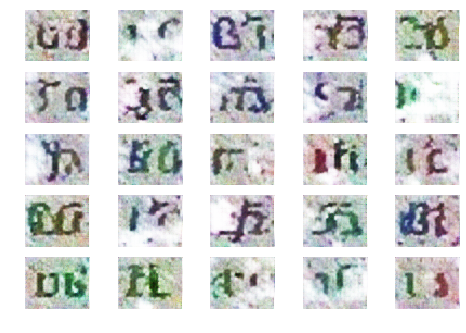

7351 [D loss: 1.000575] [G loss: 1.497517]
7352 [D loss: 1.000553] [G loss: 1.498152]
7353 [D loss: 1.000280] [G loss: 1.497458]
7354 [D loss: 1.000517] [G loss: 1.497804]
7355 [D loss: 1.000542] [G loss: 1.497421]
7356 [D loss: 1.000432] [G loss: 1.498543]
7357 [D loss: 1.000664] [G loss: 1.496717]
7358 [D loss: 1.001091] [G loss: 1.497680]
7359 [D loss: 1.000852] [G loss: 1.497226]
7360 [D loss: 1.000453] [G loss: 1.498174]
7361 [D loss: 1.000860] [G loss: 1.498064]
7362 [D loss: 1.000573] [G loss: 1.497674]
7363 [D loss: 1.001166] [G loss: 1.497919]
7364 [D loss: 1.000780] [G loss: 1.496729]
7365 [D loss: 1.000835] [G loss: 1.496023]
7366 [D loss: 1.001023] [G loss: 1.497274]
7367 [D loss: 1.000601] [G loss: 1.498116]
7368 [D loss: 1.000676] [G loss: 1.496518]
7369 [D loss: 1.000847] [G loss: 1.497146]
7370 [D loss: 1.000627] [G loss: 1.498773]
7371 [D loss: 1.000284] [G loss: 1.497757]
7372 [D loss: 1.000439] [G loss: 1.496562]
7373 [D loss: 1.000496] [G loss: 1.498335]
7374 [D los

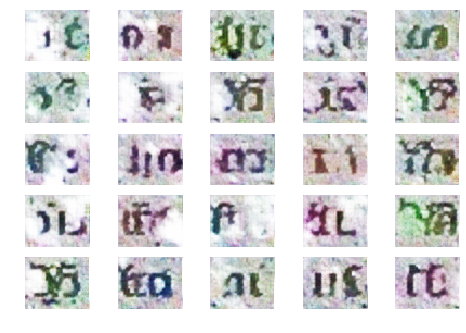

7401 [D loss: 1.000820] [G loss: 1.498622]
7402 [D loss: 1.000709] [G loss: 1.497326]
7403 [D loss: 1.001183] [G loss: 1.497585]
7404 [D loss: 1.000661] [G loss: 1.497443]
7405 [D loss: 1.000610] [G loss: 1.497529]
7406 [D loss: 1.000542] [G loss: 1.497873]
7407 [D loss: 1.000779] [G loss: 1.497619]
7408 [D loss: 1.000555] [G loss: 1.498615]
7409 [D loss: 1.000711] [G loss: 1.497000]
7410 [D loss: 1.000749] [G loss: 1.497247]
7411 [D loss: 1.000729] [G loss: 1.497806]
7412 [D loss: 1.000939] [G loss: 1.498212]
7413 [D loss: 1.001049] [G loss: 1.497894]
7414 [D loss: 1.001112] [G loss: 1.497313]
7415 [D loss: 1.000650] [G loss: 1.498404]
7416 [D loss: 1.000748] [G loss: 1.497344]
7417 [D loss: 1.000379] [G loss: 1.498344]
7418 [D loss: 1.000574] [G loss: 1.498570]
7419 [D loss: 1.000777] [G loss: 1.498500]
7420 [D loss: 1.001354] [G loss: 1.497407]
7421 [D loss: 1.000591] [G loss: 1.496192]
7422 [D loss: 1.000634] [G loss: 1.497878]
7423 [D loss: 1.001305] [G loss: 1.497520]
7424 [D los

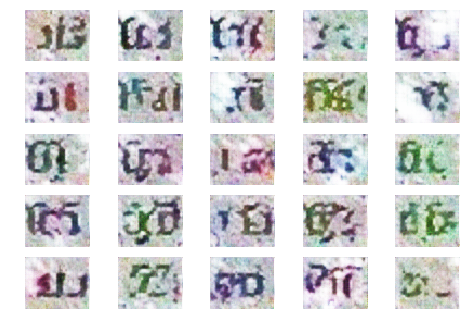

7451 [D loss: 1.000936] [G loss: 1.498206]
7452 [D loss: 1.000446] [G loss: 1.499052]
7453 [D loss: 1.000143] [G loss: 1.497476]
7454 [D loss: 1.000355] [G loss: 1.498145]
7455 [D loss: 1.000948] [G loss: 1.496827]
7456 [D loss: 1.000907] [G loss: 1.497201]
7457 [D loss: 1.000837] [G loss: 1.498357]
7458 [D loss: 1.000836] [G loss: 1.498182]
7459 [D loss: 1.000856] [G loss: 1.499008]
7460 [D loss: 1.000731] [G loss: 1.497875]
7461 [D loss: 1.001053] [G loss: 1.498330]
7462 [D loss: 1.000412] [G loss: 1.497811]
7463 [D loss: 1.001051] [G loss: 1.496718]
7464 [D loss: 1.000665] [G loss: 1.498562]
7465 [D loss: 1.000102] [G loss: 1.498010]
7466 [D loss: 1.000426] [G loss: 1.498708]
7467 [D loss: 1.000888] [G loss: 1.498479]
7468 [D loss: 1.000597] [G loss: 1.498060]
7469 [D loss: 1.000487] [G loss: 1.497366]
7470 [D loss: 1.000716] [G loss: 1.498227]
7471 [D loss: 1.000839] [G loss: 1.497988]
7472 [D loss: 1.001404] [G loss: 1.497646]
7473 [D loss: 1.000212] [G loss: 1.498224]
7474 [D los

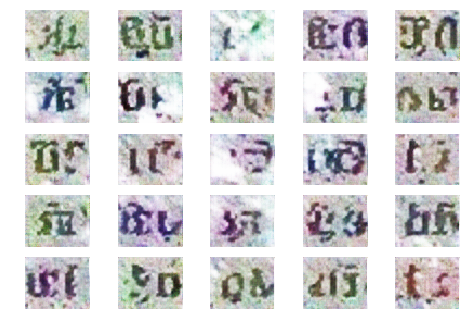

7501 [D loss: 1.000589] [G loss: 1.497245]
7502 [D loss: 1.001419] [G loss: 1.496862]
7503 [D loss: 1.001032] [G loss: 1.496747]
7504 [D loss: 1.000153] [G loss: 1.496984]
7505 [D loss: 1.000631] [G loss: 1.497060]
7506 [D loss: 1.001519] [G loss: 1.497010]
7507 [D loss: 1.001049] [G loss: 1.496393]
7508 [D loss: 1.000489] [G loss: 1.497053]
7509 [D loss: 1.001038] [G loss: 1.497268]
7510 [D loss: 1.000960] [G loss: 1.497831]
7511 [D loss: 1.000430] [G loss: 1.498197]
7512 [D loss: 1.001086] [G loss: 1.497449]
7513 [D loss: 1.000729] [G loss: 1.497776]
7514 [D loss: 1.000865] [G loss: 1.497738]
7515 [D loss: 0.999983] [G loss: 1.497346]
7516 [D loss: 1.000772] [G loss: 1.497426]
7517 [D loss: 1.000966] [G loss: 1.497687]
7518 [D loss: 1.000981] [G loss: 1.496942]
7519 [D loss: 1.000817] [G loss: 1.497367]
7520 [D loss: 1.000170] [G loss: 1.496884]
7521 [D loss: 1.000662] [G loss: 1.497021]
7522 [D loss: 1.001080] [G loss: 1.497533]
7523 [D loss: 1.000558] [G loss: 1.496907]
7524 [D los

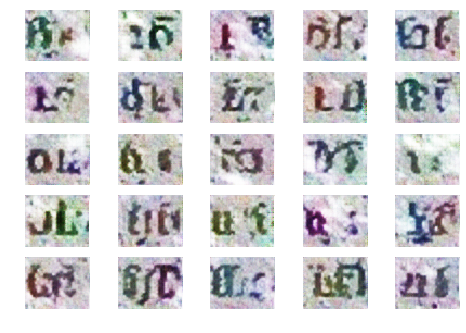

7551 [D loss: 1.000358] [G loss: 1.496789]
7552 [D loss: 1.000684] [G loss: 1.496783]
7553 [D loss: 1.000515] [G loss: 1.497301]
7554 [D loss: 1.000688] [G loss: 1.498577]
7555 [D loss: 1.000584] [G loss: 1.498291]
7556 [D loss: 1.001140] [G loss: 1.498541]
7557 [D loss: 1.001080] [G loss: 1.498458]
7558 [D loss: 1.000744] [G loss: 1.498224]
7559 [D loss: 1.000663] [G loss: 1.497478]
7560 [D loss: 1.001300] [G loss: 1.497024]
7561 [D loss: 1.000761] [G loss: 1.496862]
7562 [D loss: 1.001419] [G loss: 1.497511]
7563 [D loss: 1.000795] [G loss: 1.498284]
7564 [D loss: 1.000705] [G loss: 1.498134]
7565 [D loss: 1.000815] [G loss: 1.498422]
7566 [D loss: 1.000929] [G loss: 1.499118]
7567 [D loss: 1.000922] [G loss: 1.497401]
7568 [D loss: 1.001307] [G loss: 1.497063]
7569 [D loss: 1.001519] [G loss: 1.496820]
7570 [D loss: 1.001317] [G loss: 1.497592]
7571 [D loss: 1.001387] [G loss: 1.497990]
7572 [D loss: 1.000727] [G loss: 1.499324]
7573 [D loss: 1.001043] [G loss: 1.497958]
7574 [D los

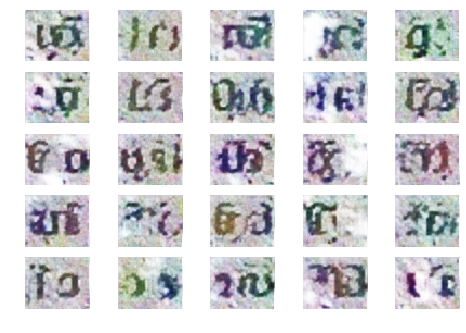

7601 [D loss: 1.001060] [G loss: 1.497441]
7602 [D loss: 1.001248] [G loss: 1.498247]
7603 [D loss: 1.000577] [G loss: 1.498151]
7604 [D loss: 1.000857] [G loss: 1.498133]
7605 [D loss: 1.000893] [G loss: 1.497009]
7606 [D loss: 1.001042] [G loss: 1.497960]
7607 [D loss: 1.000808] [G loss: 1.498100]
7608 [D loss: 1.000940] [G loss: 1.498068]
7609 [D loss: 1.000859] [G loss: 1.498295]
7610 [D loss: 1.001049] [G loss: 1.497074]
7611 [D loss: 1.000300] [G loss: 1.498180]
7612 [D loss: 1.000856] [G loss: 1.497848]
7613 [D loss: 1.000521] [G loss: 1.497724]
7614 [D loss: 1.001031] [G loss: 1.498473]
7615 [D loss: 0.999957] [G loss: 1.498271]
7616 [D loss: 1.000733] [G loss: 1.497644]
7617 [D loss: 1.001060] [G loss: 1.498706]
7618 [D loss: 1.000421] [G loss: 1.498555]
7619 [D loss: 1.000882] [G loss: 1.498049]
7620 [D loss: 1.000369] [G loss: 1.498225]
7621 [D loss: 1.000603] [G loss: 1.497720]
7622 [D loss: 1.000752] [G loss: 1.498259]
7623 [D loss: 1.000751] [G loss: 1.498578]
7624 [D los

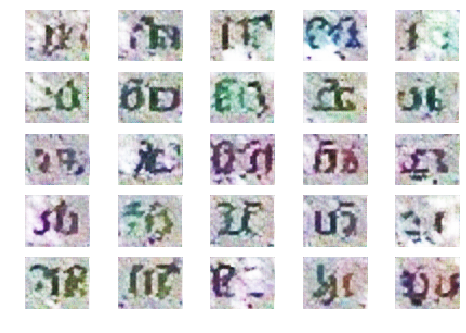

7651 [D loss: 1.000885] [G loss: 1.497844]
7652 [D loss: 1.000294] [G loss: 1.497985]
7653 [D loss: 1.000447] [G loss: 1.498038]
7654 [D loss: 1.000603] [G loss: 1.498385]
7655 [D loss: 1.000818] [G loss: 1.497837]
7656 [D loss: 1.001051] [G loss: 1.498283]
7657 [D loss: 1.000279] [G loss: 1.498205]
7658 [D loss: 1.000313] [G loss: 1.497078]
7659 [D loss: 1.000449] [G loss: 1.497310]
7660 [D loss: 1.000569] [G loss: 1.497748]
7661 [D loss: 1.000577] [G loss: 1.497403]
7662 [D loss: 1.000877] [G loss: 1.497837]
7663 [D loss: 1.000622] [G loss: 1.498505]
7664 [D loss: 1.000342] [G loss: 1.498820]
7665 [D loss: 1.001260] [G loss: 1.496053]
7666 [D loss: 1.000285] [G loss: 1.497401]
7667 [D loss: 1.000781] [G loss: 1.497058]
7668 [D loss: 1.001064] [G loss: 1.496819]
7669 [D loss: 1.000812] [G loss: 1.497695]
7670 [D loss: 1.001621] [G loss: 1.498332]
7671 [D loss: 1.000464] [G loss: 1.499029]
7672 [D loss: 1.000591] [G loss: 1.498957]
7673 [D loss: 1.001701] [G loss: 1.498782]
7674 [D los

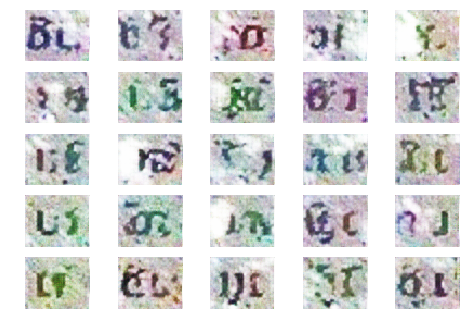

7701 [D loss: 1.001789] [G loss: 1.498091]
7702 [D loss: 1.000789] [G loss: 1.497765]
7703 [D loss: 1.000658] [G loss: 1.498488]
7704 [D loss: 1.000666] [G loss: 1.497783]
7705 [D loss: 1.001306] [G loss: 1.497525]
7706 [D loss: 1.001029] [G loss: 1.497004]
7707 [D loss: 1.001159] [G loss: 1.497905]
7708 [D loss: 1.001398] [G loss: 1.498880]
7709 [D loss: 1.000335] [G loss: 1.498061]
7710 [D loss: 1.000687] [G loss: 1.497658]
7711 [D loss: 1.000869] [G loss: 1.498825]
7712 [D loss: 1.001821] [G loss: 1.497575]
7713 [D loss: 1.000907] [G loss: 1.496885]
7714 [D loss: 1.000502] [G loss: 1.497726]
7715 [D loss: 1.000718] [G loss: 1.497549]
7716 [D loss: 1.000842] [G loss: 1.497281]
7717 [D loss: 1.000836] [G loss: 1.498171]
7718 [D loss: 1.000293] [G loss: 1.498326]
7719 [D loss: 1.000286] [G loss: 1.497832]
7720 [D loss: 1.000420] [G loss: 1.497818]
7721 [D loss: 1.000568] [G loss: 1.497713]
7722 [D loss: 1.000923] [G loss: 1.497885]
7723 [D loss: 1.000681] [G loss: 1.497762]
7724 [D los

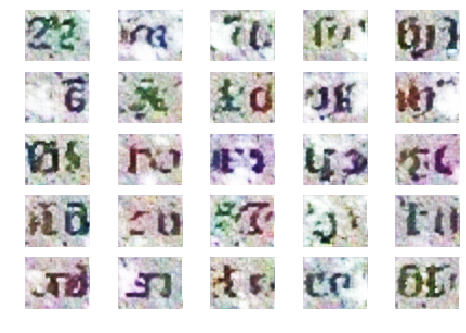

7751 [D loss: 1.000646] [G loss: 1.498239]
7752 [D loss: 1.001126] [G loss: 1.497373]
7753 [D loss: 1.000567] [G loss: 1.498183]
7754 [D loss: 1.001218] [G loss: 1.497375]
7755 [D loss: 1.000815] [G loss: 1.497658]
7756 [D loss: 1.000485] [G loss: 1.497686]
7757 [D loss: 1.001075] [G loss: 1.498203]
7758 [D loss: 1.000387] [G loss: 1.497783]
7759 [D loss: 1.000783] [G loss: 1.496946]
7760 [D loss: 1.000196] [G loss: 1.497831]
7761 [D loss: 1.000175] [G loss: 1.497574]
7762 [D loss: 1.001426] [G loss: 1.497626]
7763 [D loss: 1.001065] [G loss: 1.498786]
7764 [D loss: 1.000876] [G loss: 1.497902]
7765 [D loss: 1.000652] [G loss: 1.498068]
7766 [D loss: 1.001218] [G loss: 1.498055]
7767 [D loss: 0.999936] [G loss: 1.497341]
7768 [D loss: 1.000648] [G loss: 1.498161]
7769 [D loss: 1.000677] [G loss: 1.497672]
7770 [D loss: 1.000900] [G loss: 1.497859]
7771 [D loss: 1.000863] [G loss: 1.497612]
7772 [D loss: 1.000721] [G loss: 1.498160]
7773 [D loss: 1.000867] [G loss: 1.498103]
7774 [D los

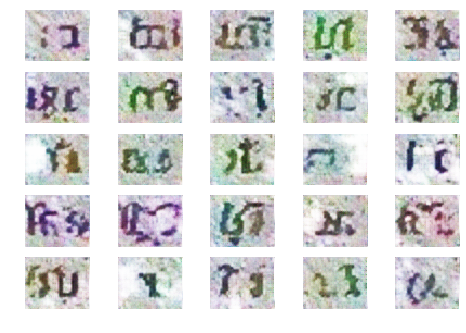

7801 [D loss: 1.000213] [G loss: 1.498715]
7802 [D loss: 1.000797] [G loss: 1.498662]
7803 [D loss: 1.000637] [G loss: 1.498274]
7804 [D loss: 1.000936] [G loss: 1.498495]
7805 [D loss: 1.000364] [G loss: 1.497328]
7806 [D loss: 0.999979] [G loss: 1.498219]
7807 [D loss: 1.000465] [G loss: 1.497787]
7808 [D loss: 1.000861] [G loss: 1.497186]
7809 [D loss: 1.001260] [G loss: 1.498090]
7810 [D loss: 1.000434] [G loss: 1.498258]
7811 [D loss: 1.000513] [G loss: 1.496756]
7812 [D loss: 1.001293] [G loss: 1.497129]
7813 [D loss: 0.999916] [G loss: 1.497855]
7814 [D loss: 1.000637] [G loss: 1.497862]
7815 [D loss: 1.000306] [G loss: 1.498003]
7816 [D loss: 1.001115] [G loss: 1.498325]
7817 [D loss: 1.000812] [G loss: 1.498300]
7818 [D loss: 1.000299] [G loss: 1.498478]
7819 [D loss: 1.000830] [G loss: 1.498938]
7820 [D loss: 1.000213] [G loss: 1.498784]
7821 [D loss: 1.001097] [G loss: 1.498587]
7822 [D loss: 1.000694] [G loss: 1.498399]
7823 [D loss: 1.001268] [G loss: 1.497768]
7824 [D los

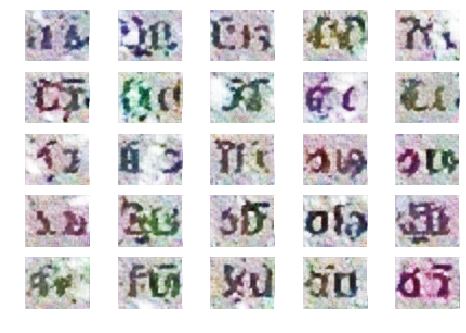

7851 [D loss: 1.000216] [G loss: 1.498311]
7852 [D loss: 1.000441] [G loss: 1.498128]
7853 [D loss: 1.000710] [G loss: 1.498200]
7854 [D loss: 1.000194] [G loss: 1.497740]
7855 [D loss: 1.000166] [G loss: 1.497802]
7856 [D loss: 1.001314] [G loss: 1.497654]
7857 [D loss: 1.000775] [G loss: 1.497005]
7858 [D loss: 1.000851] [G loss: 1.496521]
7859 [D loss: 1.001069] [G loss: 1.498121]
7860 [D loss: 1.000973] [G loss: 1.497823]
7861 [D loss: 1.000917] [G loss: 1.496711]
7862 [D loss: 1.000568] [G loss: 1.497012]
7863 [D loss: 1.000963] [G loss: 1.497695]
7864 [D loss: 1.000514] [G loss: 1.497921]
7865 [D loss: 1.001154] [G loss: 1.497566]
7866 [D loss: 1.000882] [G loss: 1.497759]
7867 [D loss: 1.000842] [G loss: 1.498344]
7868 [D loss: 1.000342] [G loss: 1.498297]
7869 [D loss: 1.000483] [G loss: 1.498282]
7870 [D loss: 1.000843] [G loss: 1.498718]
7871 [D loss: 1.000324] [G loss: 1.498158]
7872 [D loss: 1.000465] [G loss: 1.498545]
7873 [D loss: 1.001063] [G loss: 1.497247]
7874 [D los

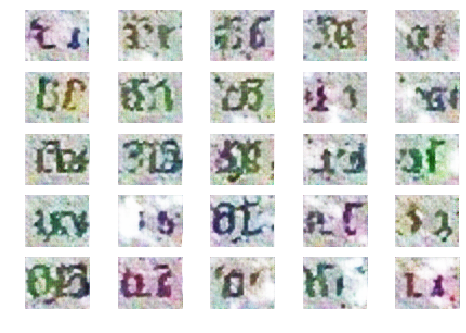

7901 [D loss: 1.000891] [G loss: 1.499104]
7902 [D loss: 1.000677] [G loss: 1.498097]
7903 [D loss: 1.001256] [G loss: 1.498891]
7904 [D loss: 1.001081] [G loss: 1.497588]
7905 [D loss: 1.000803] [G loss: 1.498301]
7906 [D loss: 1.001104] [G loss: 1.498236]
7907 [D loss: 1.000167] [G loss: 1.497803]
7908 [D loss: 1.000602] [G loss: 1.498095]
7909 [D loss: 1.000863] [G loss: 1.498088]
7910 [D loss: 1.001142] [G loss: 1.497765]
7911 [D loss: 1.001204] [G loss: 1.498917]
7912 [D loss: 1.001309] [G loss: 1.497999]
7913 [D loss: 0.999856] [G loss: 1.497883]
7914 [D loss: 1.000627] [G loss: 1.498021]
7915 [D loss: 1.001234] [G loss: 1.498320]
7916 [D loss: 1.000657] [G loss: 1.498699]
7917 [D loss: 1.000547] [G loss: 1.497964]
7918 [D loss: 1.000765] [G loss: 1.497497]
7919 [D loss: 1.000624] [G loss: 1.496994]
7920 [D loss: 1.000663] [G loss: 1.496722]
7921 [D loss: 1.000470] [G loss: 1.498138]
7922 [D loss: 1.000859] [G loss: 1.498174]
7923 [D loss: 1.001455] [G loss: 1.499508]
7924 [D los

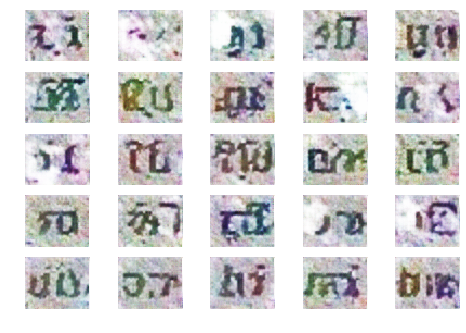

7951 [D loss: 1.000534] [G loss: 1.496697]
7952 [D loss: 1.000559] [G loss: 1.496853]
7953 [D loss: 1.000856] [G loss: 1.497752]
7954 [D loss: 1.000298] [G loss: 1.498229]
7955 [D loss: 1.000607] [G loss: 1.497575]
7956 [D loss: 1.001098] [G loss: 1.498135]
7957 [D loss: 1.000321] [G loss: 1.497937]
7958 [D loss: 1.001110] [G loss: 1.497155]
7959 [D loss: 1.000265] [G loss: 1.497964]
7960 [D loss: 1.000729] [G loss: 1.497875]
7961 [D loss: 1.000683] [G loss: 1.497592]
7962 [D loss: 1.000325] [G loss: 1.497755]
7963 [D loss: 1.000341] [G loss: 1.498368]
7964 [D loss: 1.001460] [G loss: 1.498561]
7965 [D loss: 1.000377] [G loss: 1.498260]
7966 [D loss: 1.000360] [G loss: 1.498414]
7967 [D loss: 1.001000] [G loss: 1.497812]
7968 [D loss: 1.000756] [G loss: 1.497945]
7969 [D loss: 1.000537] [G loss: 1.497971]
7970 [D loss: 1.000647] [G loss: 1.498170]
7971 [D loss: 1.000713] [G loss: 1.497859]
7972 [D loss: 1.001212] [G loss: 1.497125]
7973 [D loss: 1.000718] [G loss: 1.497097]
7974 [D los

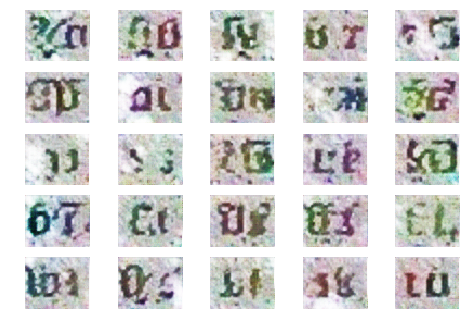

8001 [D loss: 1.001374] [G loss: 1.498058]
8002 [D loss: 1.000798] [G loss: 1.497761]
8003 [D loss: 1.000511] [G loss: 1.497611]
8004 [D loss: 1.001281] [G loss: 1.498768]
8005 [D loss: 1.000696] [G loss: 1.498457]
8006 [D loss: 1.000297] [G loss: 1.498885]
8007 [D loss: 1.000643] [G loss: 1.498688]
8008 [D loss: 1.000558] [G loss: 1.499079]
8009 [D loss: 1.000521] [G loss: 1.498257]
8010 [D loss: 1.000574] [G loss: 1.498662]
8011 [D loss: 1.000752] [G loss: 1.497798]
8012 [D loss: 0.999992] [G loss: 1.497917]
8013 [D loss: 1.001019] [G loss: 1.497593]
8014 [D loss: 1.001599] [G loss: 1.498326]
8015 [D loss: 1.000714] [G loss: 1.497820]
8016 [D loss: 1.001021] [G loss: 1.497583]
8017 [D loss: 1.000695] [G loss: 1.497677]
8018 [D loss: 1.000149] [G loss: 1.497399]
8019 [D loss: 1.001390] [G loss: 1.497801]
8020 [D loss: 1.000949] [G loss: 1.497563]
8021 [D loss: 1.000693] [G loss: 1.497685]
8022 [D loss: 1.000860] [G loss: 1.498291]
8023 [D loss: 1.000513] [G loss: 1.497800]
8024 [D los

In [7]:
if __name__ == '__main__':
    wgan = WGAN()
    wgan.train(epochs=20000, batch_size=32, sample_interval=50, data_set = data_set1)